In [1]:
import os
import numpy as np
import requests
import math
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
import sys
import timeit

import pyQEDA as pq
import sys
sys.path.append("/Users/chenjie/pyQEDA/pyscripts")
import pyQEDA_function_cj as pf
import pyQEDA_potential as pqp
import normalization_function as nf

import tensorflow as tf
from tensorflow.keras import layers, Model, backend
from tensorflow.keras import applications
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D, Reshape

-------------------------------------------------------------------------------------------------------------------

# I. Load the initial training set

1. load raw data:

(-0.14292649544519181-0.019966400854506156j)  real: -0.14292649544519181  imag: -0.019966400854506156
5


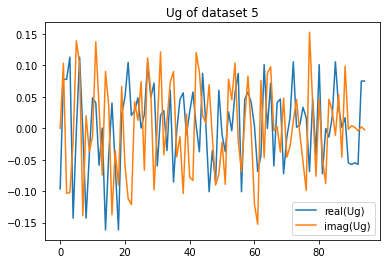

In [2]:
# load the structure vector Ug:
name =  "normalized_ZnO_r8_test_shift_200"
File = "r8_test_shift"
Nx = 70

Ug = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/My_labels_" + name + ".csv", dtype=complex) 

dataset = 5
print(Ug[dataset,4],' real:',np.real(Ug[dataset,4]),' imag:',np.imag(Ug[dataset,4]))
re = np.real(Ug[dataset,:])
im = np.imag(Ug[dataset,:])

plt.plot(re,label='real(Ug)')
plt.plot(im,label='imag(Ug)')
plt.legend()
plt.title('Ug of dataset '+str(dataset))
np.imag(Ug[dataset,:])-np.imag(Ug[dataset+1,:])
print(dataset)

thickness of dataset 5: 542.0


Text(0.5, 1.0, 'thickness')

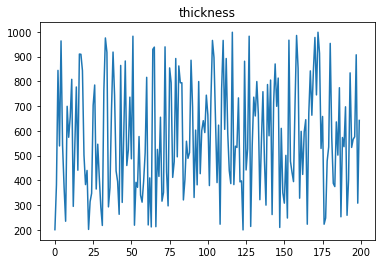

In [3]:
# load the thickness t:
t = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/My_thickness_" + name + ".csv", dtype=float) 
print('thickness of dataset '+str(dataset)+':', t[dataset])
plt.plot(t)
plt.title('thickness')

shape of the diffraction pattern:  (4900,)
X.max()=  0.9828859136362673


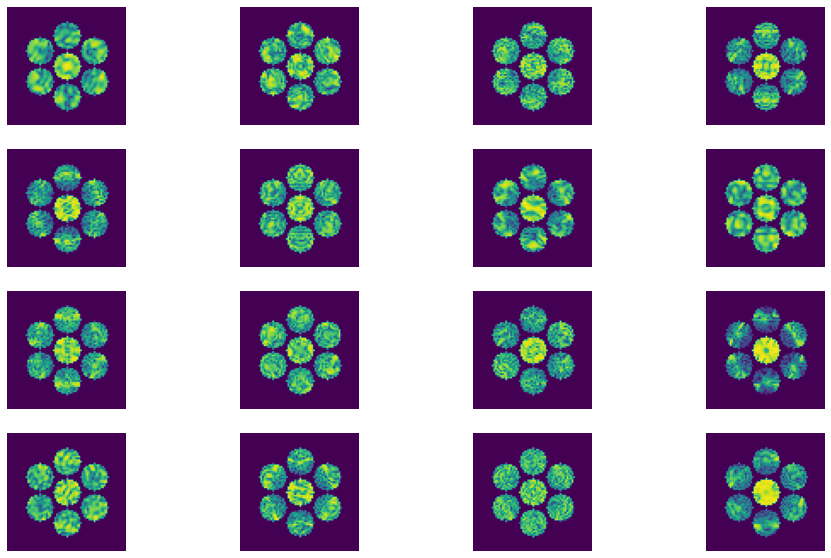

In [4]:
# load the raw data of diffraction Pattern X:
X = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/random_diffs_" + name + ".csv", dtype=float) 
print('shape of the diffraction pattern: ', X[dataset].shape)

# reshape the Pixels Array(for that they were saved as flatten array):
X = X.reshape(len(X),Nx,Nx,1)

def nlogf(x):
    return np.log(1+1000*x)
nlog = np.vectorize(nlogf)

nlogf_X = nlogf(X)

# plot first few Diffraction Pattern:
Ncol = 4
Nrow = 4
fig,ax=plt.subplots(Nrow,Ncol,figsize=(16,10))
for j in range(Ncol*Nrow):
    plt.subplot(Nrow,Ncol,j+1)
    plt.imshow(nlogf_X[j])
    plt.axis('off')
    
print("X.max()= ", X.max())

2. Data processing:

shape of Ug_2real: (200, 95, 2)


Text(0.5, 1.0, 'first 2 sets of imag.parts of the Ug')

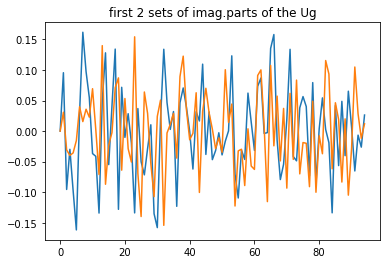

In [5]:
# Ug processing:
Ug_2real =[]
for i in range(0,len(Ug)):
    Ug_2real.append(np.concatenate((np.array(Ug[i].real,ndmin=2).T, np.array(Ug[i].imag,ndmin=2).T),axis=1))    
Ug_2real = np.asarray(Ug_2real)

numUg = Ug_2real.shape[1]
print('shape of Ug_2real:', Ug_2real.shape)

# Plot the first 2 sets of imaginary parts of the structure factors:
plt.plot(Ug_2real[0,:,1])
plt.plot(Ug_2real[1,:,1])
plt.title('first 2 sets of imag.parts of the Ug')

shape of Ug_2real: (200, 190)


Text(0.5, 1.0, 'Ug of dataset 5')

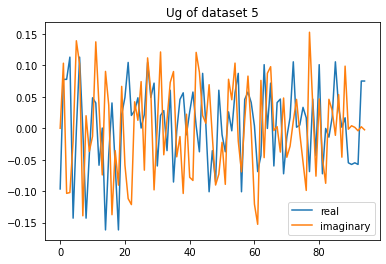

In [6]:
# combine real and imaginary numbers into one row:
# This interlaces real and imaginary numbers. 
Ug_2real = Ug_2real.reshape(-1,2*numUg)
print('shape of Ug_2real:',Ug_2real.shape)

plt.plot(Ug_2real[dataset,0:2*numUg:2],label='real')
plt.plot(Ug_2real[dataset,1:2*numUg:2],label='imaginary')
plt.legend()
plt.title('Ug of dataset '+str(dataset))

In [7]:
# normalize the thickness
t = t.astype('float32')
t = t/1000
t = t.reshape(len(t),1)

print('thickness of dataset' +str(dataset) + ':', t[dataset])

thickness of dataset5: [0.542]


In [8]:
# join Ug and t into Output(Y):
Y = np.append(Ug_2real,t,axis=1)
print('Dataset size: \n Input X:',X.shape,'Output Y:',Y.shape)

Dataset size: 
 Input X: (200, 70, 70, 1) Output Y: (200, 191)


3. define the size of training set and testing set:

In [9]:
trainsize = 100
testsize = 40
#X_train = nlogf_X[:trainsize,]
#X_test = nlogf_X[trainsize:trainsize+testsize,]
X_train = X[:trainsize,]
X_test = X[trainsize:trainsize+testsize,]
Y_train = Y[:trainsize,]
Y_test = Y[trainsize:trainsize+testsize,]

4. load the experimental Data:

the shape of the experimental pattern:  (1, 70, 70, 1)
0.9742559258987338


Text(0.5, 1.0, 'experimental Pattern')

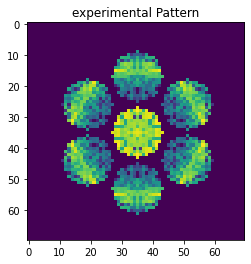

In [10]:
X_exp = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/diff_pattern_" + name + ".csv", dtype=float) 
X_exp = X_exp.reshape(1,Nx,Nx,1)
print('the shape of the experimental pattern: ',X_exp.shape)
print(X_exp.max())

nlogf_X_exp = nlogf(X_exp)
plt.imshow(nlogf_X_exp[0])
plt.title('experimental Pattern')

In [11]:
X_train.max(), nlogf_X_exp.max(), Y_train.max(), X.max(), X_exp.max()

(0.9828859136362673,
 6.882699924655138,
 0.9819999933242798,
 0.9828859136362673,
 0.9742559258987338)

---------------------------------------------------------------------------------------------------------------

# II. Build the neural network

In [12]:
backend.clear_session()

num_of_features = 2*numUg+1

# invert the Input to the form which can be used in the ResNet50 Model
target_size = X_train.shape[1:3]
input_size = (*target_size, 3)

# insert ResNet50 Model
base_model = applications.ResNet50(include_top=False, weights='imagenet', input_shape=input_size)  

# combine the ResNet50 model with my model
x = Flatten()(base_model.output)
x = Dense(num_of_features*16, activation='tanh')(x)
x = Dense(num_of_features*4, activation='tanh')(x)
x = Dense(num_of_features, activation='tanh')(x)
x = Dense(num_of_features, activation='tanh')(x)
model = Model(inputs=base_model.input, outputs=x)

# remove the output layer and replaced it with the regression output layer we want in ResNet50
# keep the weights of the first 49 layers of the ResNet50 model unchanged during the training process 
for layer in base_model.layers[:-1]:
    layer.trainable = False

model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 70, 70, 3)]  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 76, 76, 3)    0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 35, 35, 64)   9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 35, 35, 64)   256         conv1_conv[0][0]                 
______________________________________________________________________________________________

In [13]:
opt = tf.keras.optimizers.Adam(lr=0.001) 
model.compile(loss='mse', optimizer=opt, metrics='acc')

#save the model
model.save(name+'.h5')

train the NN without iteration to have a check:

Epoch 1/10
5/5 [==============================] - 4s 496ms/step - loss: 0.2723 - acc: 0.0000e+00 - val_loss: 0.1485 - val_acc: 0.0000e+00
Epoch 2/10
5/5 [==============================] - 1s 259ms/step - loss: 0.0934 - acc: 0.4000 - val_loss: 0.0405 - val_acc: 1.0000
Epoch 3/10
5/5 [==============================] - 1s 260ms/step - loss: 0.0364 - acc: 1.0000 - val_loss: 0.0331 - val_acc: 0.0000e+00
Epoch 4/10
5/5 [==============================] - 1s 259ms/step - loss: 0.0286 - acc: 0.0000e+00 - val_loss: 0.0184 - val_acc: 0.0000e+00
Epoch 5/10
5/5 [==============================] - 1s 259ms/step - loss: 0.0152 - acc: 0.8000 - val_loss: 0.0134 - val_acc: 1.0000
Epoch 6/10
5/5 [==============================] - 1s 251ms/step - loss: 0.0128 - acc: 1.0000 - val_loss: 0.0109 - val_acc: 1.0000
Epoch 7/10
5/5 [==============================] - 1s 260ms/step - loss: 0.0095 - acc: 1.0000 - val_loss: 0.0081 - val_acc: 1.0000
Epoch 8/10
5/5 [==============================] - 1s 263ms/step - loss

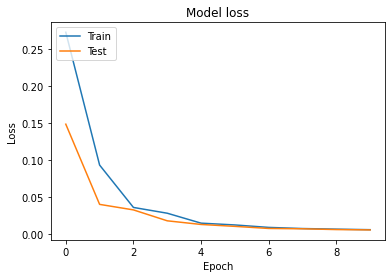

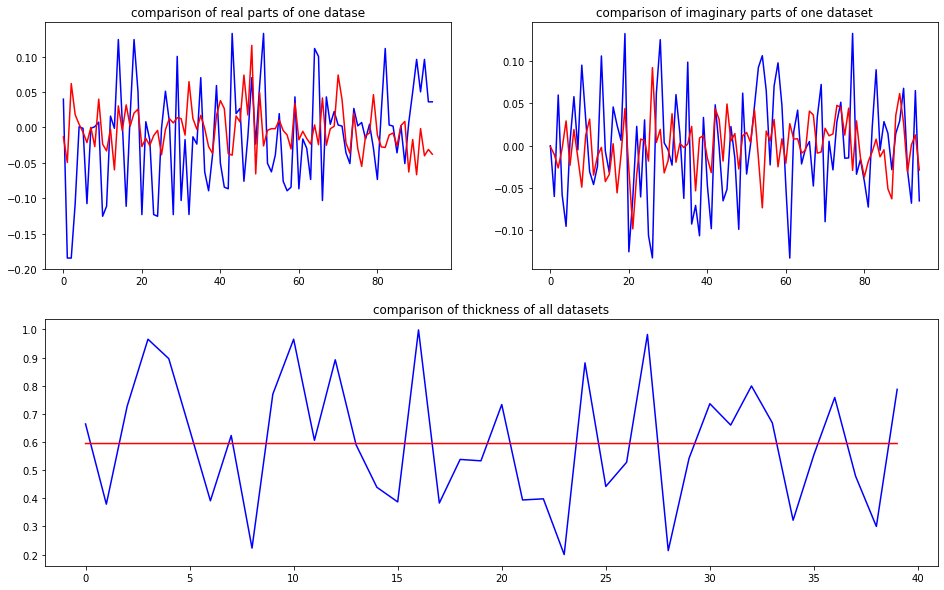

predicted thickness: 0.5945524


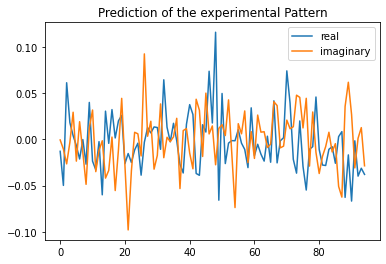

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=594.5523977279663
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01292089+0.00000000e+00j  0.00571232+7.98179628e-03j
  0.00571232-7.98179628e-03j -0.00155583-1.11423691e-02j
 -0.01142756+3.89505355e-02j -0.00349148-4.63636499e-03j
 -0.00155583+1.1

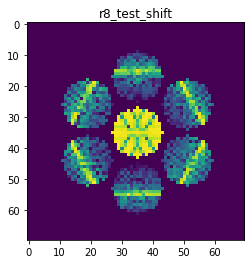

X_sim1.max():  0.987852198984325
nlogf_X_sim1.max():  6.896544875545027
Time:  18.765464193


In [14]:
start = timeit.default_timer()

# load and compile the model
model = load_model(name + ".h5")


# invert the 1 channel image Array to 3 Channel, to use ResNet50
X_train_3C = np.concatenate((X_train,X_train,X_train),axis=3) #same value for every channel
X_test_3C = np.concatenate((X_test,X_test,X_test),axis=3)

# train the model
#model.fit(X_train, Y_train, validation_data=(X_test, Y_test), batch_size=20, epochs=20)
model.fit(X_train_3C, Y_train, validation_data=(X_test_3C, Y_test), batch_size=20, epochs=10)

# plot the model loss
plt.plot(model.history.history['loss'])
plt.plot(model.history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
#plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Model_Loss' + '/' + 'Model_Loss{0:d}.png'.format(i))
plt.show()
plt.close()
    

# Prediction of the testing set
Y_test_pred = model.predict(X_test_3C)    
Ug_test_pred_complex = Y_test_pred[:,:2*numUg].reshape(-1,numUg,2)
Ug_test_complex = Y_test[:,:2*numUg].reshape(-1,numUg,2)    
t_test_pred = Y_test_pred[:,2*numUg]
t_test = Y_test[:,2*numUg]
    
# plot the comparison of imaginary parts, real parts and thickness
gs = gridspec.GridSpec(2, 2)
fig = plt.figure(figsize=(16,10))
    
ax1 = fig.add_subplot(gs[0, 0]) 
ax1.plot(Ug_test_complex[2,:,0],'b')
ax1.plot(Ug_test_pred_complex[2,:,0],'r')
ax1.set_title('comparison of real parts of one datase')
    
ax2 = fig.add_subplot(gs[0, 1]) 
ax2.plot(Ug_test_complex[2,:,1],'b')
ax2.plot(Ug_test_pred_complex[2,:,1],'r')
ax2.set_title('comparison of imaginary parts of one dataset')
    
ax3 = fig.add_subplot(gs[1, :])
ax3.plot(t_test[:],'b')
ax3.plot(t_test_pred[:],'r')
ax3.set_title('comparison of thickness of all datasets')
#plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Comparison' + '/' + 'My_Comparison{0:d}.png'.format(i))
plt.show()
plt.close()
    
    
# Prediction of the experimental Pattern
X_exp_3C = np.concatenate((nlogf_X_exp,nlogf_X_exp,nlogf_X_exp),axis=3) #X_exp.shape=(1,70,70,1); X_exp_3C.shape=(1,70,70,3)
Y_exp_pred = model.predict(X_exp_3C) #Y_exp_pred = (1,191)
    
Ug_t_exp_pred = Y_exp_pred[0,:] #Ug_t_exp_pred.shape=(191,)
Ug_exp_pred = Ug_t_exp_pred[0:2*numUg] #Ug_exp_pred.shape=(190,)
t_exp_pred = Ug_t_exp_pred[2*numUg]
if t_exp_pred < 0 or t_exp_pred > 1:
    t_exp_pred = np.random.randint(200,1001)/1000
    print("wrong thickness, use random thickness", t_exp_pred)
else:
    print("predicted thickness:", t_exp_pred)
    

# plot the results
plt.plot(Ug_exp_pred[0:2*numUg:2],label='real')
plt.plot(Ug_exp_pred[1:2*numUg:2],label='imaginary')
plt.legend()
plt.title('Prediction of the experimental Pattern')
#plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Prediction' + '/' + 'Ug{0:d}.png'.format(i))
plt.show()
plt.close()
    
# normalization
Ug_pred = np.array(range( np.int((Ug_t_exp_pred.size - 1)/2) ), dtype=complex)
Ug_pred.real = Ug_t_exp_pred[0:-1:2]
Ug_pred.imag = Ug_t_exp_pred[1:-1:2]

Ug_pred_normalized = nf.normalization(file=File, origin_Ug=Ug_pred)
Ug_pred_normalized = np.asarray(Ug_pred_normalized)


# reshape
Ug_pred_normalized_2real = np.concatenate((np.array(Ug_pred_normalized.real,ndmin=2).T, np.array(Ug_pred_normalized.imag,ndmin=2).T),axis=1)  
Ug_pred_normalized_2real = np.asarray(Ug_pred_normalized_2real)
Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(numUg*2), Ug_t_exp_pred[-1])

# Compute the LARBED pattern: X_sim, from the predicted {Ug,t}: Y_exp_pred
file = File+".qed"
X_sim = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_pred_normalized_2real, InputUgdoFlip=False)
X_sim = X_sim.reshape(Nx,Nx,1)
nlogf_X_sim = nlogf(X_sim)
print("X_sim1.max(): ", X_sim.max())
print("nlogf_X_sim1.max(): ", nlogf_X_sim.max())


    
stop = timeit.default_timer()
print('Time: ', stop - start)

In [15]:
print('the ture thickness: 500')
print('the predicted thickness:',Ug_t_exp_pred[-1]*1000)

the ture thickness: 500
the predicted thickness: 594.5523977279663


In [16]:
simulation_pattern = np.asarray(X_sim)
print('the shape of the simulated pattern', X_sim.shape)
print('the shape of the experimental pattern', X_exp.shape)

the shape of the simulated pattern (70, 70, 1)
the shape of the experimental pattern (1, 70, 70, 1)


Text(0.5, 1.0, 'experimental Pattern')

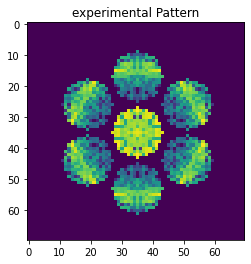

In [17]:
# plot the experimental Pattern:
plt.imshow(nlogf_X_exp[0])
plt.title('experimental Pattern')

Text(0.5, 1.0, 'simulation pattern')

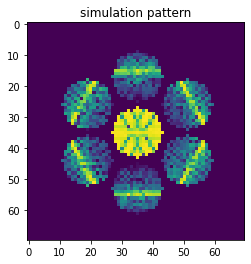

In [18]:
# plot the final simulated Pattern:
plt.imshow(nlogf_X_sim)
plt.title("simulation pattern")

R-factor:  0.6225476186605662


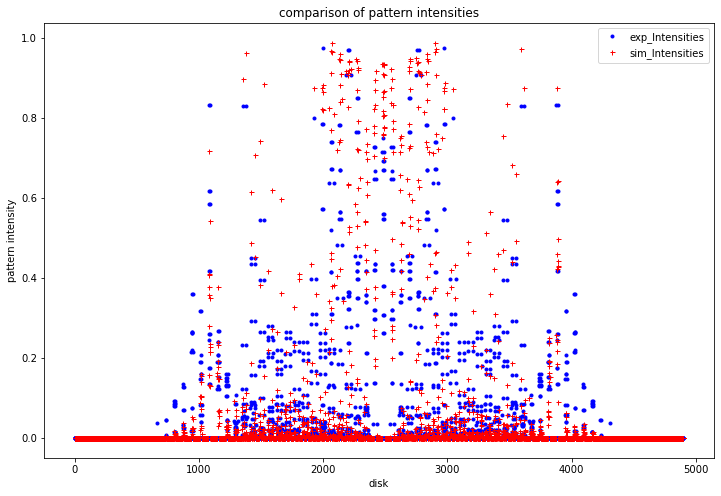

In [19]:
exp_Intensities = X_exp[0].reshape(Nx*Nx)
sim_Intensities = X_sim.reshape(Nx*Nx)
R = np.sum(np.abs(sim_Intensities - exp_Intensities))/np.sum(exp_Intensities)
print("R-factor: ", R)    
plt.figure(figsize=(12,8))
plt.plot(exp_Intensities, "bo", markersize=3, label="exp_Intensities")
plt.plot(sim_Intensities, "r+", markersize=5, label="sim_Intensities")
plt.legend()
plt.xlabel("disk")
plt.ylabel("pattern intensity")
plt.title("comparison of pattern intensities")
plt.show()

In [20]:
sim_Intensities.max()

0.987852198984325

-------------------------------------------------------------------------------------------------------------------

# III. Replace the initial training set with new training set

>>>train the initial training set:
Epoch 1/10
5/5 [==============================] - 4s 427ms/step - loss: 0.2640 - acc: 0.0000e+00 - val_loss: 0.1497 - val_acc: 0.0000e+00
Epoch 2/10
5/5 [==============================] - 1s 269ms/step - loss: 0.1027 - acc: 0.0000e+00 - val_loss: 0.0540 - val_acc: 0.0000e+00
Epoch 3/10
5/5 [==============================] - 1s 281ms/step - loss: 0.0421 - acc: 0.0000e+00 - val_loss: 0.0283 - val_acc: 0.0000e+00
Epoch 4/10
5/5 [==============================] - 1s 274ms/step - loss: 0.0252 - acc: 0.8000 - val_loss: 0.0203 - val_acc: 1.0000
Epoch 5/10
5/5 [==============================] - 1s 281ms/step - loss: 0.0169 - acc: 1.0000 - val_loss: 0.0135 - val_acc: 1.0000
Epoch 6/10
5/5 [==============================] - 1s 286ms/step - loss: 0.0121 - acc: 1.0000 - val_loss: 0.0106 - val_acc: 1.0000
Epoch 7/10
5/5 [==============================] - 1s 276ms/step - loss: 0.0097 - acc: 1.0000 - val_loss: 0.0081 - val_acc: 1.0000
Epoch 8/10
5/5 [===============

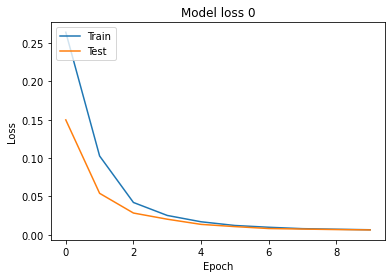

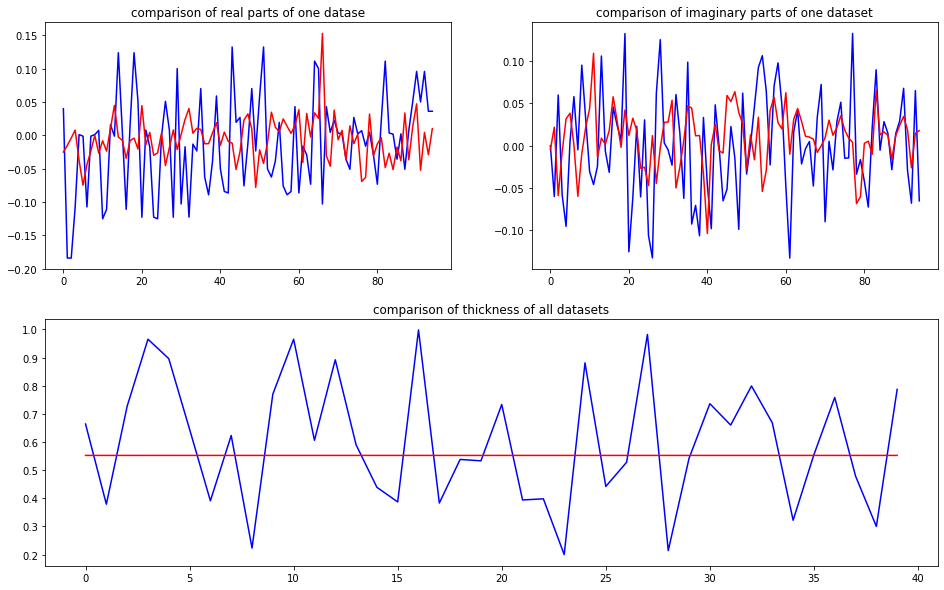

predicted thickness: 0.552057


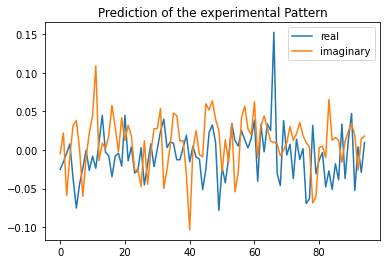

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=552.0570278167725
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.02508765+0.j         -0.00977657+0.04051684j -0.00977657-0.04051684j
 -0.01808805-0.00423532j -0.01886498+0.0206944j  -0.04953642+0.04914912j
 -0.01808805+0.00423532j -0.04953642-0.04

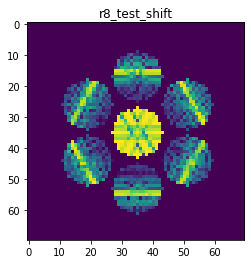

X_sim.max(): 0.9809207698900807
nlogf_X_sim.max(): 6.8895106227064735
>>>replaced the 1. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 428ms/step - loss: 0.0061 - acc: 1.0000 - val_loss: 0.0059 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0058 - acc: 1.0000 - val_loss: 0.0057 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 277ms/step - loss: 0.0058 - acc: 1.0000 - val_loss: 0.0057 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 274ms/step - loss: 0.0057 - acc: 1.0000 - val_loss: 0.0057 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 262ms/step - loss: 0.0057 - acc: 1.0000 - val_loss: 0.0056 - val_acc: 1.0000


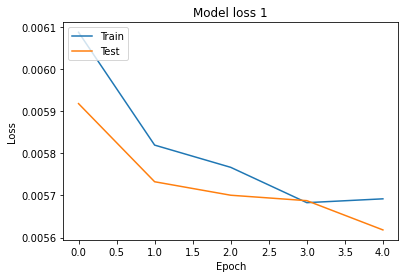

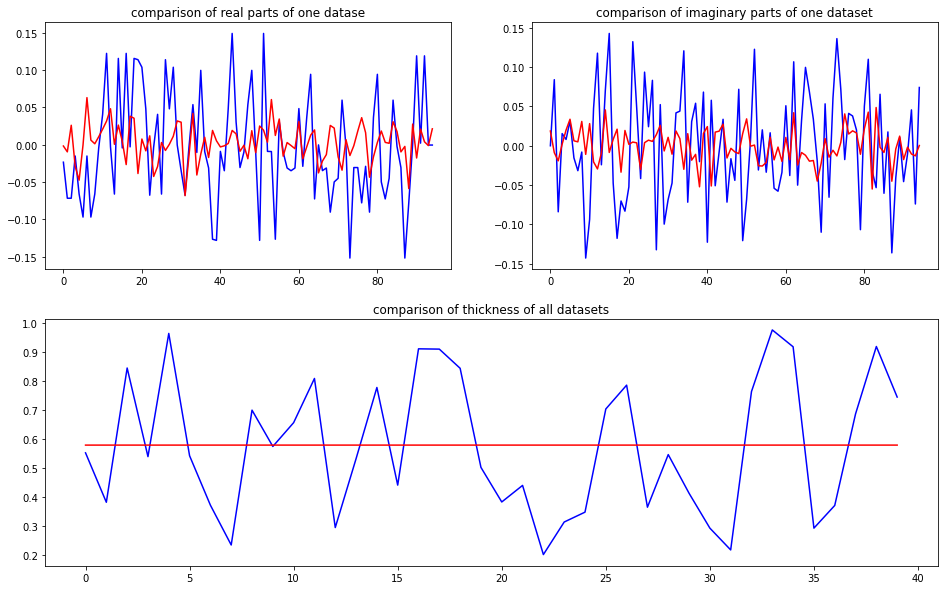

predicted thickness: 0.57856834


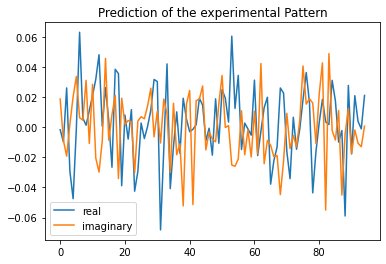

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=578.5683393478394
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.0017322 +0.j          0.0081109 +0.00524918j  0.0081109 -0.00524918j
  0.01691506-0.00214624j -0.02311112-0.00544395j  0.00258764+0.01451233j
  0.01691506+0.00214624j  0.00258764-0.01

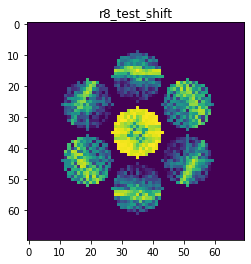

X_sim.max(): 0.9631921287808078
nlogf_X_sim.max(): 6.87129057846673
>>>replaced the 2. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 432ms/step - loss: 0.0056 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 267ms/step - loss: 0.0056 - acc: 1.0000 - val_loss: 0.0056 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0057 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 1.0000


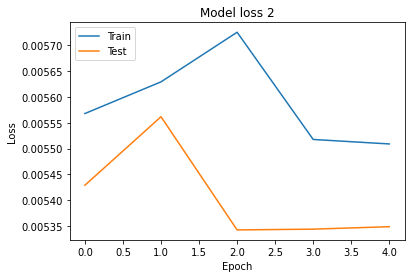

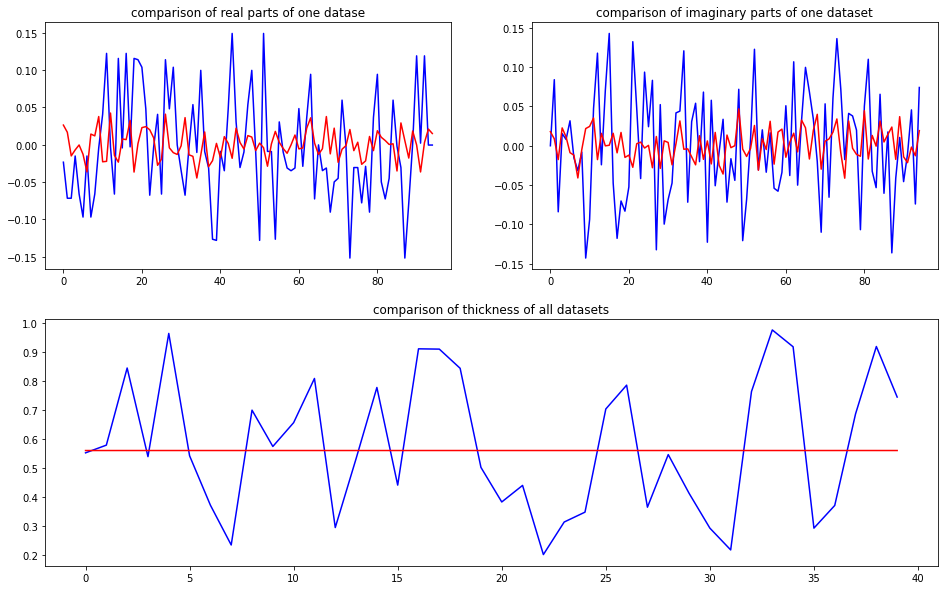

predicted thickness: 0.55994195


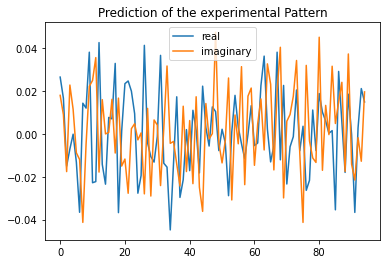

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=559.9419474601746
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02632024+0.00000000e+00j  0.00070742+1.32510569e-02j
  0.00070742-1.32510569e-02j -0.02184268+1.73138268e-02j
  0.0058262 +8.10839050e-03j  0.00046935+1.61860860e-02j
 -0.02184268-1.7

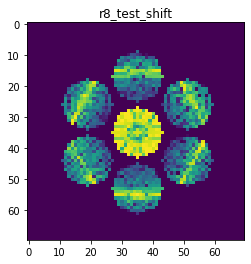

X_sim.max(): 0.9326571004046967
nlogf_X_sim.max(): 6.839109240632365
>>>replaced the 3. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 473ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0056 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0056 - acc: 1.0000 - val_loss: 0.0055 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 263ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0055 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 263ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 1.0000


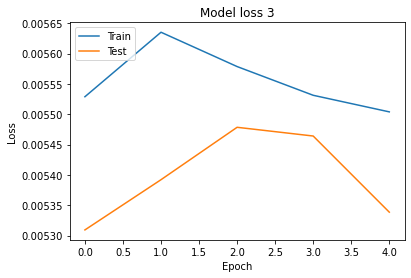

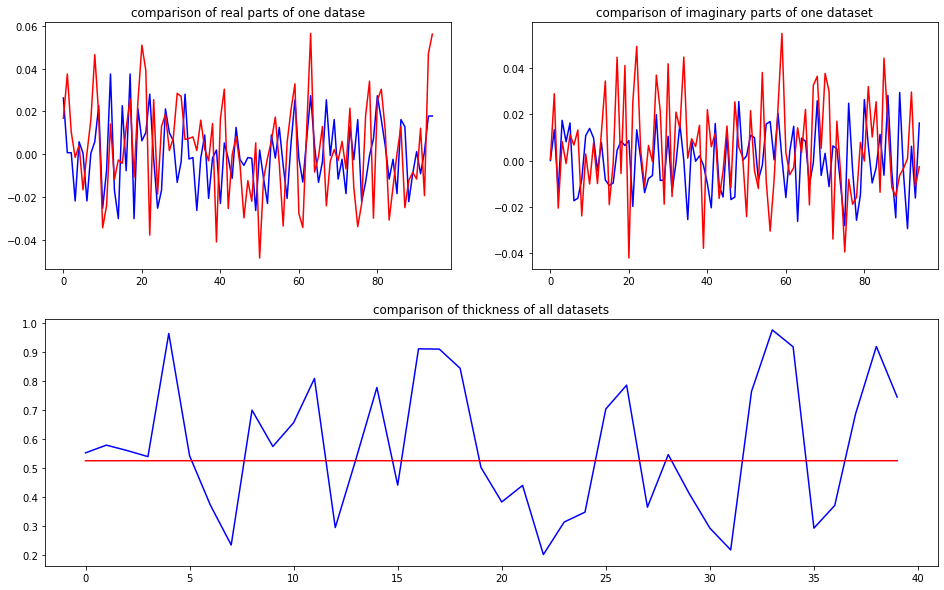

predicted thickness: 0.5248466


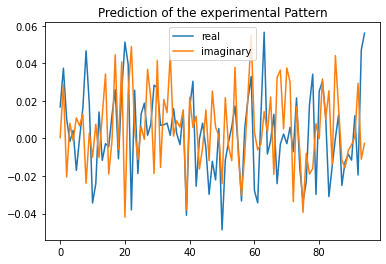

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=524.846613407135
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01681915+0.j          0.02388303+0.02466774j  0.02388303-0.02466774j
 -0.00064188+0.00069694j  0.0254697 +0.01129126j -0.00044473-0.00098585j
 -0.00064188-0.00069694j -0.00044473+0.000

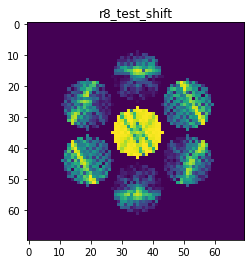

X_sim.max(): 0.9781207180722052
nlogf_X_sim.max(): 6.886654942459105
>>>replaced the 4. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 450ms/step - loss: 0.0056 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 259ms/step - loss: 0.0056 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0056 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 266ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0055 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 259ms/step - loss: 0.0057 - acc: 1.0000 - val_loss: 0.0056 - val_acc: 1.0000


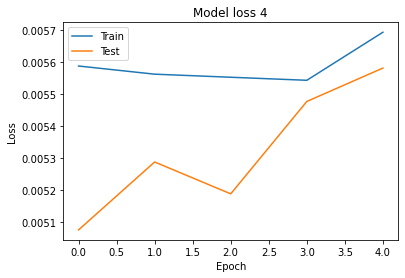

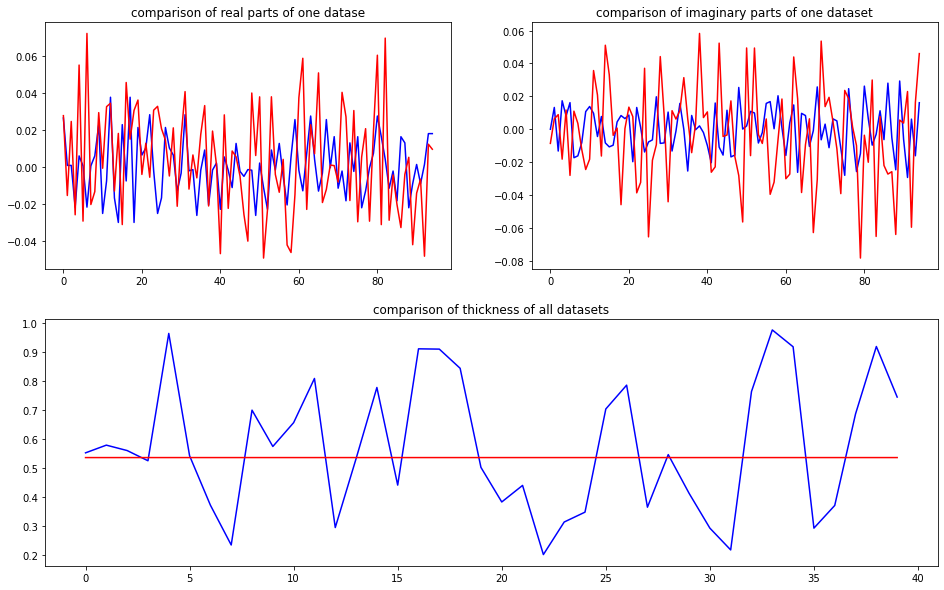

predicted thickness: 0.5356802


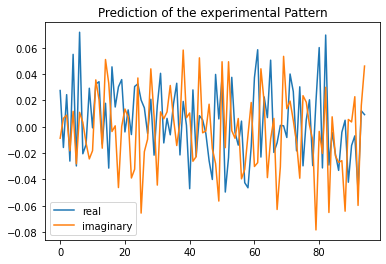

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=535.6801748275757
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 2.75724903e-02+0.j          4.37168870e-03-0.00121878j
  4.37168870e-03+0.00121878j  2.29072375e-02-0.01463616j
  2.08255043e-02+0.0120632j  -2.50995522e-02-0.01575153j
  2.29072375e-02

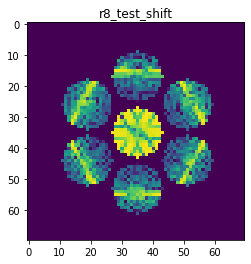

X_sim.max(): 0.9658643631407183
nlogf_X_sim.max(): 6.874058219990248
>>>replaced the 5. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 446ms/step - loss: 0.0057 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0057 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 280ms/step - loss: 0.0056 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 263ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 269ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000


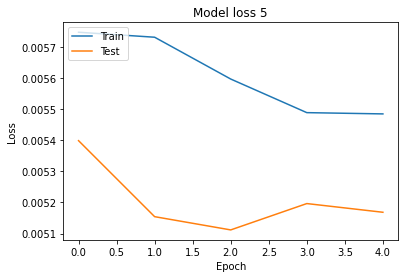

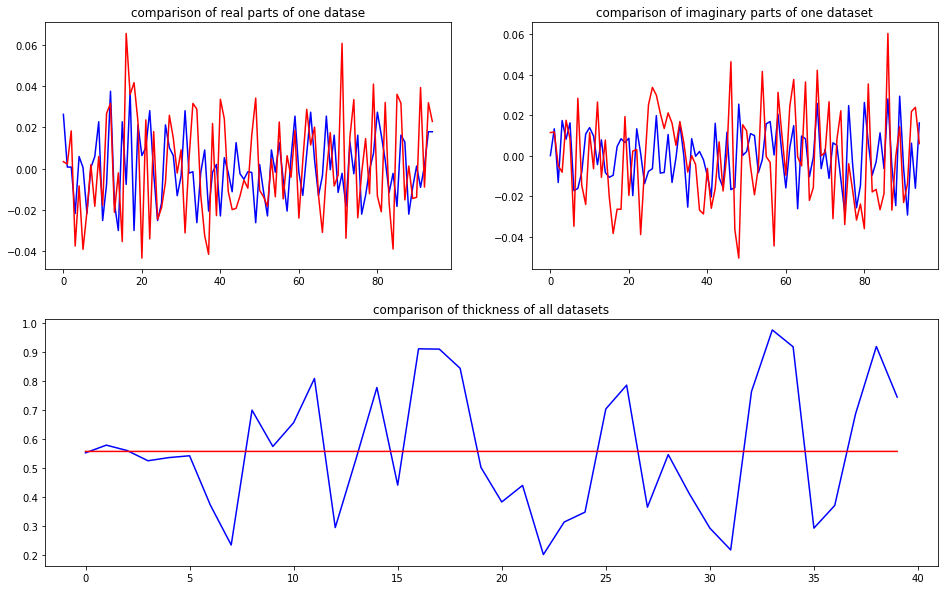

predicted thickness: 0.5568954


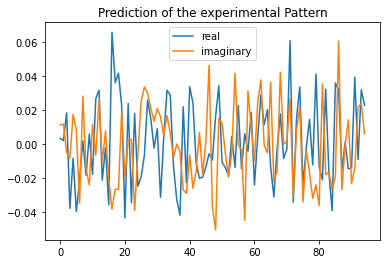

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=556.89537525177
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 3.32545280e-03+0.j          1.01695269e-02+0.00830957j
  1.01695269e-02-0.00830957j -2.94080833e-02+0.01330539j
 -1.32934065e-02+0.01607365j -1.88733578e-02-0.00997098j
 -2.94080833e-02-0

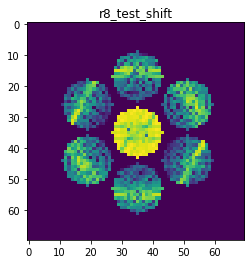

X_sim.max(): 0.9452438288733398
nlogf_X_sim.max(): 6.852500283064173
>>>replaced the 6. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 420ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 264ms/step - loss: 0.0056 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 261ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 265ms/step - loss: 0.0055 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 264ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000


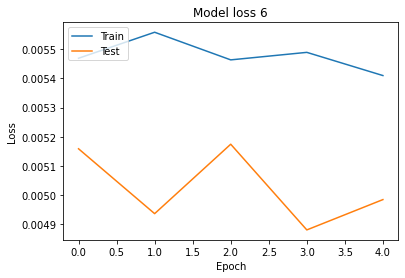

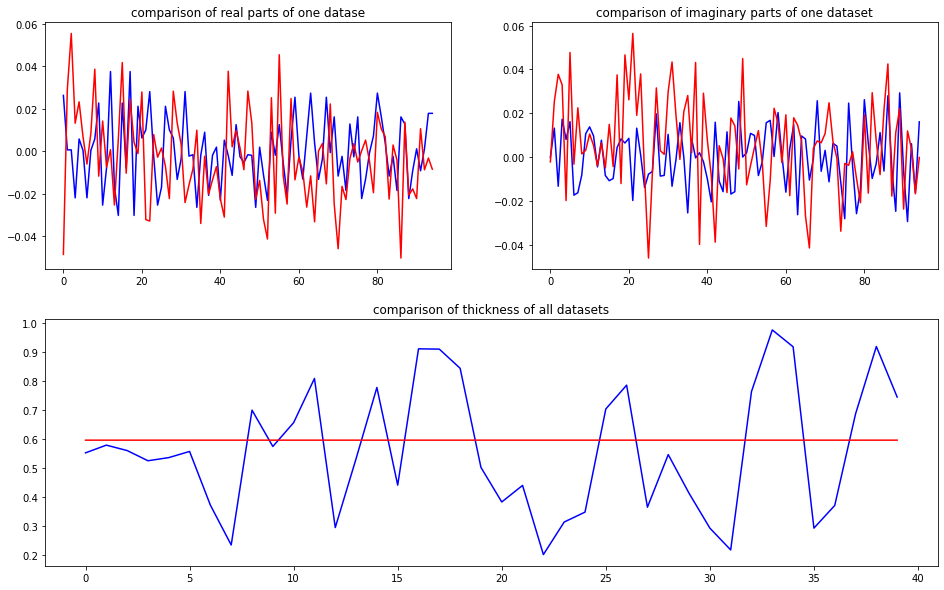

predicted thickness: 0.5956779


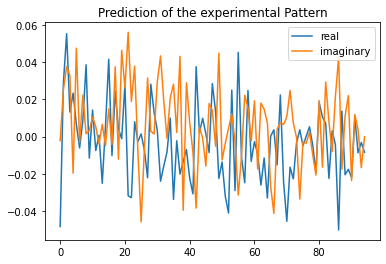

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=595.67791223526
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.0484345 +0.j          0.04220884-0.0062308j   0.04220884+0.0062308j
  0.00355071+0.01805467j  0.03104134-0.01063765j  0.00754832+0.01262307j
  0.00355071-0.01805467j  0.00754832-0.01262

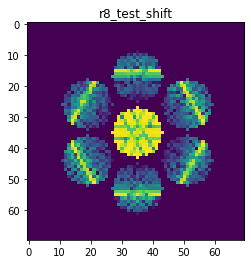

X_sim.max(): 0.9782745155205157
nlogf_X_sim.max(): 6.886812007229268
>>>replaced the 7. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 465ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 301ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 292ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 299ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 306ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000


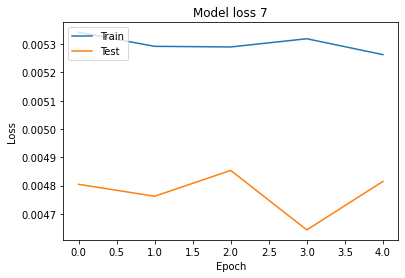

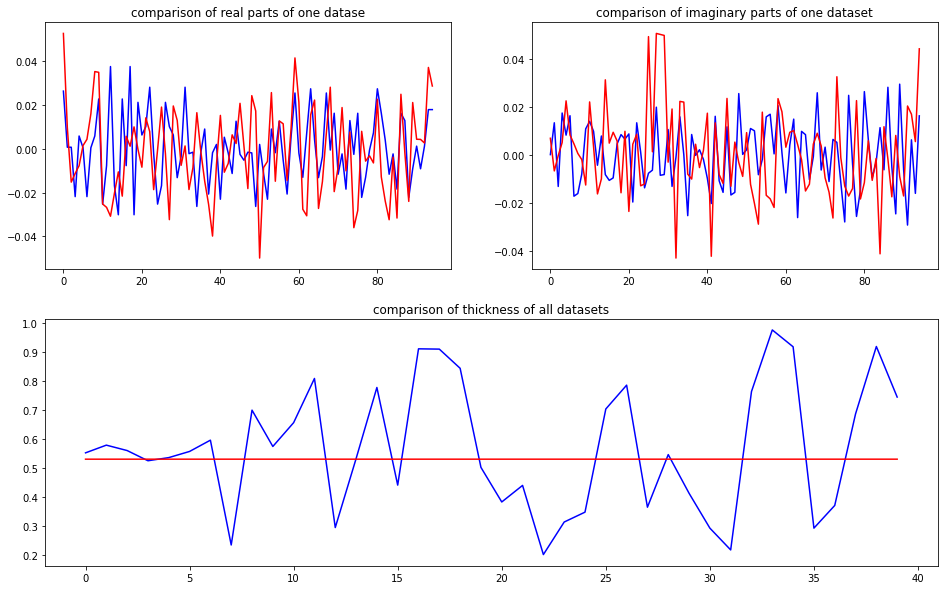

predicted thickness: 0.5302006


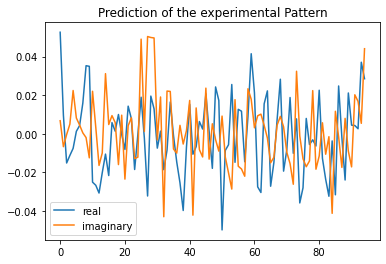

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=530.2006006240845
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.05264971+0.j         -0.00283441-0.00316153j -0.00283441+0.00316153j
 -0.00354031+0.00023314j  0.01382745+0.01221819j  0.00855757+0.00385589j
 -0.00354031-0.00023314j  0.00855757-0.00

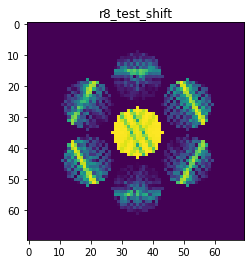

X_sim.max(): 0.9917902272480038
nlogf_X_sim.max(): 6.900519390215845
>>>replaced the 8. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 460ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 293ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 292ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 288ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 296ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000


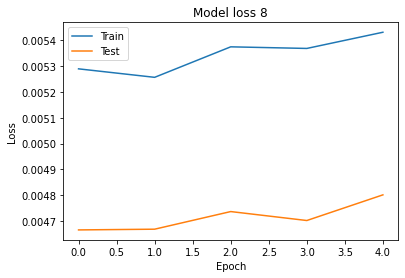

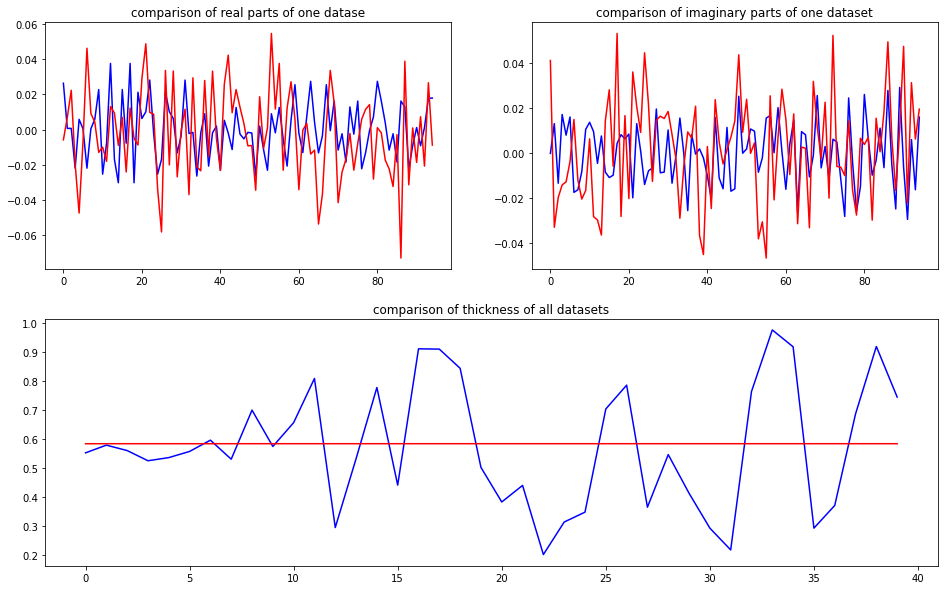

predicted thickness: 0.58343995


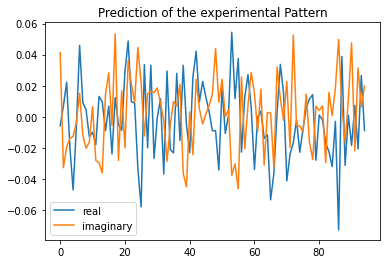

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=583.4399461746216
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00579657+0.j          0.01458267-0.006623j    0.01458267+0.006623j
  0.0132235 -0.01457155j -0.02142156+0.00381676j  0.00111949+0.00404074j
  0.0132235 +0.01457155j  0.00111949-0.0040

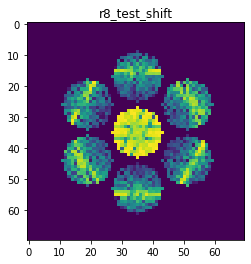

X_sim.max(): 0.9559575548082777
nlogf_X_sim.max(): 6.863759038126912
>>>replaced the 9. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 506ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 297ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 299ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 313ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 304ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000


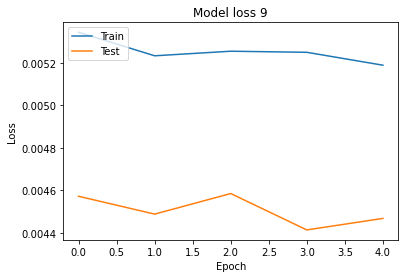

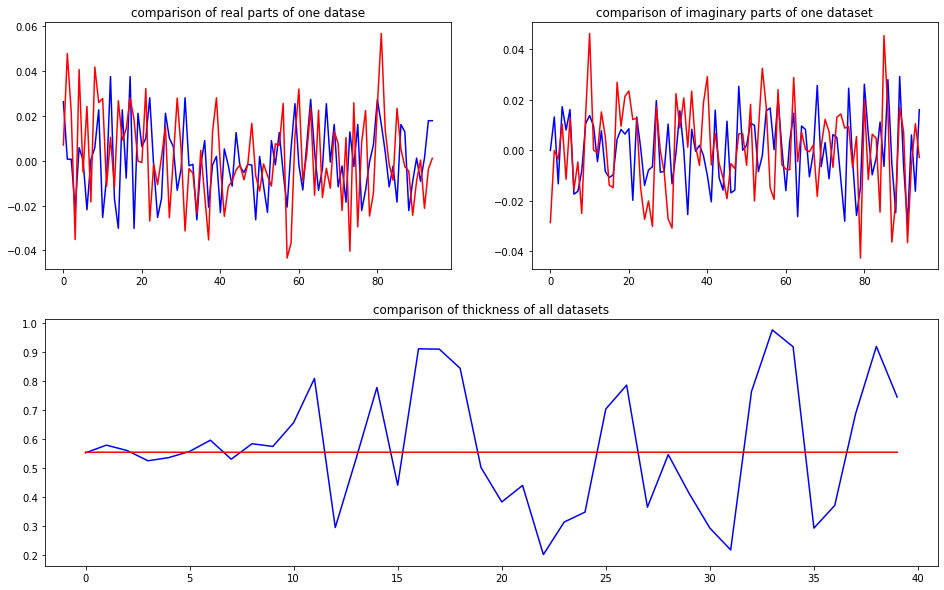

predicted thickness: 0.5541427


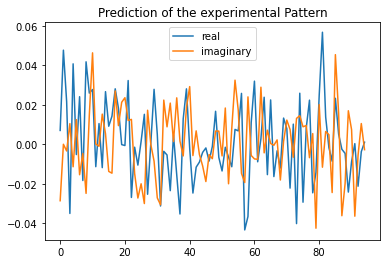

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=554.1427135467529
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 7.02378899e-03+0.j          3.46801309e-02+0.00169895j
  3.46801309e-02-0.00169895j -5.47925942e-03+0.01295912j
  4.13235649e-02+0.00675009j -1.18005488e-02+0.00857774j
 -5.47925942e-03

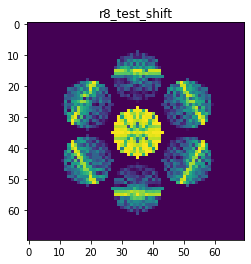

X_sim.max(): 0.9860636761210213
nlogf_X_sim.max(): 6.8947345521660885
>>>replaced the 10. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 436ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 287ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 288ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 281ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 301ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000


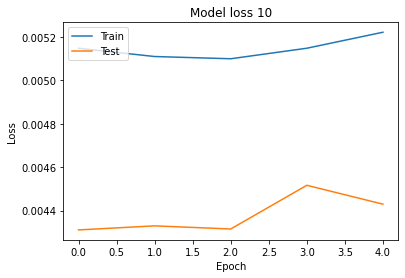

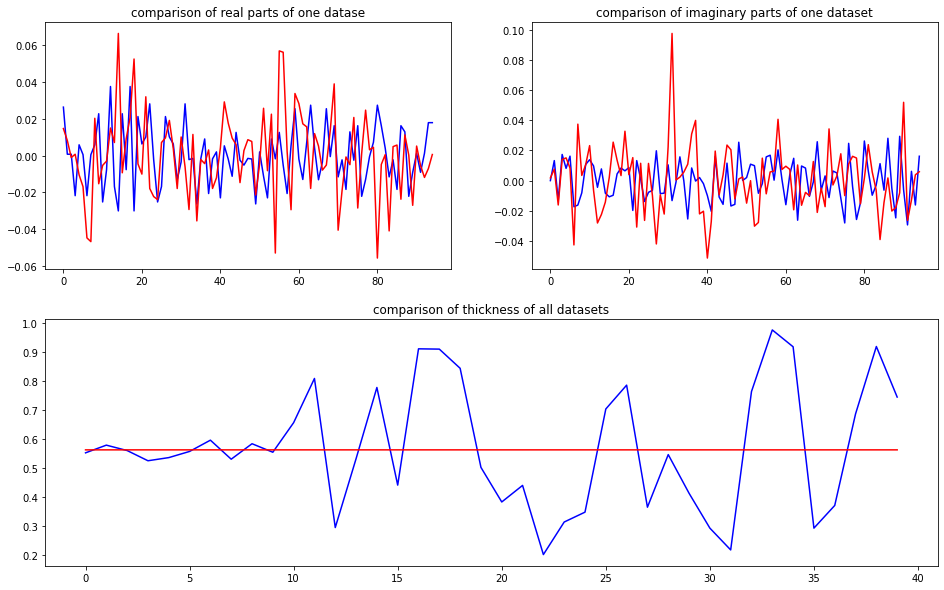

predicted thickness: 0.56227314


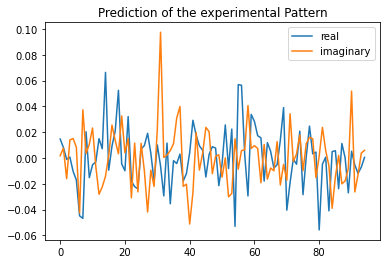

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=562.2731447219849
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01465461+0.j          0.00349546+0.0118668j   0.00349546-0.0118668j
 -0.02210829+0.02825404j  0.00492812+0.00579538j -0.03198433-0.01451065j
 -0.02210829-0.02825404j -0.03198433+0.014

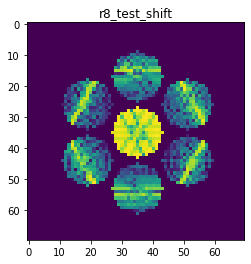

X_sim.max(): 0.9398749567932684
nlogf_X_sim.max(): 6.846810247432833
>>>replaced the 11. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 455ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 295ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 2s 317ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 312ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 305ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000


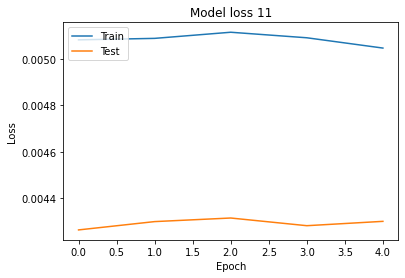

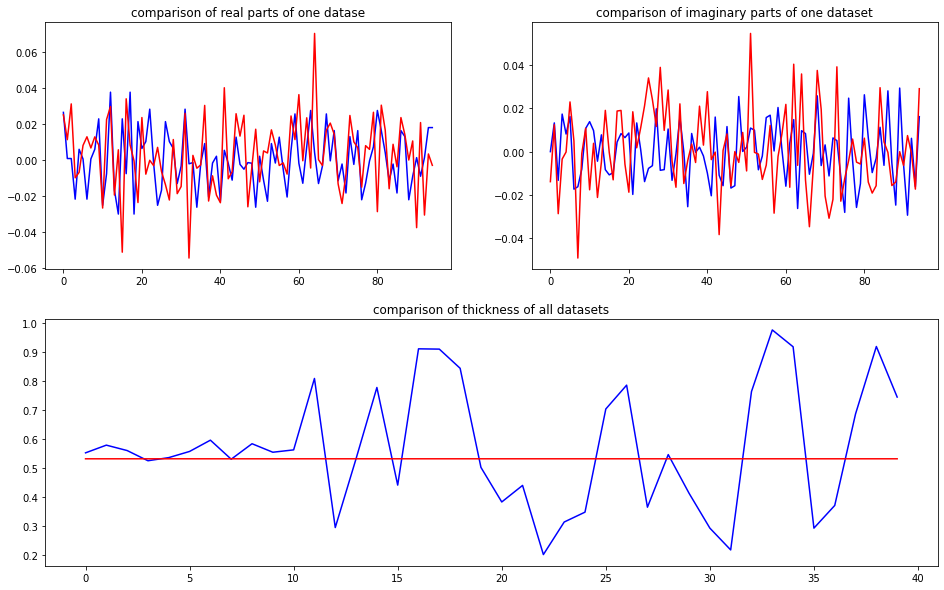

predicted thickness: 0.53152627


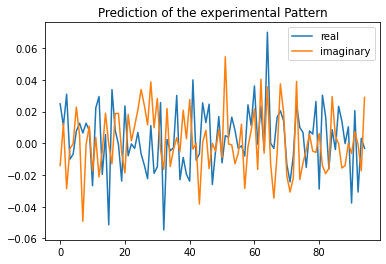

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=531.5262675285339
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 2.49266755e-02+0.00000000e+00j  2.10572169e-02+2.05218429e-02j
  2.10572169e-02-2.05218429e-02j  1.33792544e-03-4.19386174e-03j
  2.92376895e-03+3.34526470e-04j  7.17024435e-03+3.598855

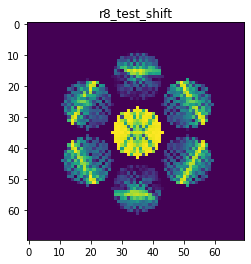

X_sim.max(): 0.9763571355017845
nlogf_X_sim.max(): 6.884852128238788
>>>replaced the 12. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 486ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 312ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 290ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 309ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 306ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000


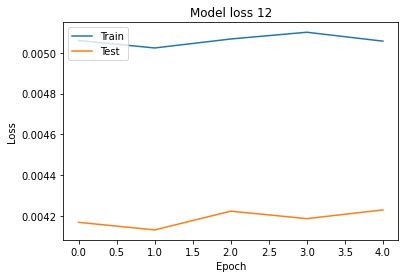

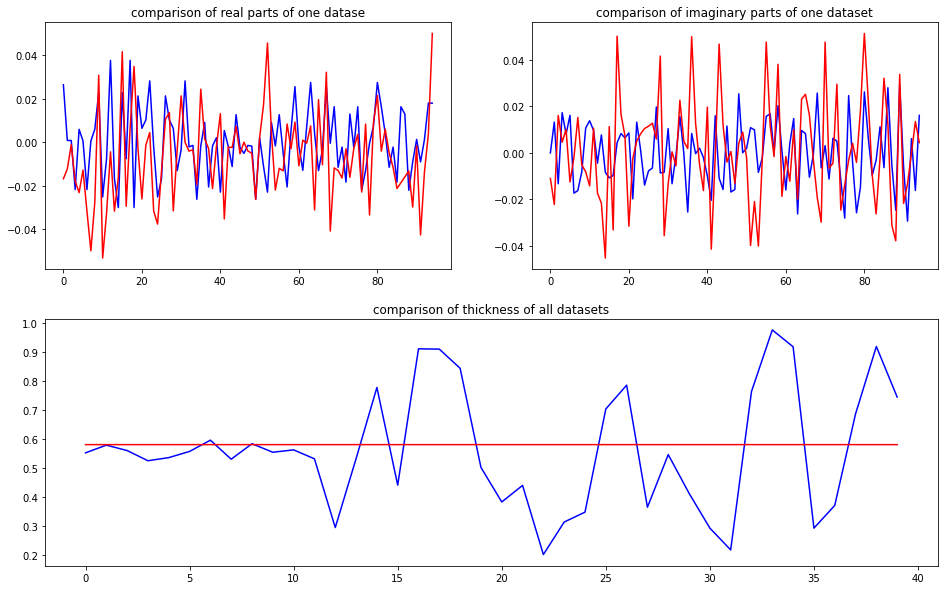

predicted thickness: 0.580331


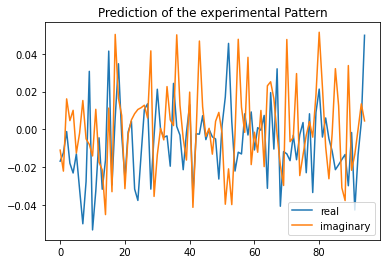

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=580.331027507782
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01689998+0.00000000e+00j -0.00681746-1.91382654e-02j
 -0.00681746+1.91382654e-02j -0.02489492+3.31328798e-03j
 -0.02541743+7.56738894e-03j -0.03154566-1.39109949e-02j
 -0.02489492-3.31

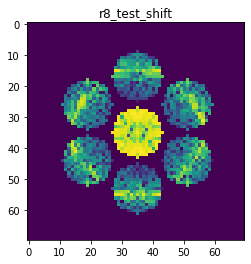

X_sim.max(): 0.9365077119921827
nlogf_X_sim.max(): 6.843224983935727
>>>replaced the 13. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 461ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 299ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 295ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 298ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 292ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000


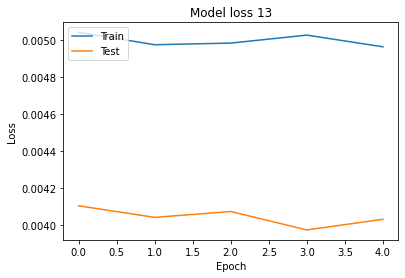

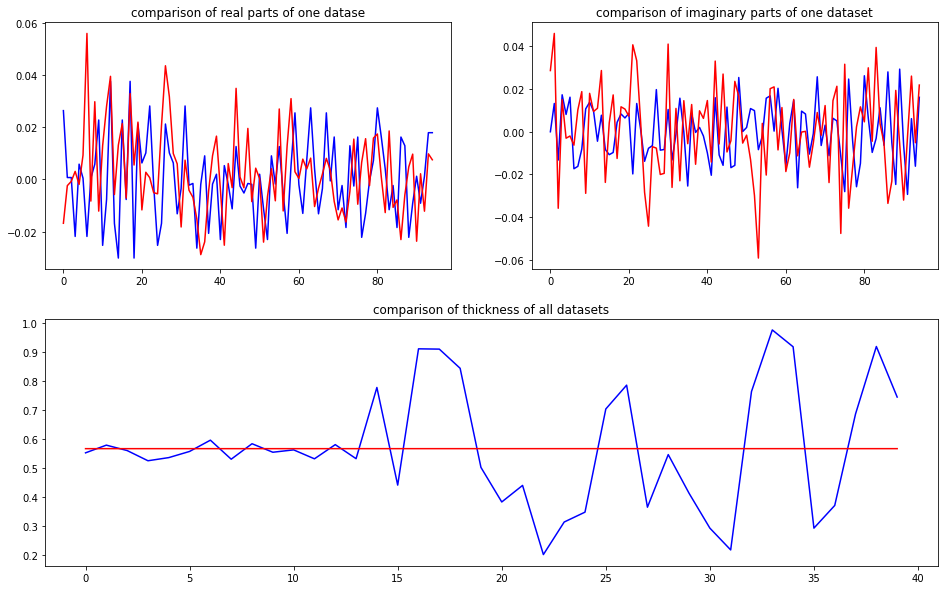

predicted thickness: 0.56643254


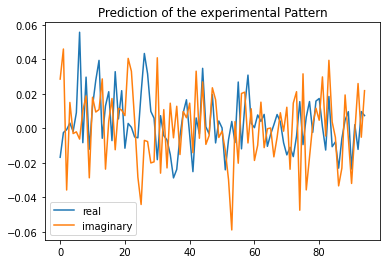

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=566.432535648346
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01680881+0.j         -0.0016192 +0.04093103j -0.0016192 -0.04093103j
  0.0294263 +0.01063638j  0.01395502-0.01092328j  0.00038651-0.00614548j
  0.0294263 -0.01063638j  0.00038651+0.006

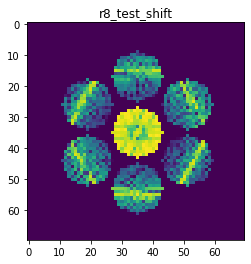

X_sim.max(): 0.9600627949462707
nlogf_X_sim.max(): 6.868039750171899
>>>replaced the 14. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 460ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 295ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 297ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 297ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 309ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000


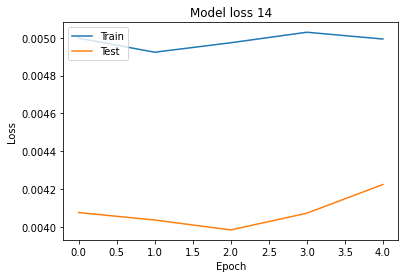

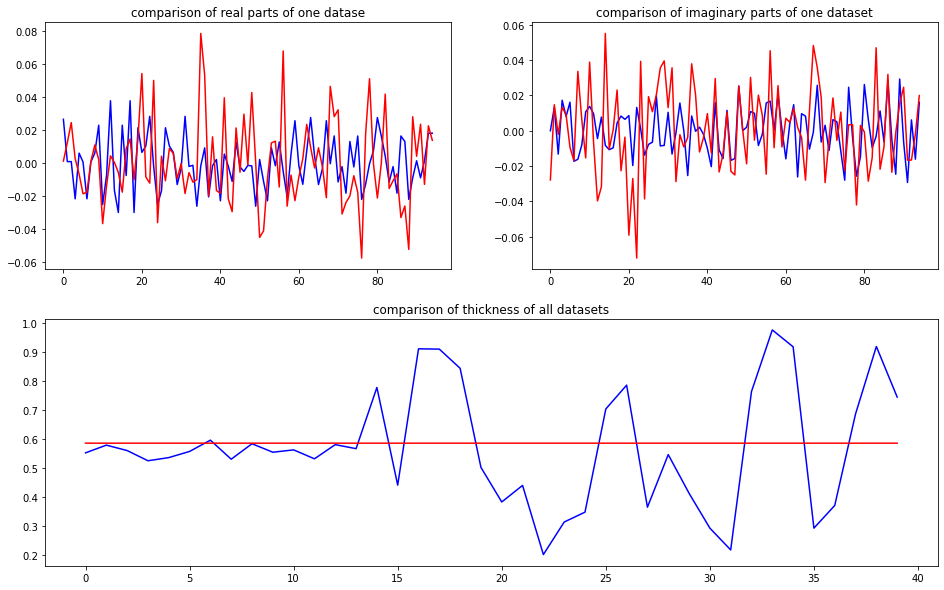

predicted thickness: 0.5853074


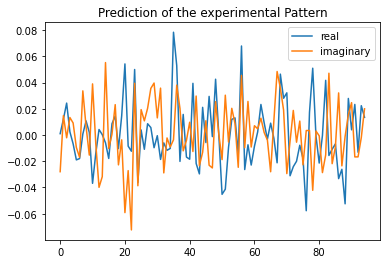

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=585.3074193000793
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 1.01380527e-03+0.j          1.82196163e-02+0.00844075j
  1.82196163e-02-0.00844075j -7.74561719e-03+0.01516451j
  2.00106273e-03+0.00137134j -9.10657083e-03-0.02158378j
 -7.74561719e-03

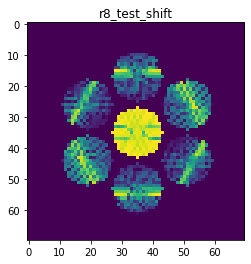

X_sim.max(): 0.9815160973740497
nlogf_X_sim.max(): 6.890116727704923
>>>replaced the 15. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 503ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 287ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 290ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 304ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 266ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000


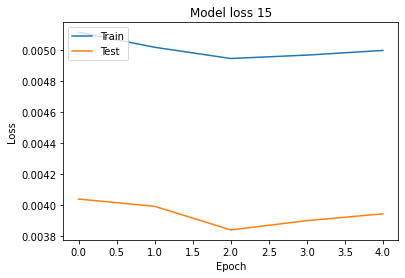

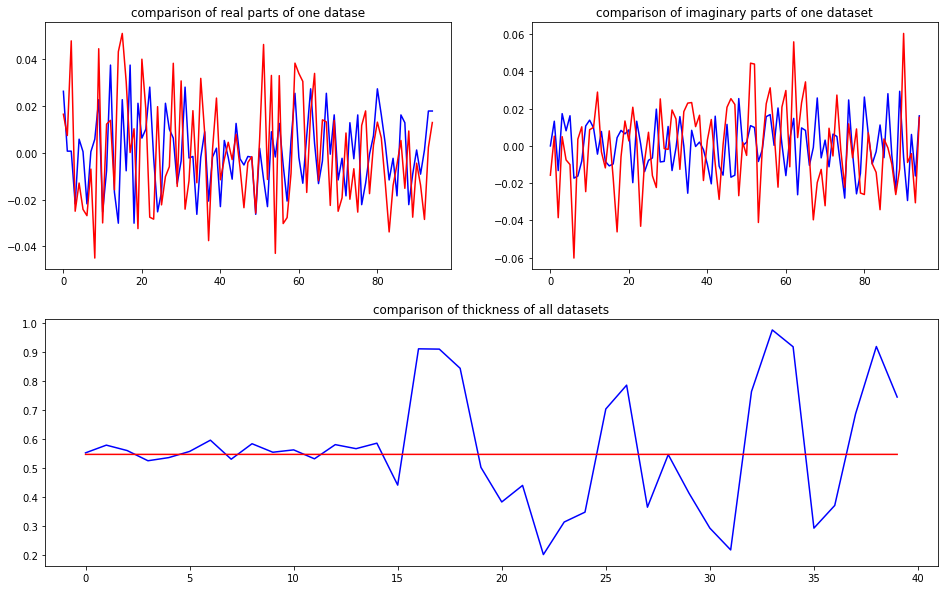

predicted thickness: 0.5467386


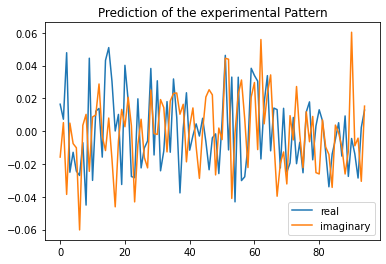

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=546.7386245727539
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01647664+0.j          0.02760581+0.02188605j  0.02760581-0.02188605j
 -0.02598776+0.03256694j -0.02893741-0.00891237j -0.01566996-0.00685168j
 -0.02598776-0.03256694j -0.01566996+0.00

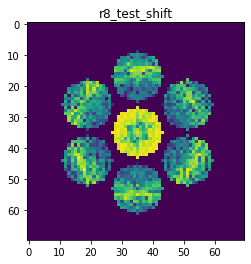

X_sim.max(): 0.9307735867133737
nlogf_X_sim.max(): 6.837089852461688
>>>replaced the 16. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 414ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 281ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 287ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 287ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 286ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000


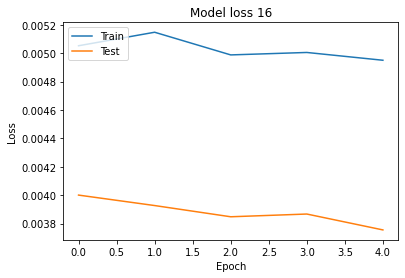

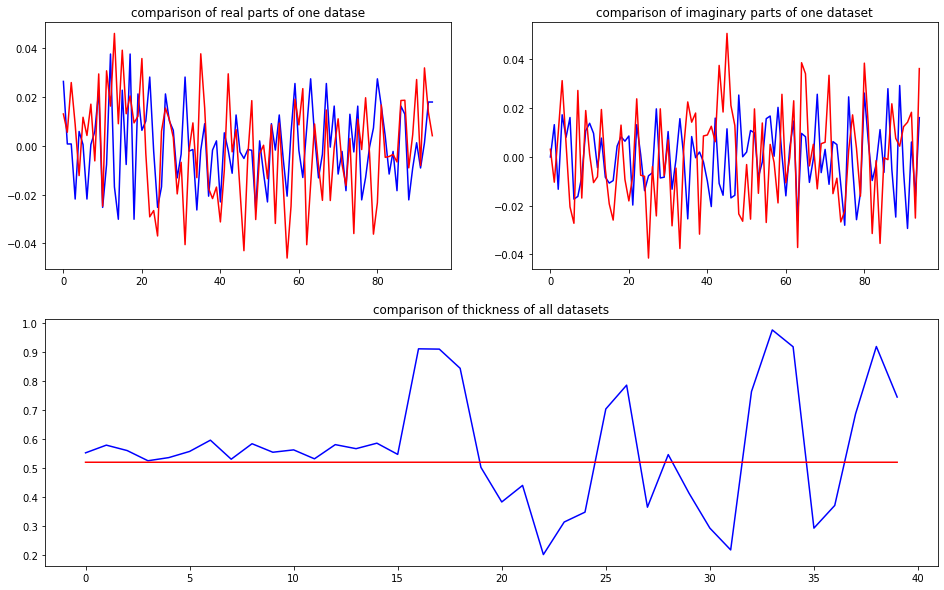

predicted thickness: 0.5196854


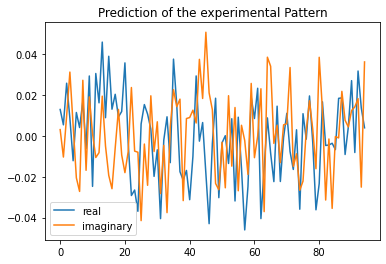

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=519.6853876113892
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01297366+0.j          0.01565095-0.01010038j  0.01565095+0.01010038j
  0.00640448+0.02924863j -0.00918979+0.01106809j  0.01423913-0.02390576j
  0.00640448-0.02924863j  0.01423913+0.02

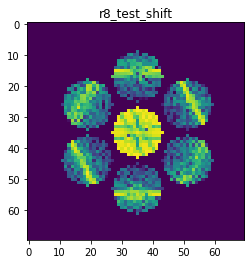

X_sim.max(): 0.9479155505518914
nlogf_X_sim.max(): 6.855319806822975
>>>replaced the 17. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 449ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 289ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 292ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000


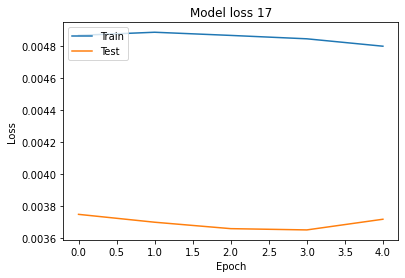

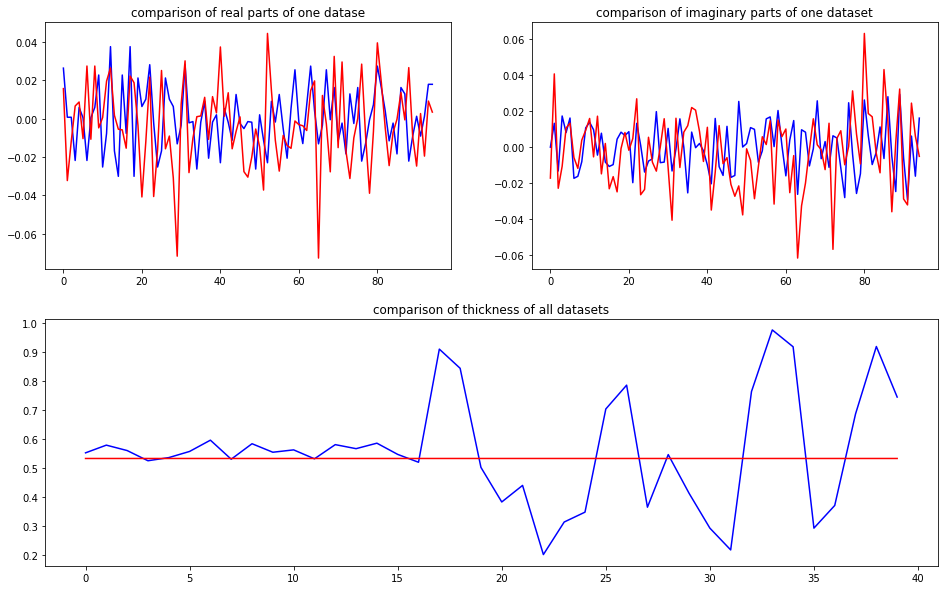

predicted thickness: 0.53264713


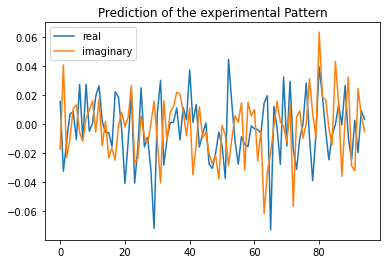

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=532.6471328735352
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 1.56256612e-02+0.j         -2.21181512e-02+0.03178103j
 -2.21181512e-02-0.03178103j  1.69540835e-02-0.00244406j
  1.80746173e-02+0.00331732j -1.06945350e-02+0.01254663j
  1.69540835e-02

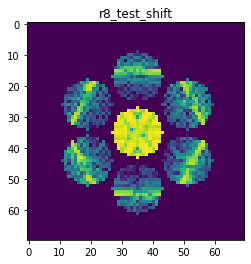

X_sim.max(): 0.9677901897017065
nlogf_X_sim.max(): 6.8760480659507275
>>>replaced the 18. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 432ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 279ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 278ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 278ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000


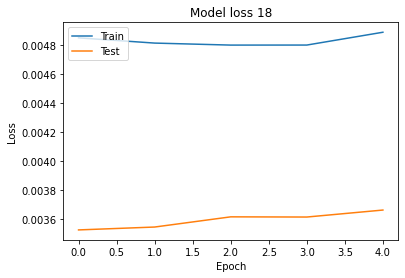

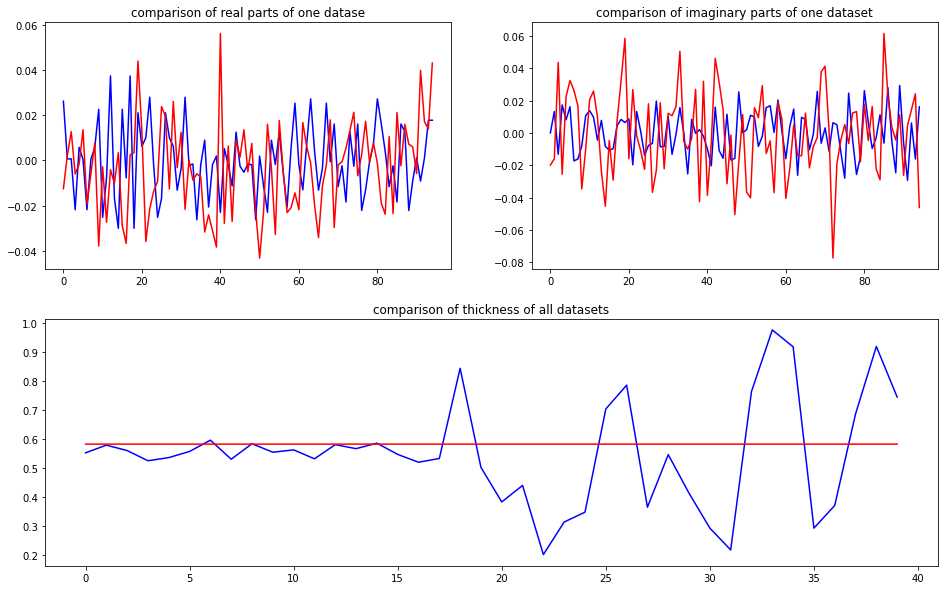

predicted thickness: 0.5820442


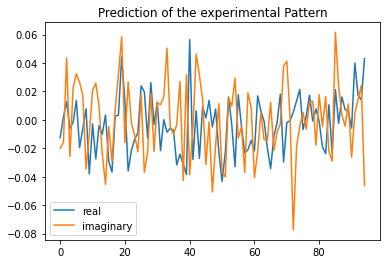

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=582.0441842079163
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01255078+0.j          0.00743301-0.02981638j  0.00743301+0.02981638j
 -0.01273113-0.02601514j  0.00307176+0.02860344j  0.00379634+0.00772594j
 -0.01273113+0.02601514j  0.00379634-0.00

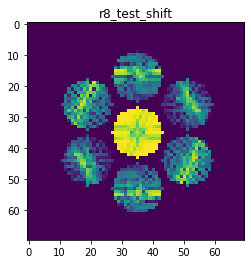

X_sim.max(): 0.9891010643526805
nlogf_X_sim.max(): 6.897807023123024
>>>replaced the 19. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 416ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 254ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 259ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 254ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 249ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000


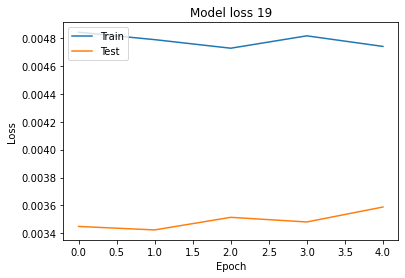

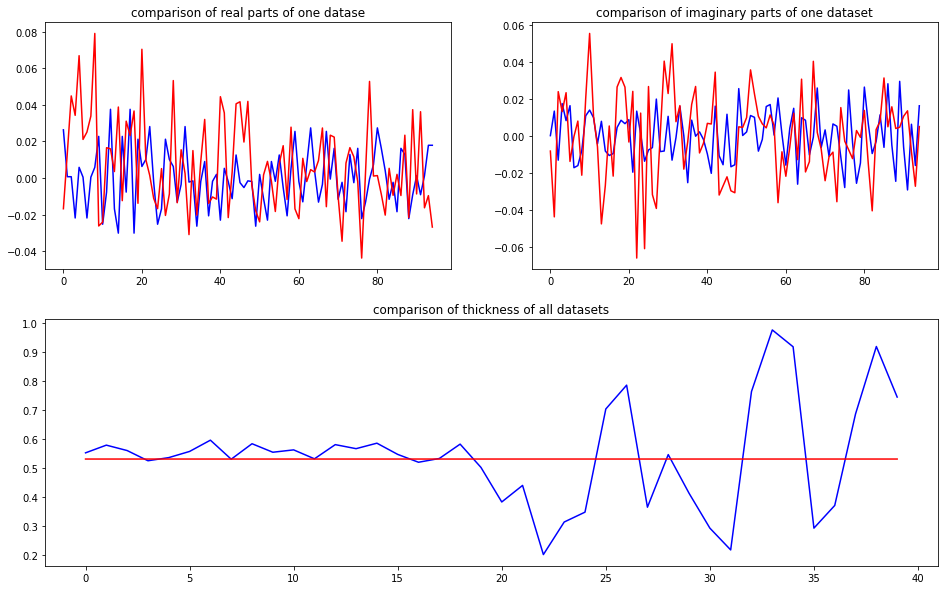

predicted thickness: 0.5307045


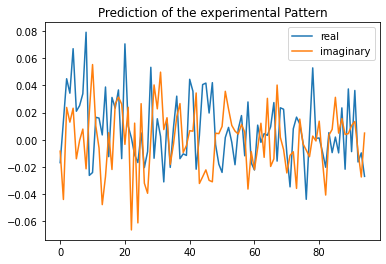

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=530.7044982910156
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01679762+0.j          0.02925099-0.03380446j  0.02925099+0.03380446j
  0.0296344 +0.00674113j  0.07293214+0.02225738j  0.02738845-0.01090864j
  0.0296344 -0.00674113j  0.02738845+0.01

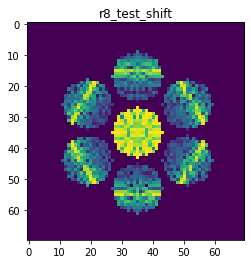

X_sim.max(): 0.9501591960559931
nlogf_X_sim.max(): 6.857681447122554
>>>replaced the 20. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 437ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 269ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000


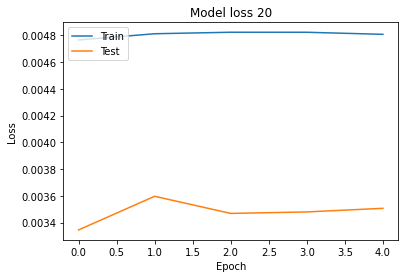

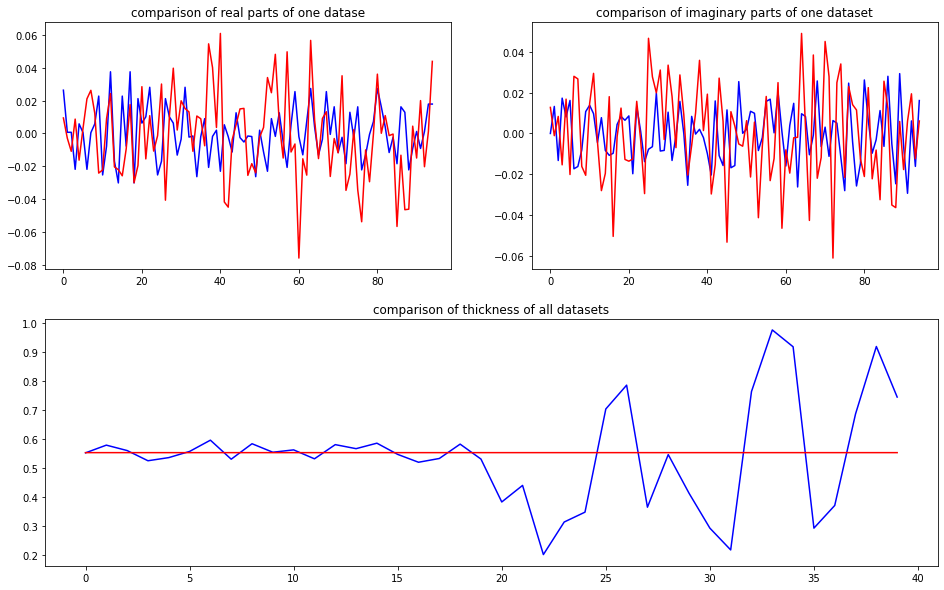

predicted thickness: 0.55272907


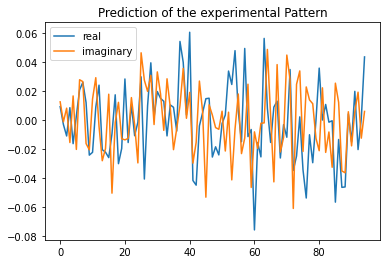

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=552.729070186615
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00941361+0.00000000e+00j -0.00689927-4.71266499e-03j
 -0.00689927+4.71266499e-03j  0.01486005-2.17019077e-02j
 -0.00197876+1.64660439e-02j  0.01463535-2.34408751e-02j
  0.01486005+2.17

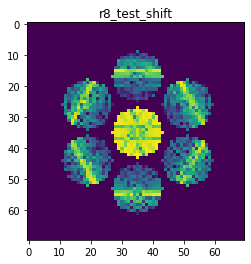

X_sim.max(): 0.9761237010835344
nlogf_X_sim.max(): 6.884613257214841
>>>replaced the 21. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 485ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 269ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 268ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 267ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000


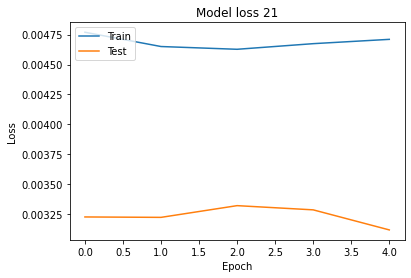

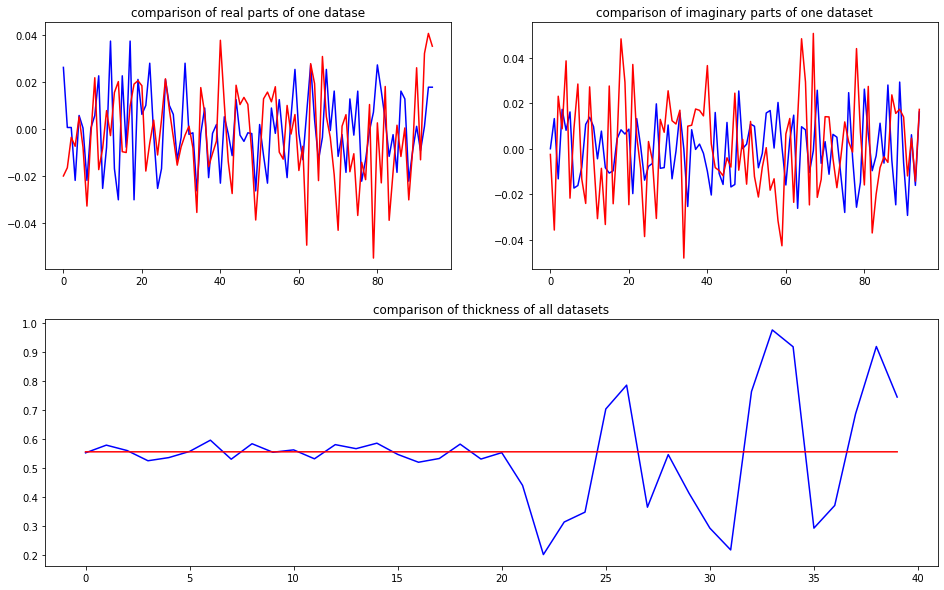

predicted thickness: 0.5555573


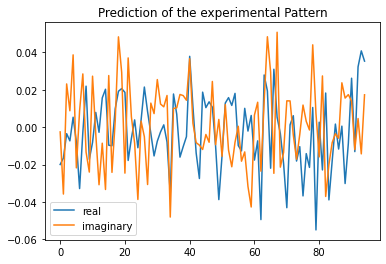

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=555.5573105812073
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-1.99693870e-02+0.00000000e+00j -9.98867967e-03-2.94348141e-02j
 -9.98867967e-03+2.94348141e-02j -2.00794444e-02-1.09369867e-05j
  1.36087579e-02+2.59858370e-02j -5.29576372e-03-2.511313

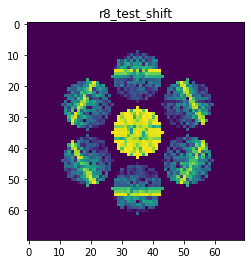

X_sim.max(): 0.9569494837213205
nlogf_X_sim.max(): 6.864795045600701
>>>replaced the 22. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 448ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 291ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 291ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 289ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 277ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000


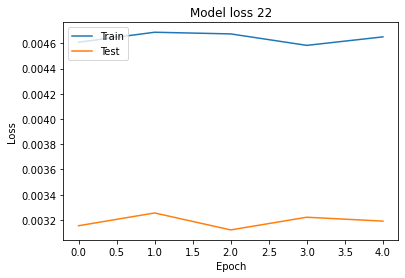

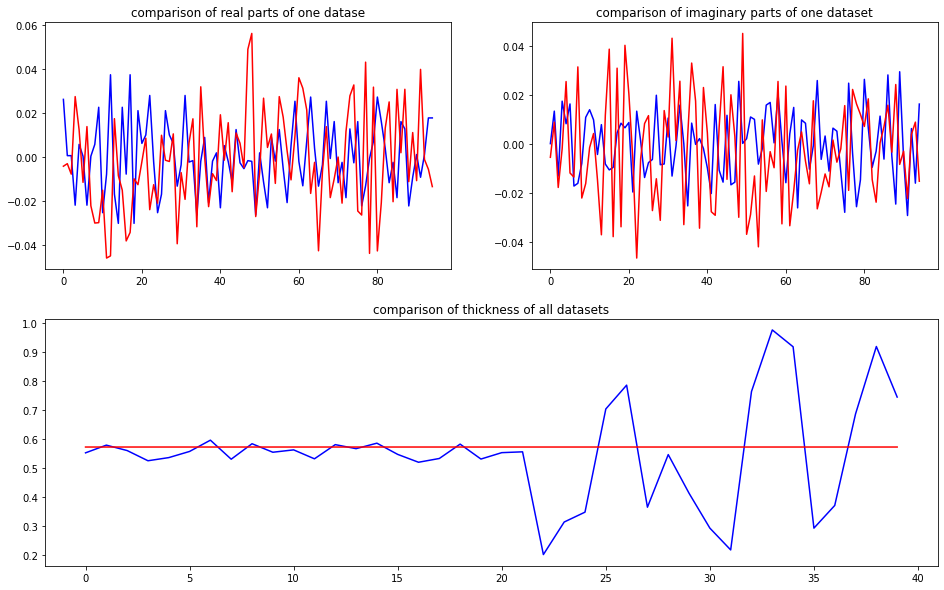

predicted thickness: 0.5720563


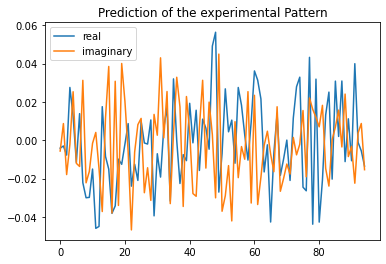

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=572.0562934875488
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00410414+0.j         -0.00534629+0.01330535j -0.00534629-0.01330535j
  0.02074032+0.00574846j -0.00870428+0.02375348j -0.01683786-0.02164566j
  0.02074032-0.00574846j -0.01683786+0.02

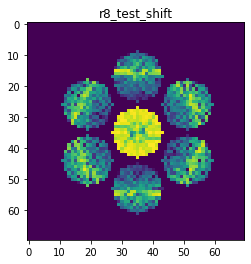

X_sim.max(): 0.9437615301000152
nlogf_X_sim.max(): 6.850932546547838
>>>replaced the 23. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 440ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 281ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 277ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 283ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 280ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000


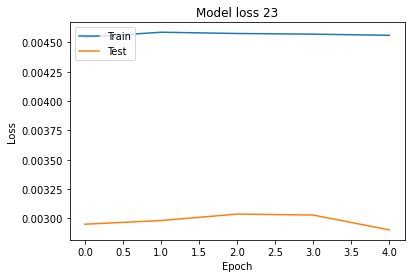

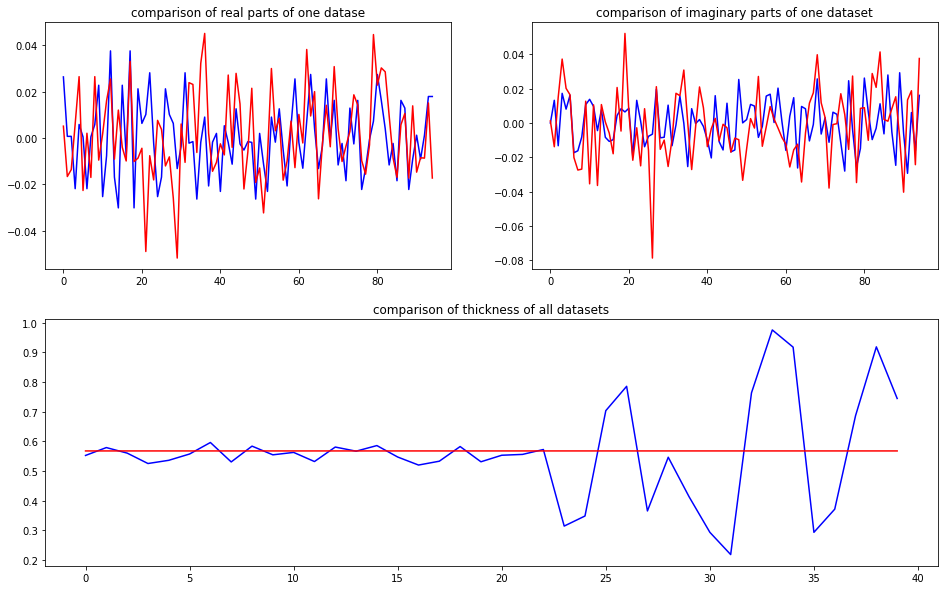

predicted thickness: 0.56722385


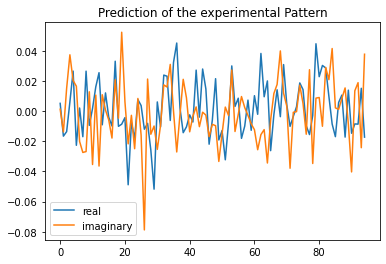

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=567.223846912384
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 5.10039693e-03+0.j         -1.51314656e-02-0.01447585j
 -1.51314656e-02+0.01447585j  3.99361202e-03+0.02871455j
  2.64549861e-02+0.02354988j -1.98503276e-02+0.02194647j
  3.99361202e-03-

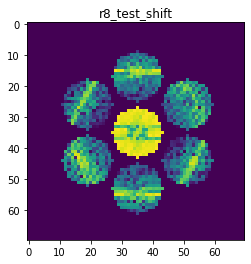

X_sim.max(): 0.9630921309250792
nlogf_X_sim.max(): 6.871186861542926
>>>replaced the 24. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 429ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 264ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 274ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 274ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000


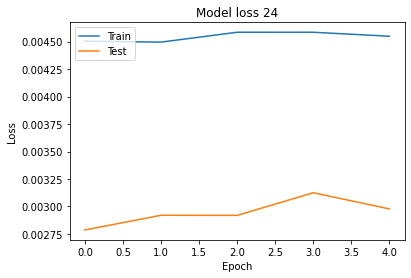

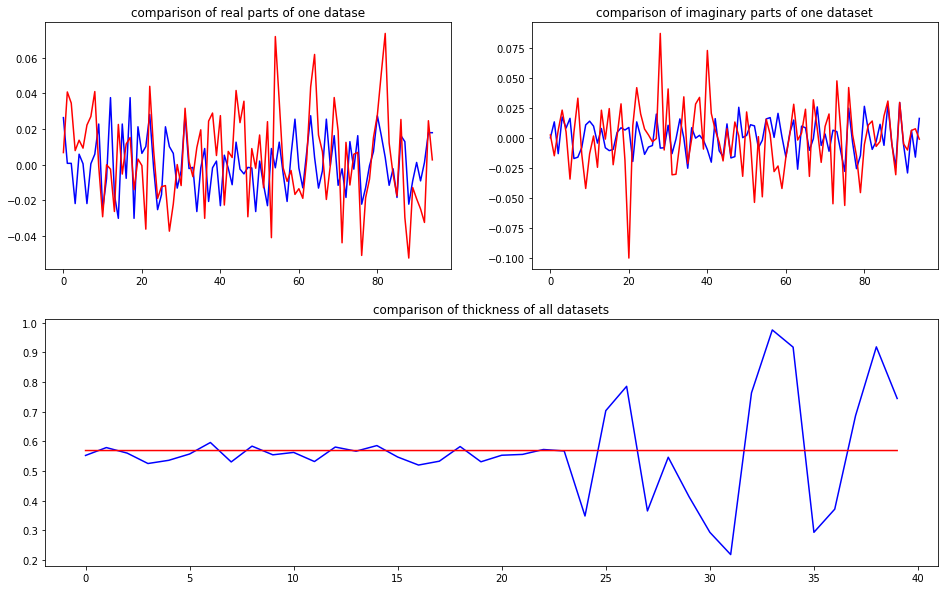

predicted thickness: 0.5685642


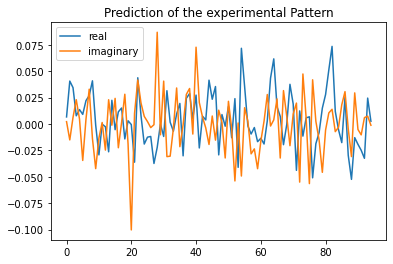

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=568.5641765594482
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00674501+0.00000000e+00j  0.03757699-1.06473102e-02j
  0.03757699+1.06473102e-02j  0.01497545+9.25711729e-03j
  0.02731647+9.25540458e-03j  0.01804527-3.37266903e-02j
  0.01497545-9.2

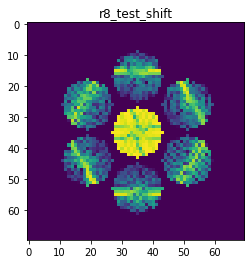

X_sim.max(): 0.9694201047436646
nlogf_X_sim.max(): 6.877729075411582
>>>replaced the 25. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 440ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 280ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 283ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 288ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000


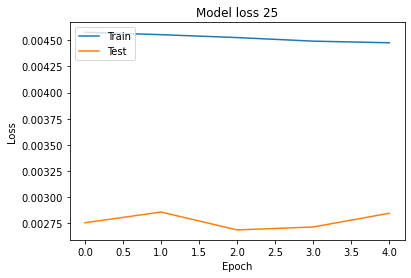

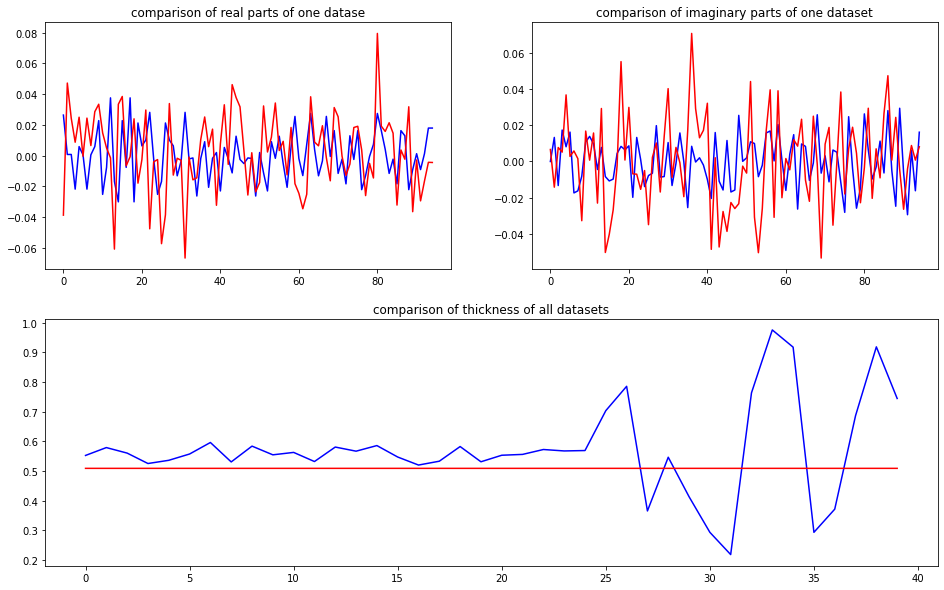

predicted thickness: 0.50852686


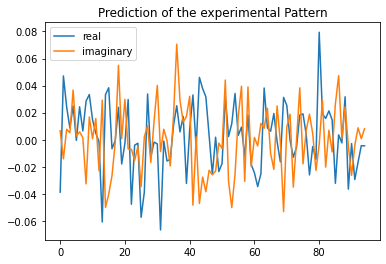

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=508.52686166763306
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.03876624+0.j          0.03569752-0.01092037j  0.03569752+0.01092037j
  0.01648168-0.00032438j  0.02674005+0.03465415j  0.00300028+0.00061613j
  0.01648168+0.00032438j  0.00300028-0.0

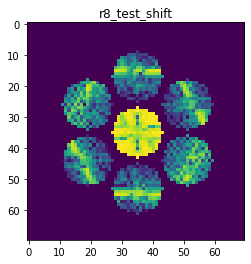

X_sim.max(): 0.933807121715366
nlogf_X_sim.max(): 6.840340221073173
>>>replaced the 26. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 434ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 280ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 286ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 283ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000


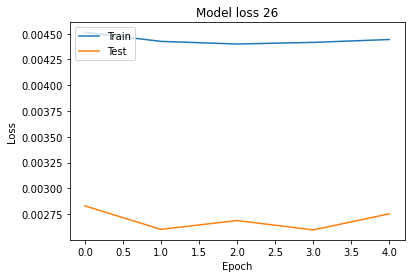

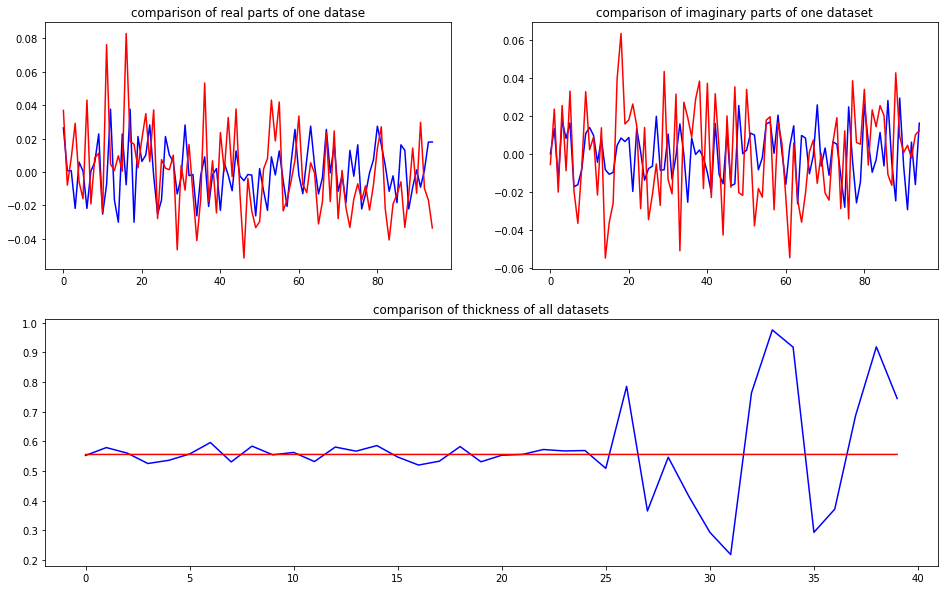

predicted thickness: 0.55542606


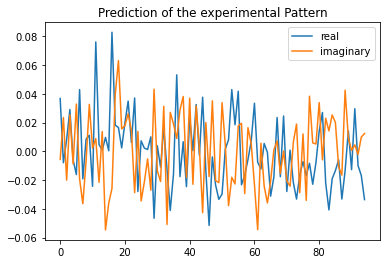

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=555.4260611534119
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.0368187 +0.j          0.0001682 +0.02179466j  0.0001682 -0.02179466j
  0.03603593+0.02232791j  0.00125047-0.00096288j -0.01767018+0.03470478j
  0.03603593-0.02232791j -0.01767018-0.03

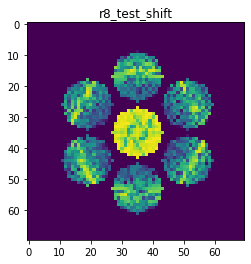

X_sim.max(): 0.9799547323167063
nlogf_X_sim.max(): 6.888526314073261
>>>replaced the 27. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 475ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 269ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 277ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000


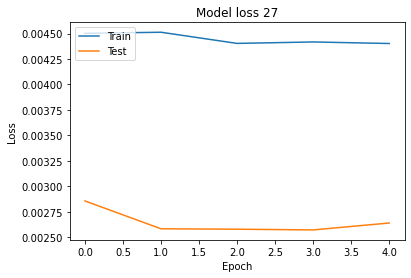

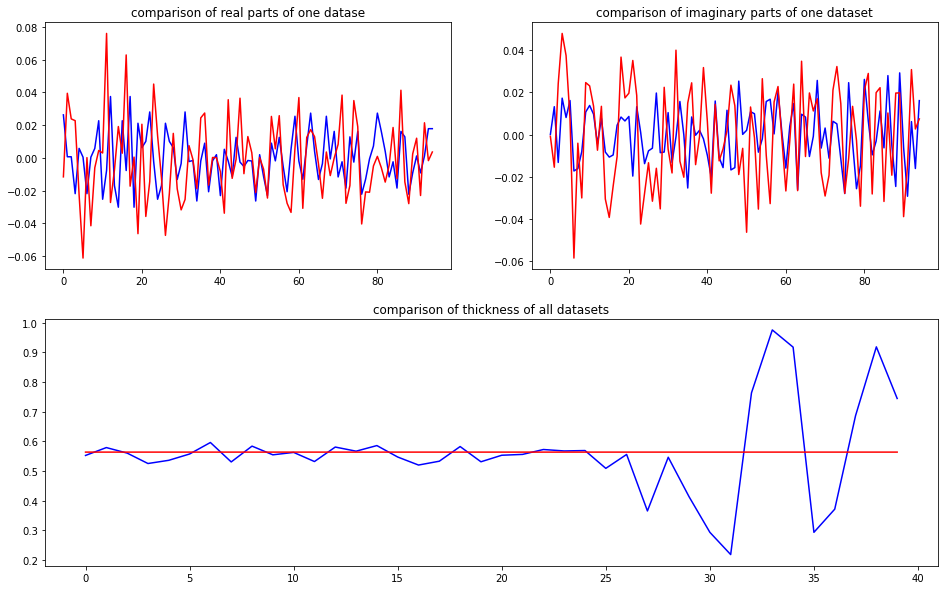

predicted thickness: 0.563257


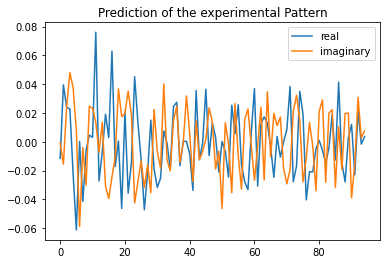

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=563.2569789886475
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01156082+0.j          0.03166722-0.01986929j  0.03166722+0.01986929j
  0.0114578 +0.05339701j -0.01423534+0.03383405j -0.05136274+0.00587537j
  0.0114578 -0.05339701j -0.05136274-0.00

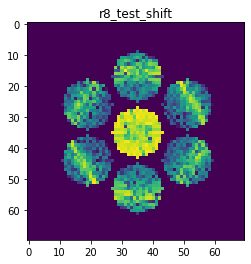

X_sim.max(): 0.9692050213053848
nlogf_X_sim.max(): 6.877507411334092
>>>replaced the 28. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 438ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 264ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 265ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000


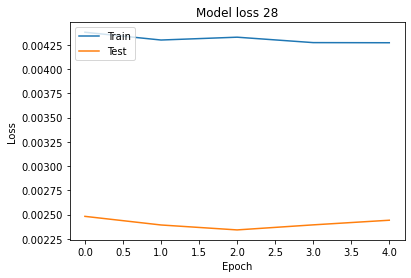

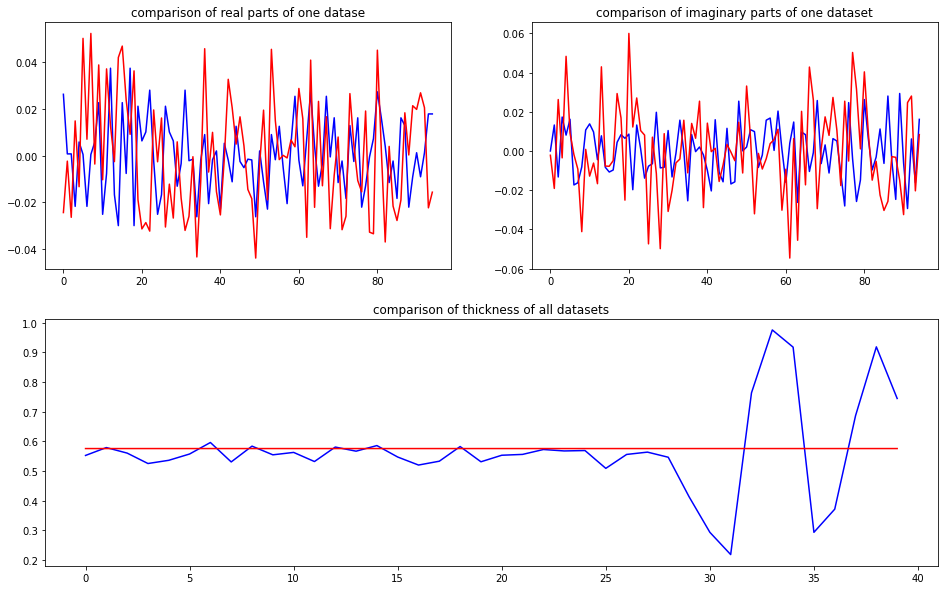

predicted thickness: 0.5752253


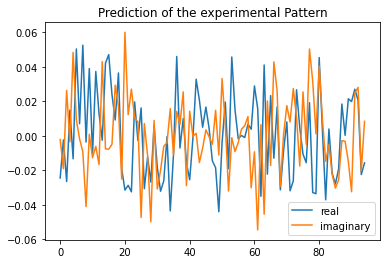

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=575.225293636322
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.02450413+0.j         -0.01448707-0.02265631j -0.01448707+0.02265631j
  0.01092031-0.00081834j -0.00851376+0.04469366j  0.0513792 +0.00922769j
  0.01092031+0.00081834j  0.0513792 -0.009

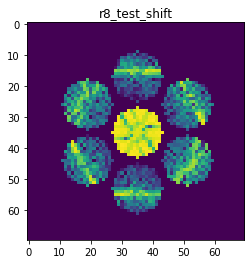

X_sim.max(): 0.989126032777992
nlogf_X_sim.max(): 6.897832240862291
>>>replaced the 29. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 450ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 291ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 289ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 290ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000


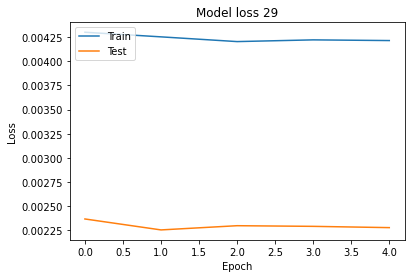

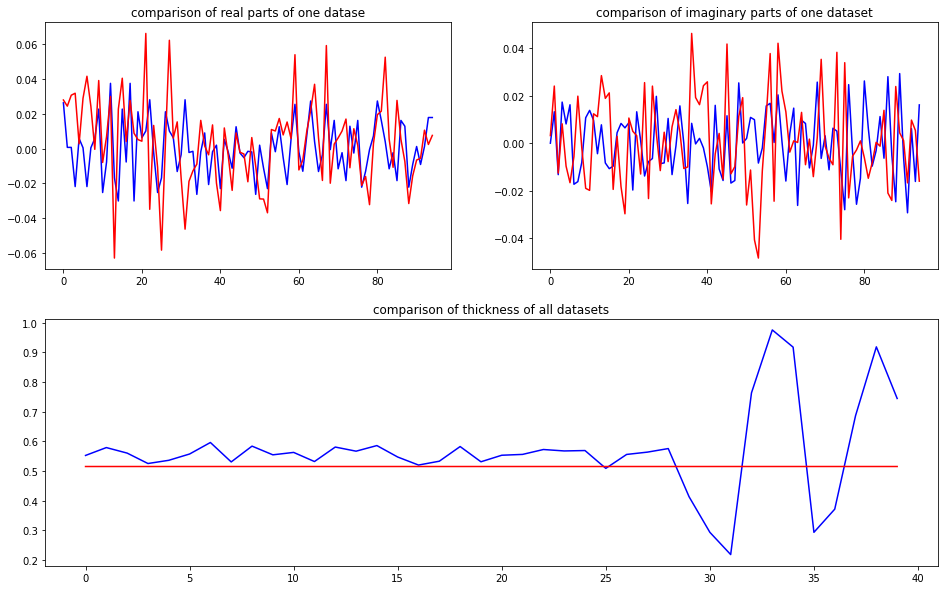

predicted thickness: 0.51474756


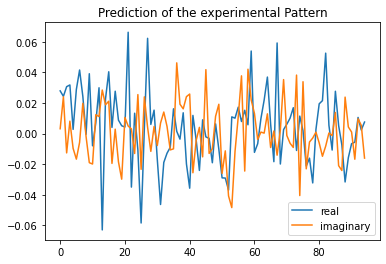

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=514.7475600242615
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02795607+0.00000000e+00j  0.02754869+1.83306551e-02j
  0.02754869-1.83306551e-02j  0.03670956+6.93473173e-03j
  0.00118353-3.87891551e-03j  0.02663799-1.82390464e-02j
  0.03670956-6.9

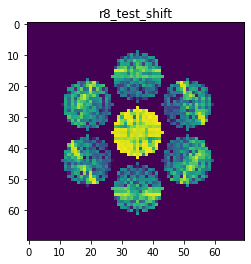

X_sim.max(): 0.9801397491545166
nlogf_X_sim.max(): 6.888714905234498
>>>replaced the 30. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 446ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 283ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000


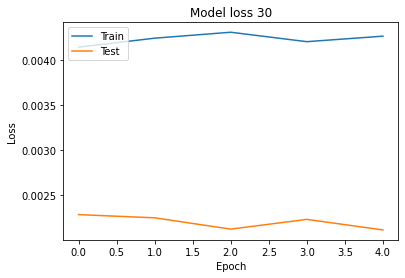

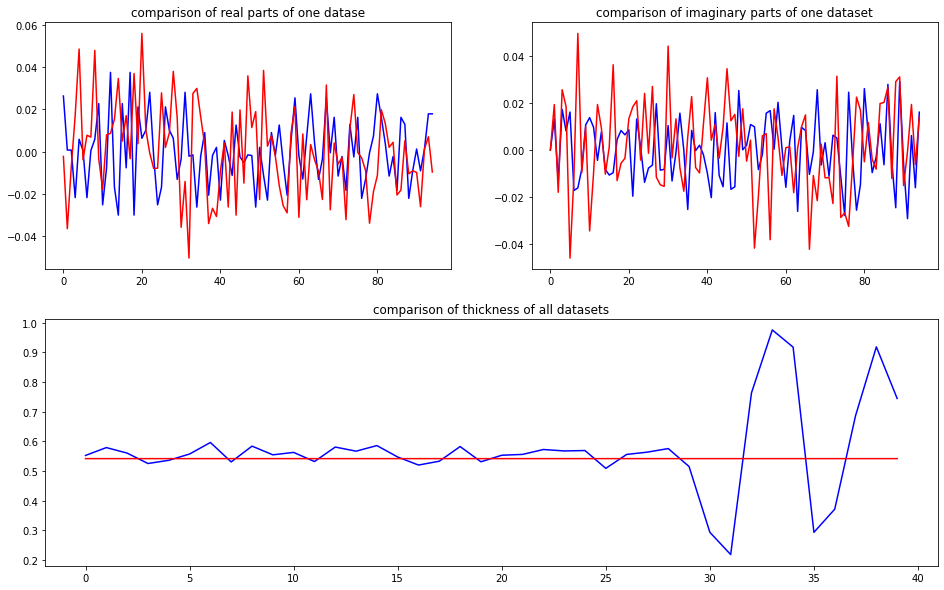

predicted thickness: 0.5412843


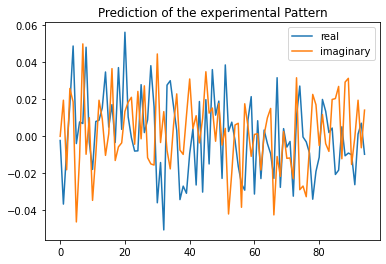

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=541.2843227386475
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00230377+0.00000000e+00j -0.022009  +1.87438363e-02j
 -0.022009  -1.87438363e-02j  0.01235468+1.85114001e-02j
  0.04829259+1.41199762e-02j  0.00144572-4.79819104e-02j
  0.01235468-1.8

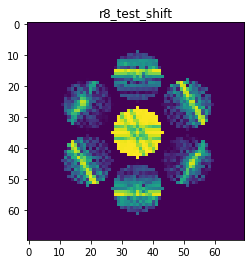

X_sim.max(): 0.9811857336921691
nlogf_X_sim.max(): 6.889780428649494
>>>replaced the 31. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 435ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 280ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 261ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000


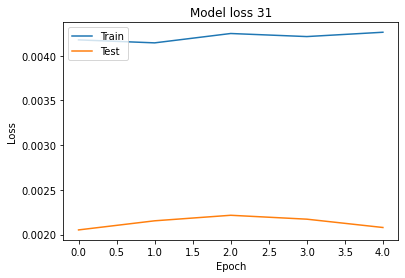

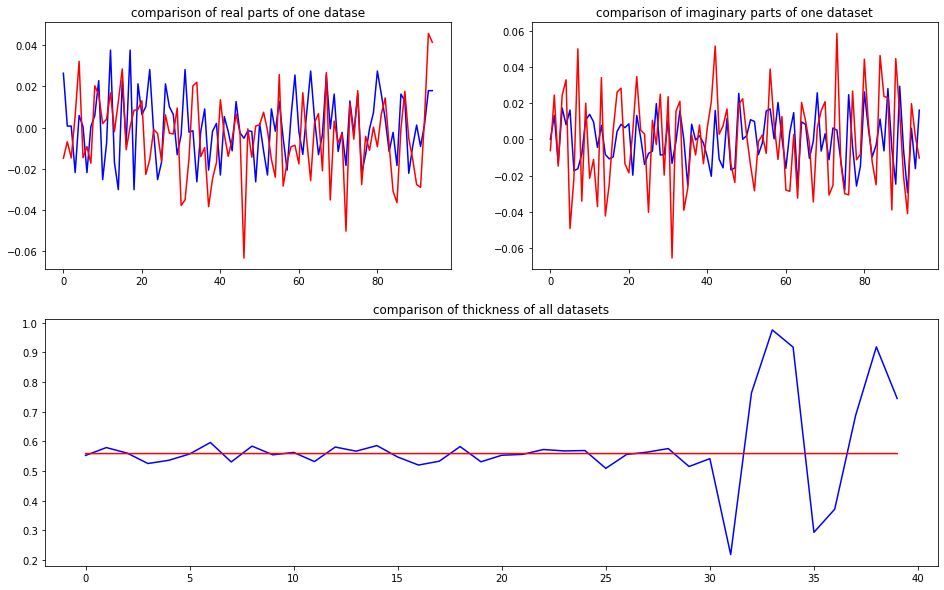

predicted thickness: 0.5583283


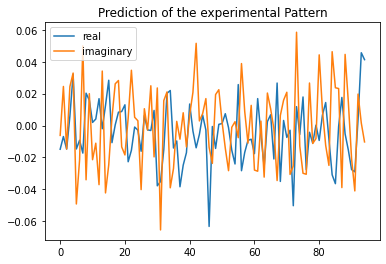

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=558.3282709121704
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01488106+0.j         -0.01083255+0.01959887j -0.01083255-0.01959887j
 -0.00174216+0.02288936j  0.02618604+0.03345648j -0.01599778-0.04957717j
 -0.00174216-0.02288936j -0.01599778+0.04

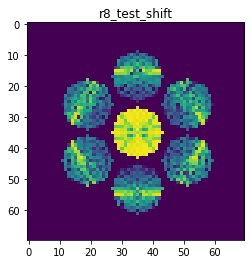

X_sim.max(): 0.9762610749927376
nlogf_X_sim.max(): 6.88475383742311
>>>replaced the 32. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 425ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 287ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 267ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000


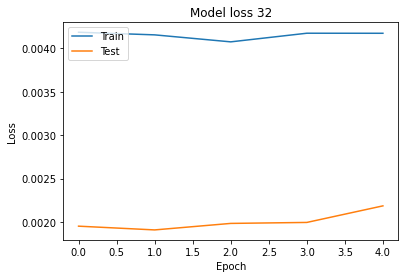

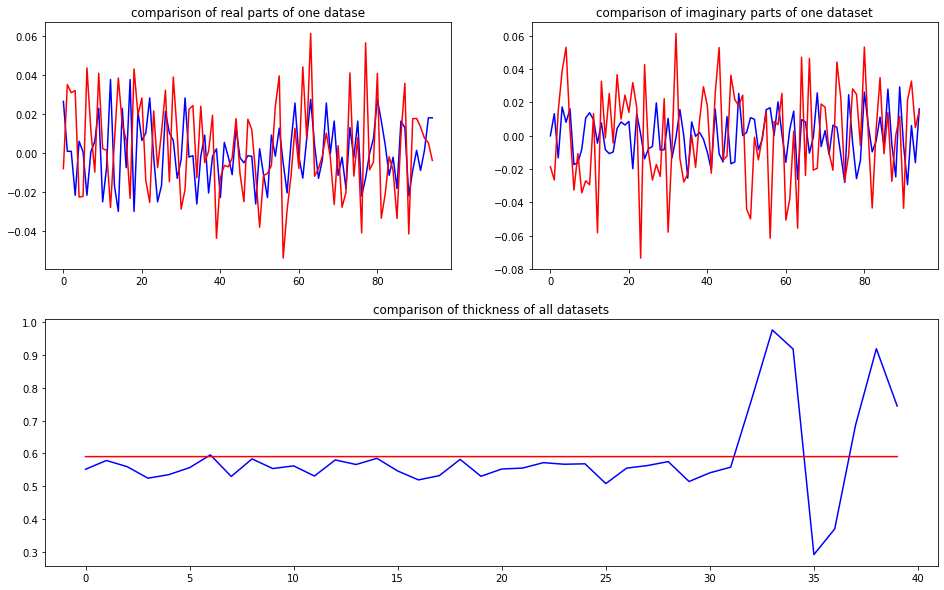

predicted thickness: 0.5903749


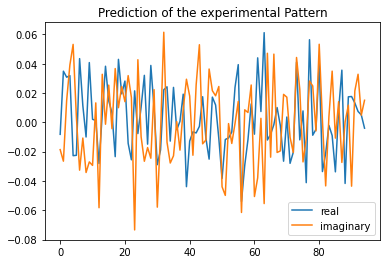

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=590.3748869895935
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00819491+0.j          0.03283173-0.02067255j  0.03283173+0.02067255j
  0.03765848+0.03588443j -0.01638431+0.04370556j -0.00555126+0.00733526j
  0.03765848-0.03588443j -0.00555126-0.00

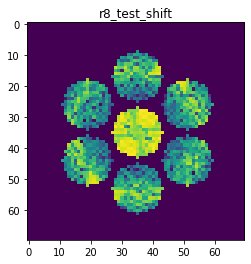

X_sim.max(): 0.8409202889358498
nlogf_X_sim.max(): 6.735685341038692
>>>replaced the 33. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 478ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 302ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 287ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000


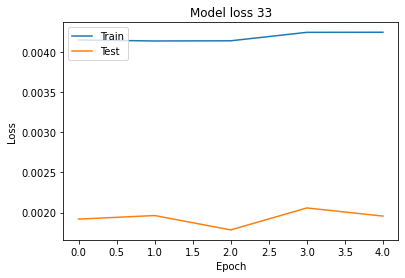

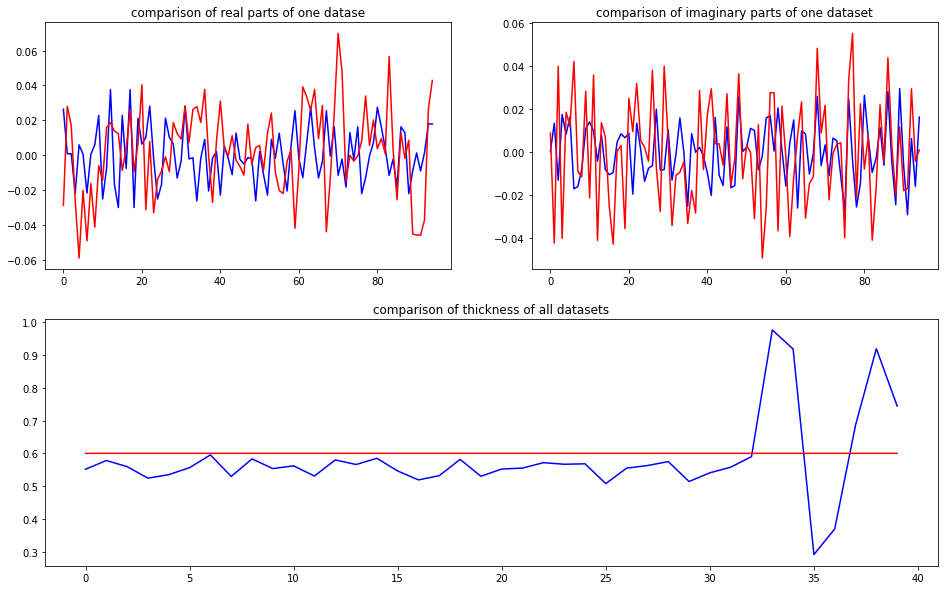

predicted thickness: 0.60025305


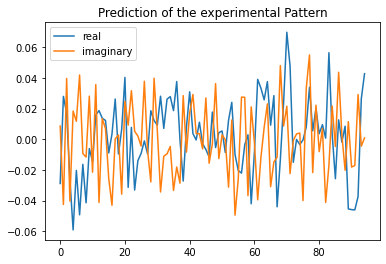

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=600.2530455589294
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.02882732+0.j          0.02249331-0.04109753j  0.02249331+0.04109753j
 -0.03756806-0.04116281j -0.05029325+0.015005j   -0.01832805+0.01049739j
 -0.03756806+0.04116281j -0.01832805-0.01

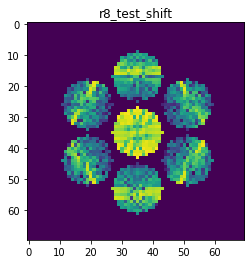

X_sim.max(): 0.9393932481164506
nlogf_X_sim.max(): 6.846298136840534
>>>replaced the 34. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 422ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 264ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 277ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


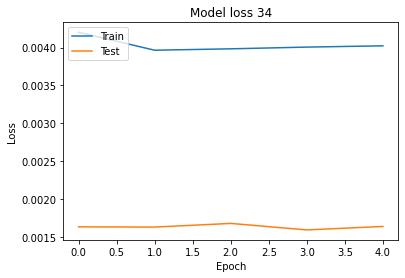

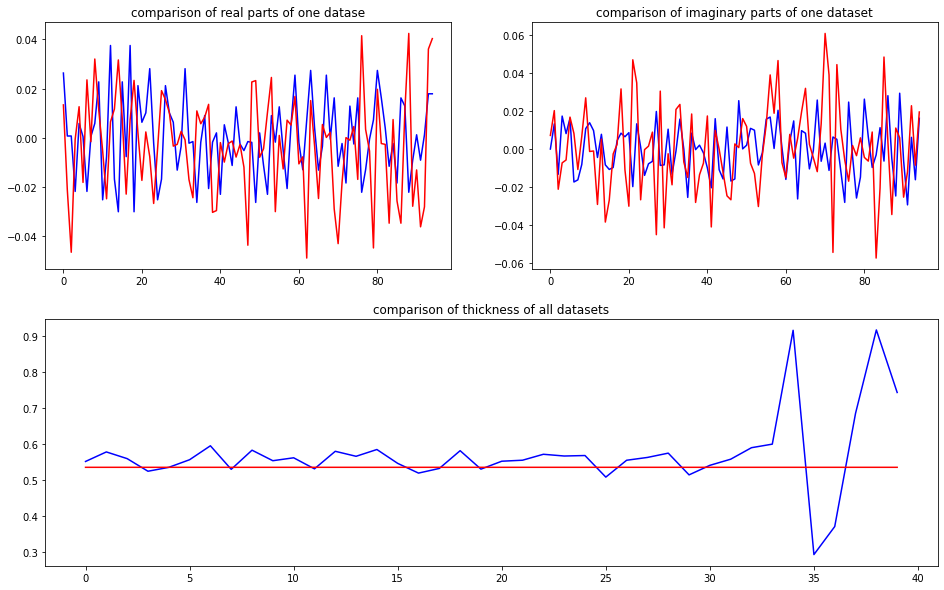

predicted thickness: 0.53575104


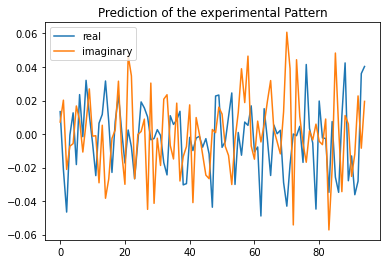

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=535.7510447502136
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01335666+0.j         -0.03394563+0.02066501j -0.03394563-0.02066501j
  0.01142962-0.00771846j  0.02233501-0.00620001j -0.00992219+0.01375683j
  0.01142962+0.00771846j -0.00992219-0.01

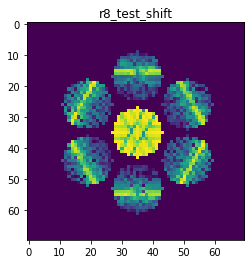

X_sim.max(): 0.9699526205098054
nlogf_X_sim.max(): 6.878277672569221
>>>replaced the 35. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 456ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 296ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 315ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 295ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 286ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


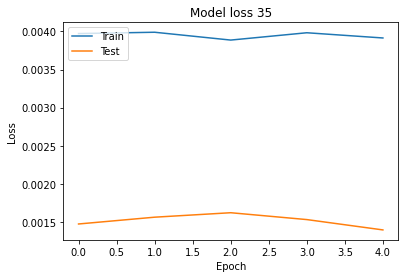

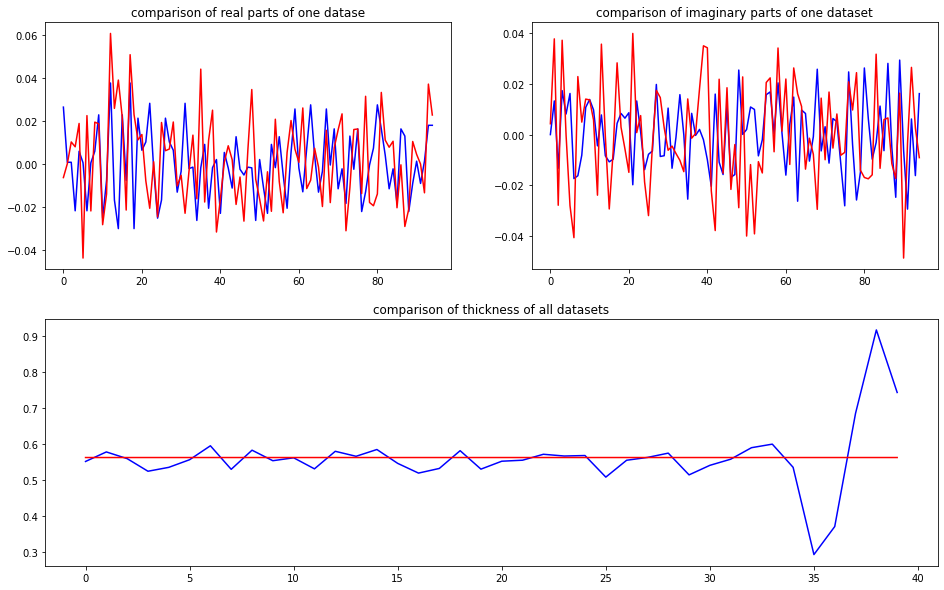

predicted thickness: 0.5629729


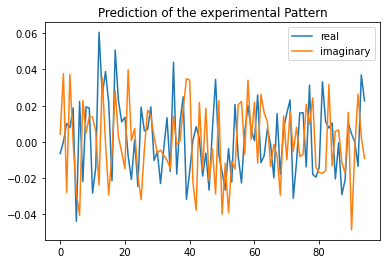

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=562.972903251648
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00640501+0.j          0.00507377+0.03275454j  0.00507377-0.03275454j
  0.01511087+0.03885511j  0.01905426-0.00256742j -0.03288679-0.02539507j
  0.01511087-0.03885511j -0.03288679+0.025

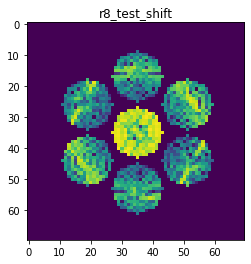

X_sim.max(): 0.9359683730887732
nlogf_X_sim.max(): 6.84264952829499
>>>replaced the 36. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 453ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 291ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 302ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 281ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 286ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


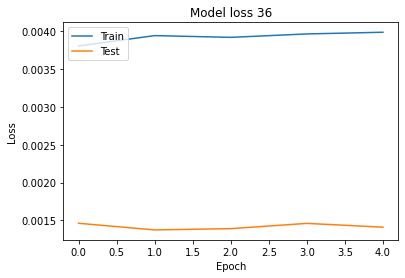

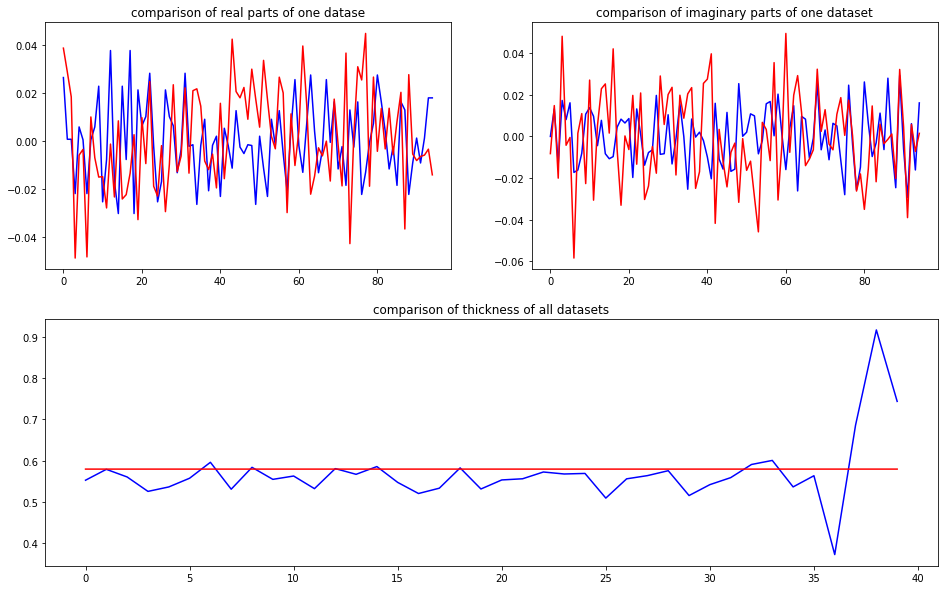

predicted thickness: 0.57908434


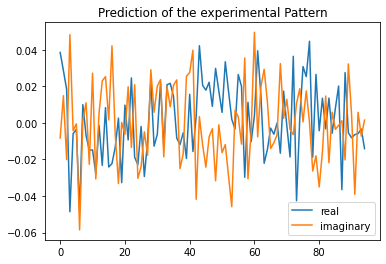

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=579.0843367576599
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03852011+0.j          0.02346826+0.01746869j  0.02346826-0.01746869j
 -0.04838292+0.05336964j -0.00640897-0.00761306j  0.0032098 -0.00101176j
 -0.04838292-0.05336964j  0.0032098 +0.00

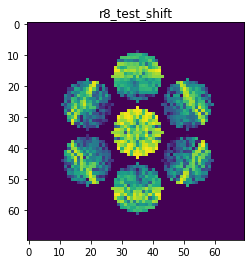

X_sim.max(): 0.9479611500271335
nlogf_X_sim.max(): 6.855367859971251
>>>replaced the 37. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 434ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 263ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 266ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


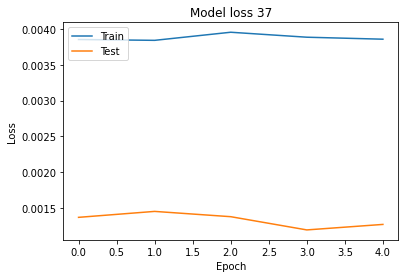

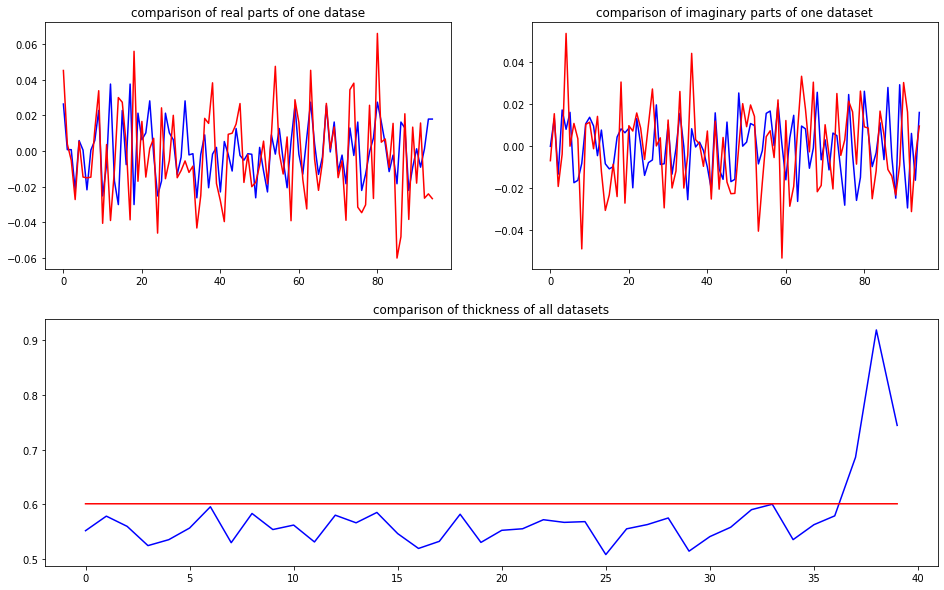

predicted thickness: 0.6010881


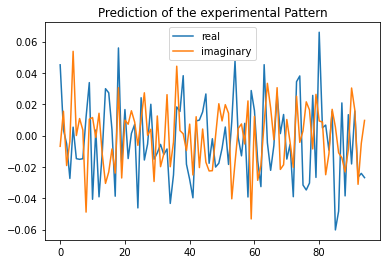

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=601.0881066322327
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.04515747+0.j         -0.00070043+0.01732289j -0.00070043-0.01732289j
 -0.02123107-0.00729378j  0.00859281+0.05129251j -0.0147194 -0.00177447j
 -0.02123107+0.00729378j -0.0147194 +0.00

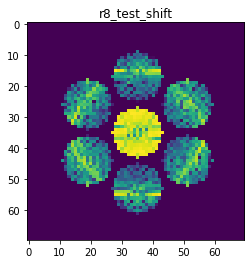

X_sim.max(): 0.9214968297495881
nlogf_X_sim.max(): 6.827083939322965
>>>replaced the 38. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 440ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 269ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 267ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 265ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


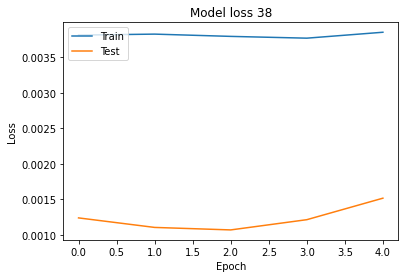

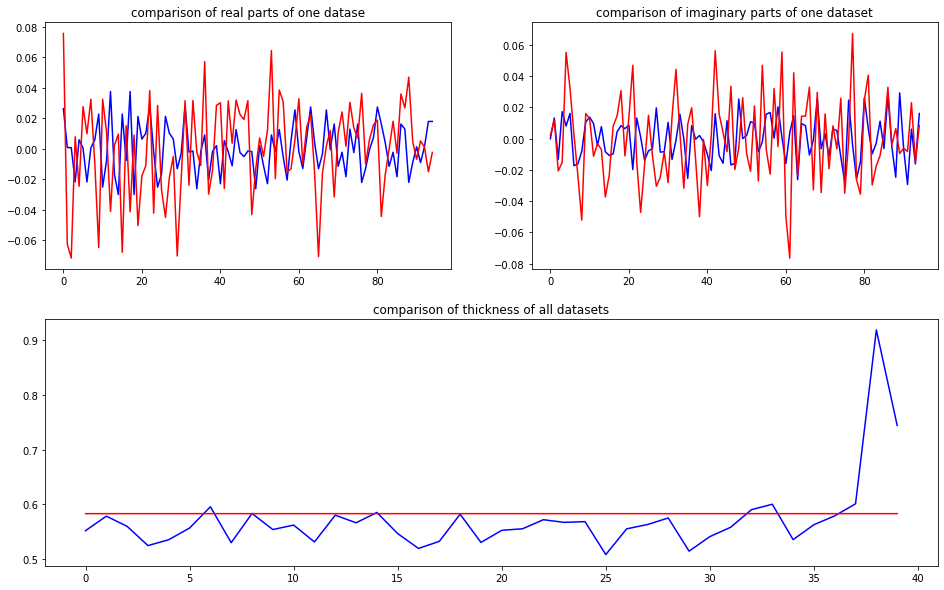

predicted thickness: 0.58308923


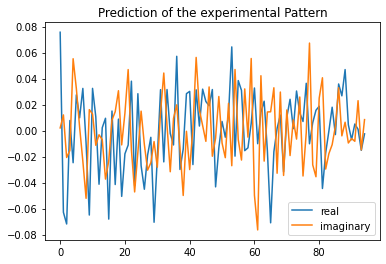

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=583.0892324447632
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.07568935+0.j         -0.06733459+0.01637963j -0.06733459-0.01637963j
  0.00880491-0.00903012j -0.01709748+0.05369978j  0.02999119+0.02786513j
  0.00880491+0.00903012j  0.02999119-0.02

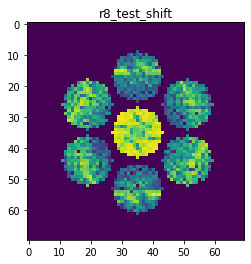

X_sim.max(): 0.9826672135551302
nlogf_X_sim.max(): 6.89128764224397
>>>replaced the 39. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 498ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 291ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 8.9469e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 303ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 301ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 312ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


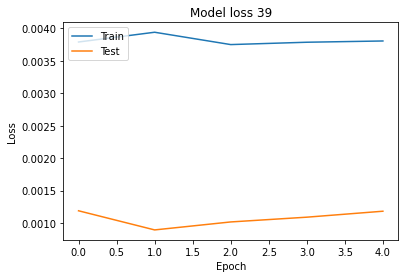

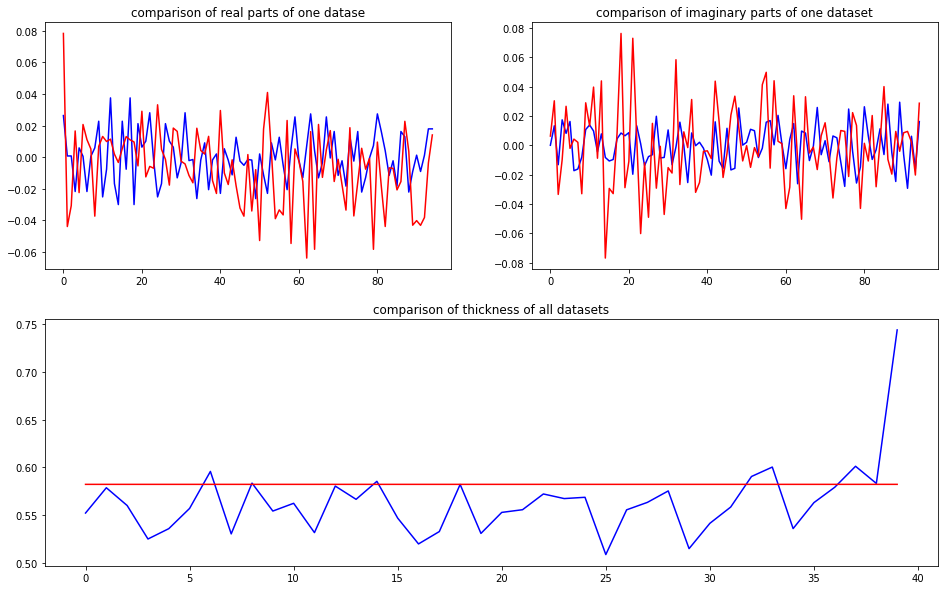

predicted thickness: 0.5821058


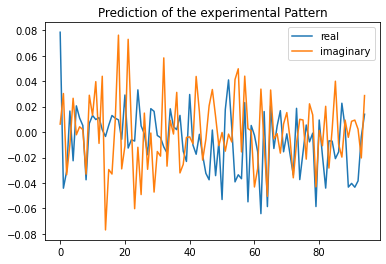

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=582.105815410614
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.07839651+0.j         -0.0374339 +0.03188769j -0.0374339 -0.03188769j
  0.01379432-0.00704592j -0.02998618+0.02978269j  0.01286974-0.00203948j
  0.01379432+0.00704592j  0.01286974+0.002

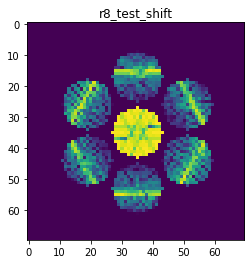

X_sim.max(): 0.982881959988811
nlogf_X_sim.max(): 6.8915059304955895
>>>replaced the 40. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 449ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 8.8653e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 8.8475e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 277ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 279ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 269ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 9.4421e-04 - val_acc: 1.0000


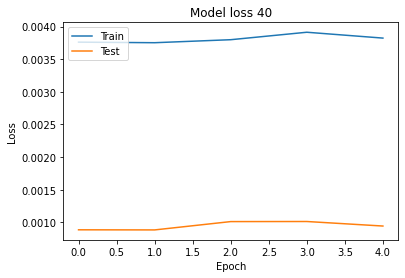

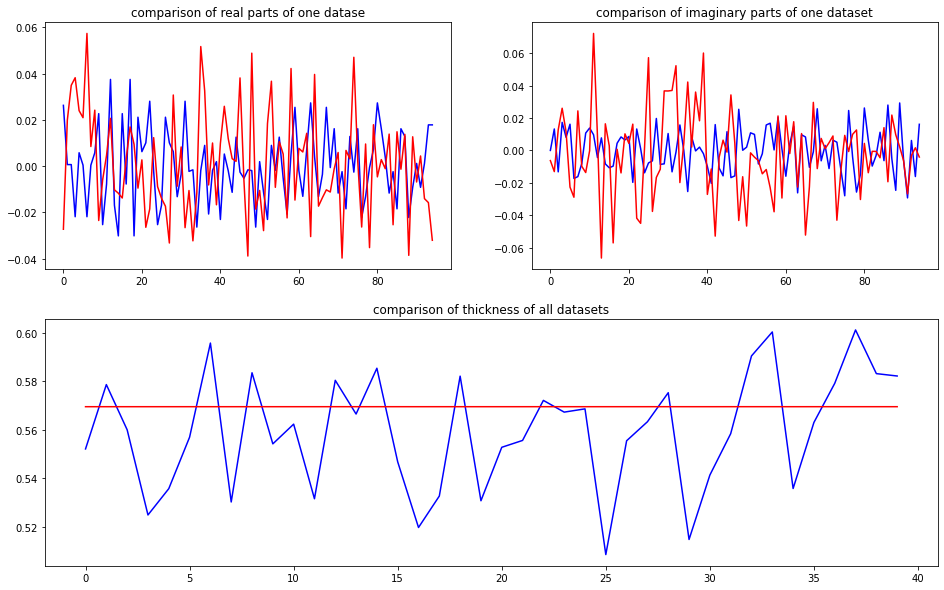

predicted thickness: 0.56943274


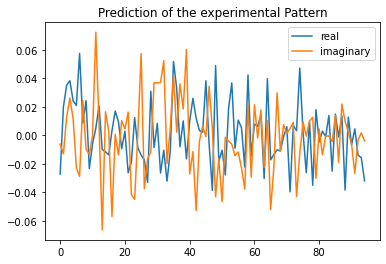

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=569.4327354431152
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.02724581+0.j          0.02744809-0.01290929j  0.02744809+0.01290929j
  0.0478246 +0.02749376j  0.02414234+0.01065084j  0.01472096-0.02353204j
  0.0478246 -0.02749376j  0.01472096+0.02

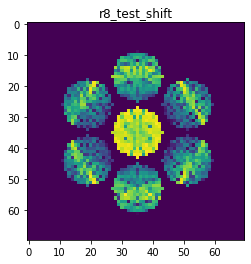

X_sim.max(): 0.9433772389297174
nlogf_X_sim.max(): 6.850525703829983
>>>replaced the 41. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 438ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 9.9140e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 9.4573e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 8.9736e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 9.0582e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 8.2989e-04 - val_acc: 1.0000


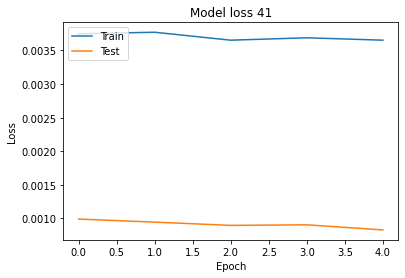

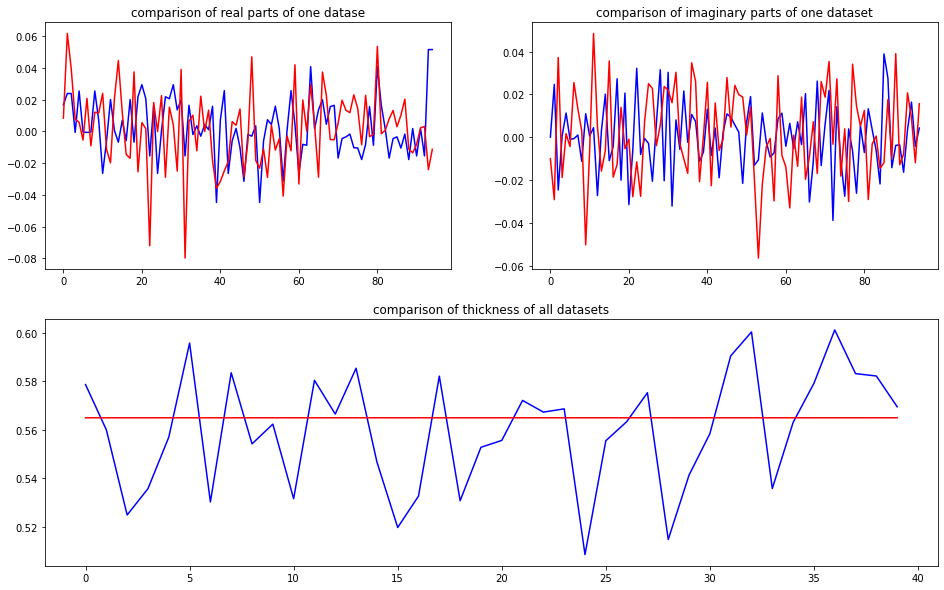

predicted thickness: 0.5648621


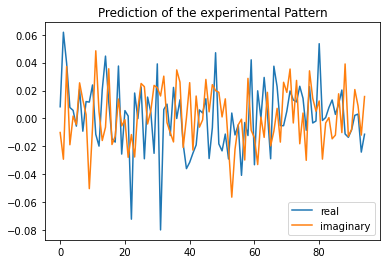

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=564.862072467804
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00835926+0.j          0.0505828 -0.03320645j  0.0505828 +0.03320645j
  0.0143108 -0.02217897j  0.00891043-0.00056913j -0.00733507-0.00883772j
  0.0143108 +0.02217897j -0.00733507+0.008

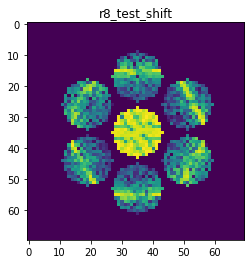

X_sim.max(): 0.9597830726209974
nlogf_X_sim.max(): 6.867748652605784
>>>replaced the 42. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 434ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 8.7203e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 7.8715e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 8.0967e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 8.4297e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 279ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 8.5888e-04 - val_acc: 1.0000


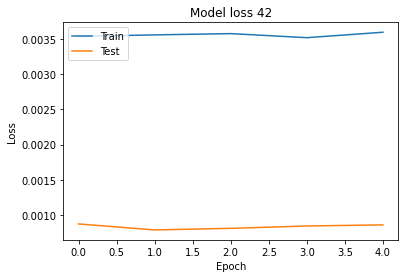

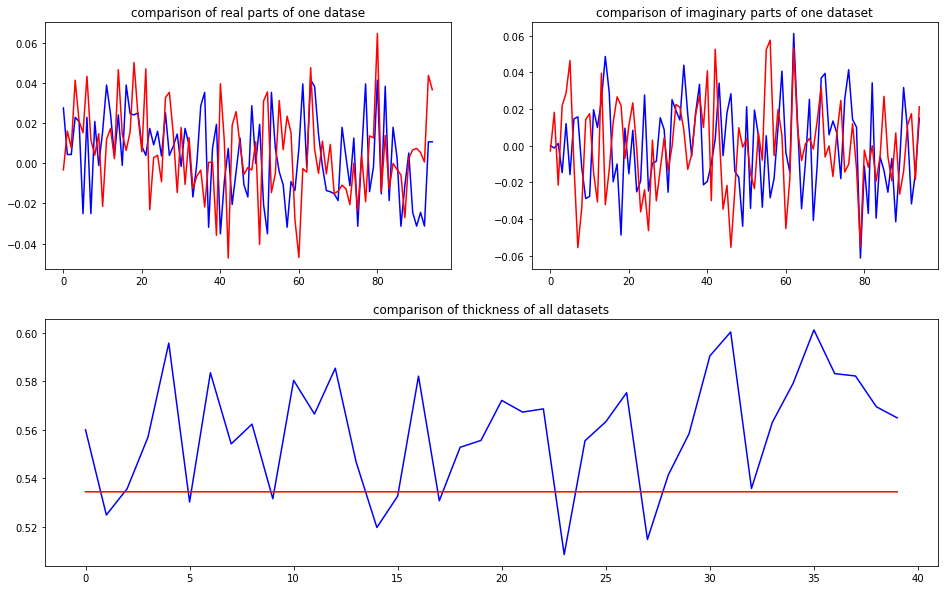

predicted thickness: 0.53435826


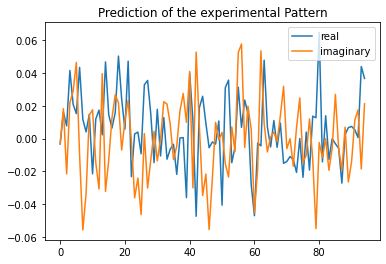

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=534.3582630157471
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00327101+0.j          0.01191106+0.01984808j  0.01191106-0.01984808j
  0.04236547+0.01597722j  0.01249416+0.03116632j  0.0134504 +0.05097109j
  0.04236547-0.01597722j  0.0134504 -0.05

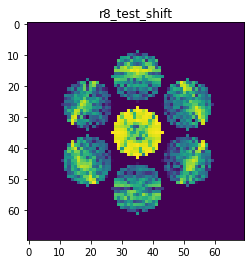

X_sim.max(): 0.9542996174240076
nlogf_X_sim.max(): 6.862025026798554
>>>replaced the 43. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 415ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 9.1267e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 257ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 8.6708e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 251ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 8.3840e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 254ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 7.8691e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 257ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 7.3113e-04 - val_acc: 1.0000


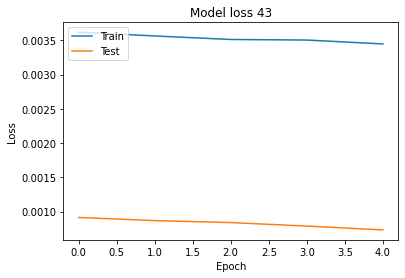

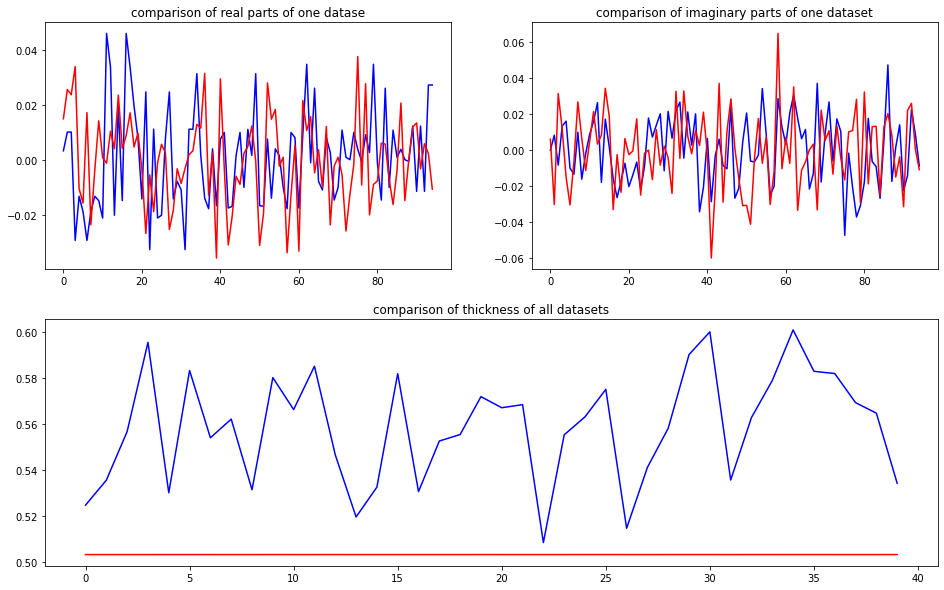

predicted thickness: 0.50328016


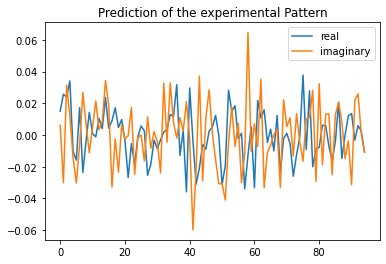

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=503.2801628112793
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01505171+0.j          0.02476703-0.03077403j  0.02476703+0.03077403j
  0.02568329+0.00917746j -0.00707897-0.01067745j -0.01977651-0.0285969j
  0.02568329-0.00917746j -0.01977651+0.028

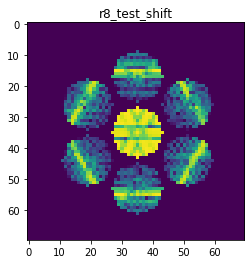

X_sim.max(): 0.9806562414361999
nlogf_X_sim.max(): 6.889241187432018
>>>replaced the 44. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 438ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 6.8029e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 281ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 8.8932e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 283ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 8.0736e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 281ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 9.7494e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 280ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 8.9299e-04 - val_acc: 1.0000


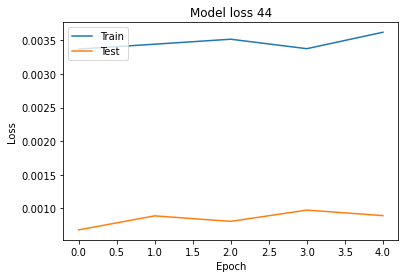

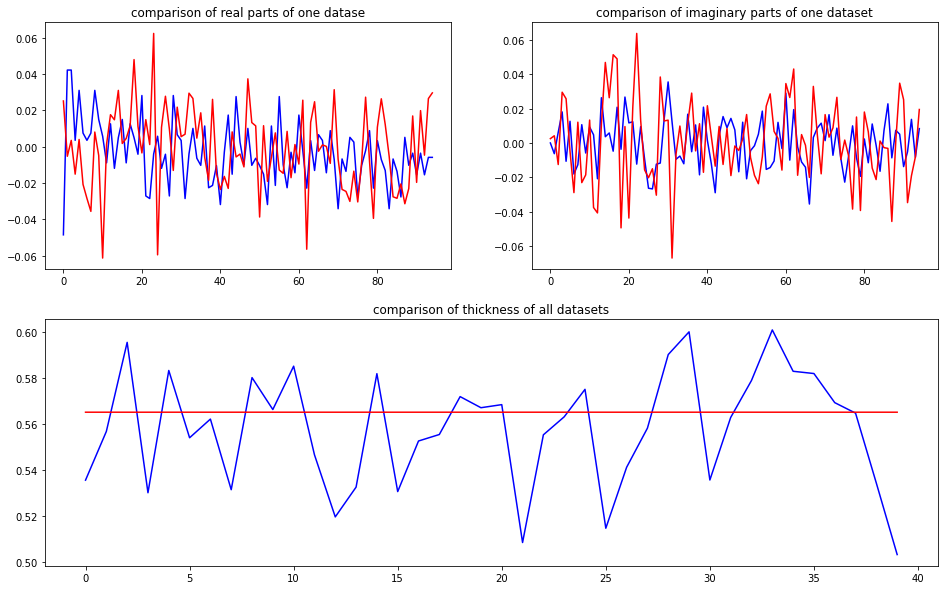

predicted thickness: 0.56524754


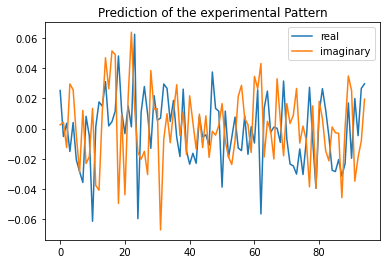

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.2475357055664
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02519943+0.j         -0.00085724+0.00836155j -0.00085724-0.00836155j
 -0.02174432+0.02919595j  0.00607466+0.02439384j -0.02813769-0.00844701j
 -0.02174432-0.02919595j -0.02813769+0.00

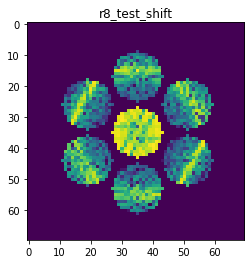

X_sim.max(): 0.9423871165831579
nlogf_X_sim.max(): 6.849476714389685
>>>replaced the 45. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 494ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 289ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 9.5450e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 274ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 7.9563e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 8.0847e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 9.2813e-04 - val_acc: 1.0000


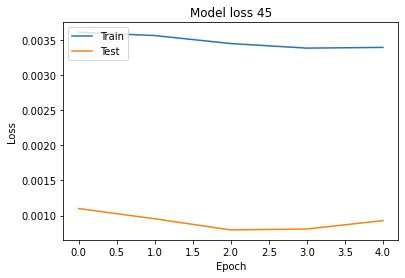

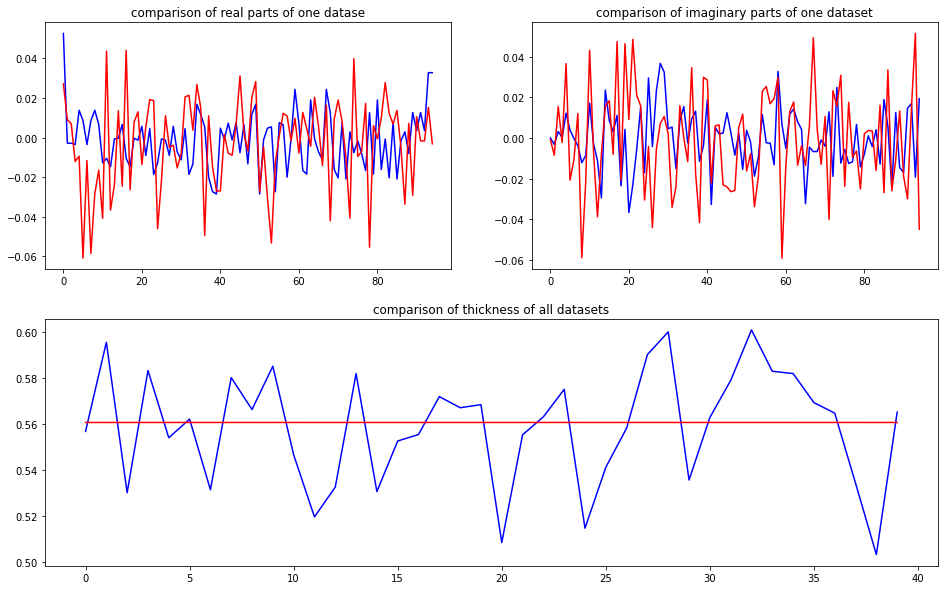

predicted thickness: 0.5607821


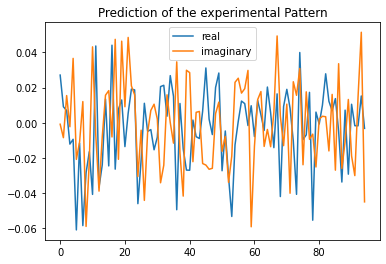

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=560.7820749282837
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 2.71264259e-02+0.j          8.02733097e-03-0.01198108j
  8.02733097e-03+0.01198108j -1.18864598e-02+0.00430515j
 -1.89384683e-02+0.04780647j -5.97453862e-02-0.01644101j
 -1.18864598e-02

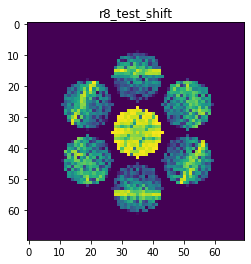

X_sim.max(): 0.9652745962748991
nlogf_X_sim.max(): 6.873448054972111
>>>replaced the 46. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 425ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 267ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 8.2883e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 280ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 8.1491e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 8.7025e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 269ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 8.2744e-04 - val_acc: 1.0000


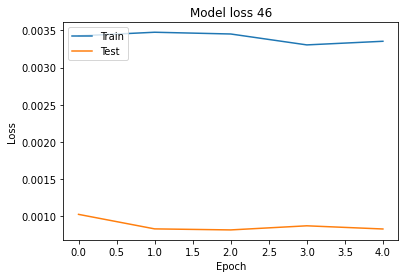

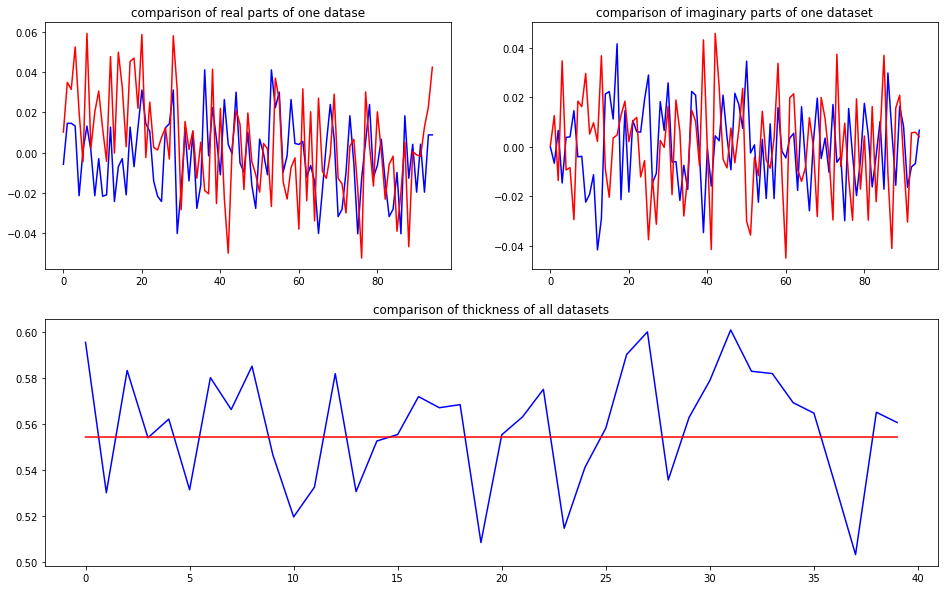

predicted thickness: 0.55444705


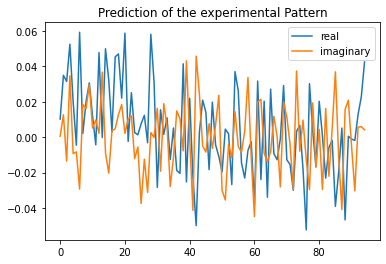

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=554.4470548629761
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01021188+0.j          0.03320887+0.01310048j  0.03320887-0.01310048j
  0.05591089+0.03202392j  0.02016893-0.01277429j -0.00126039-0.01340174j
  0.05591089-0.03202392j -0.00126039+0.01

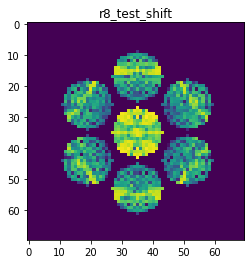

X_sim.max(): 0.9601795867106222
nlogf_X_sim.max(): 6.8681612663403175
>>>replaced the 47. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 439ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 8.3313e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 268ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 261ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 8.7752e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 263ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


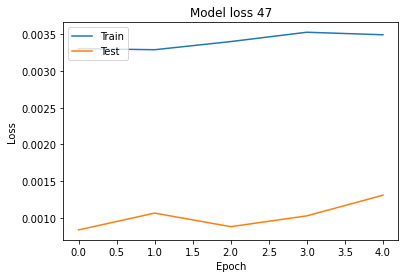

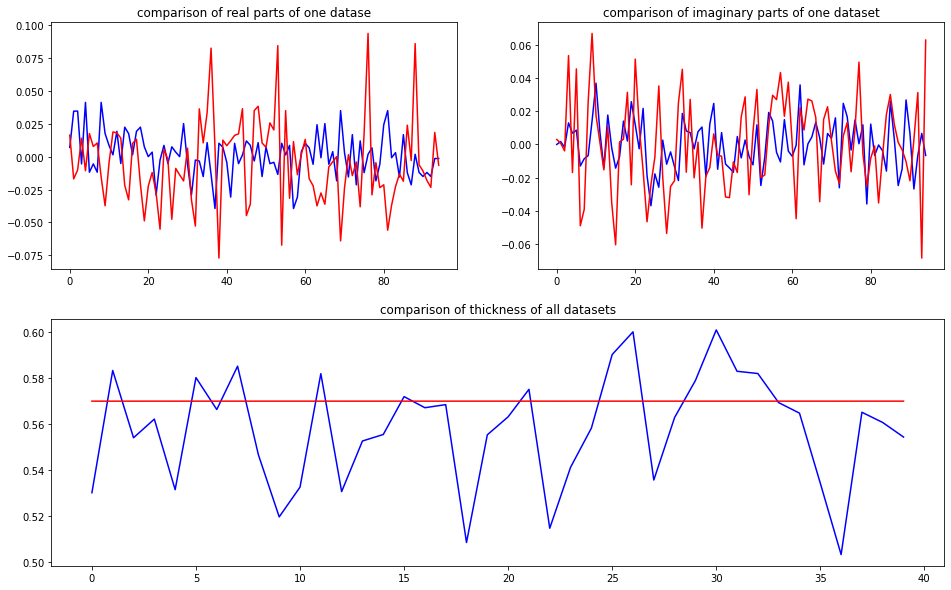

predicted thickness: 0.5700607


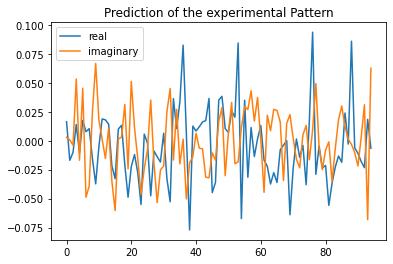

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=570.060670375824
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01640829+0.j         -0.01348875+0.00229851j -0.01348875-0.00229851j
  0.01091038+0.05112271j -0.01307524-0.02113548j  0.01399733+0.04220347j
  0.01091038-0.05112271j  0.01399733-0.042

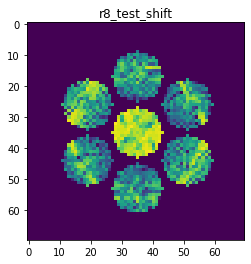

X_sim.max(): 0.9631455674315549
nlogf_X_sim.max(): 6.87124228677036
>>>replaced the 48. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 422ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 9.7597e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 264ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 255ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 9.6964e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 263ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 267ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 8.9564e-04 - val_acc: 1.0000


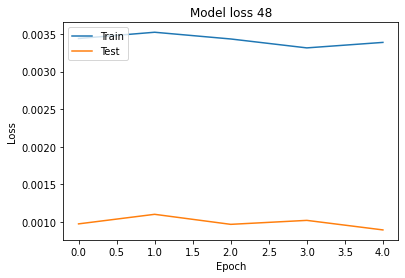

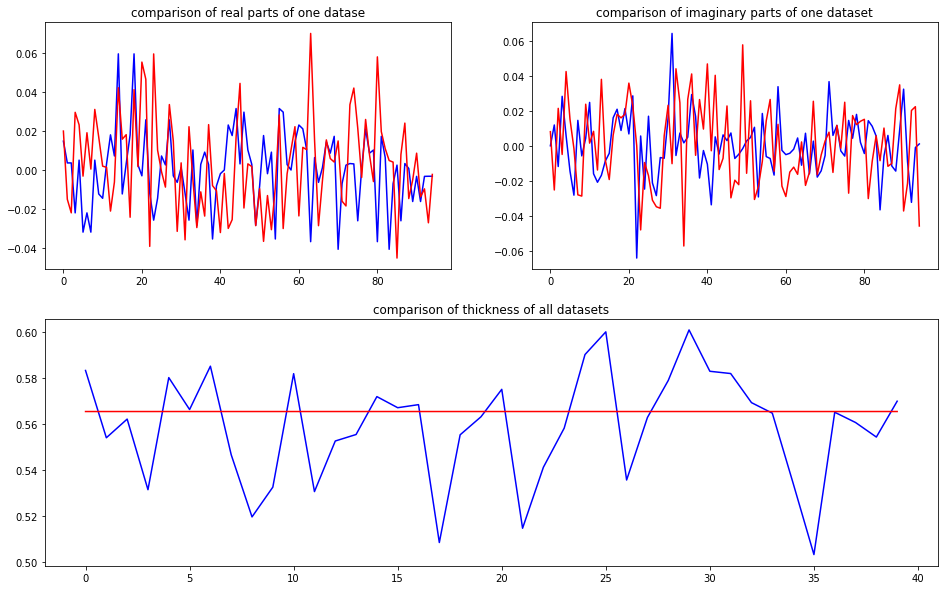

predicted thickness: 0.56553996


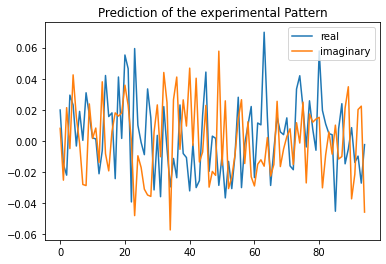

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.5399560928345
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01982714+0.j         -0.01861944-0.02332249j -0.01861944+0.02332249j
  0.02418786-0.00169482j  0.02698483+0.03560375j -0.00150146+0.02159338j
  0.02418786+0.00169482j -0.00150146-0.02

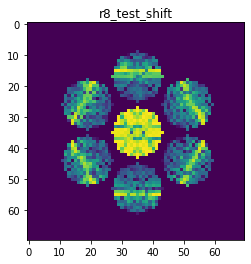

X_sim.max(): 0.9803560380057942
nlogf_X_sim.max(): 6.888935327467829
>>>replaced the 49. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 436ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 269ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 9.1832e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 267ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 9.1379e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 9.3334e-04 - val_acc: 1.0000


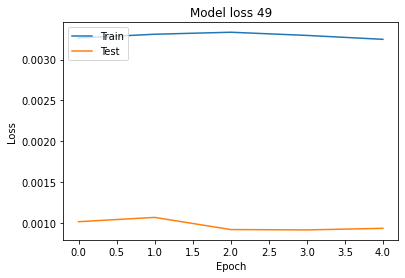

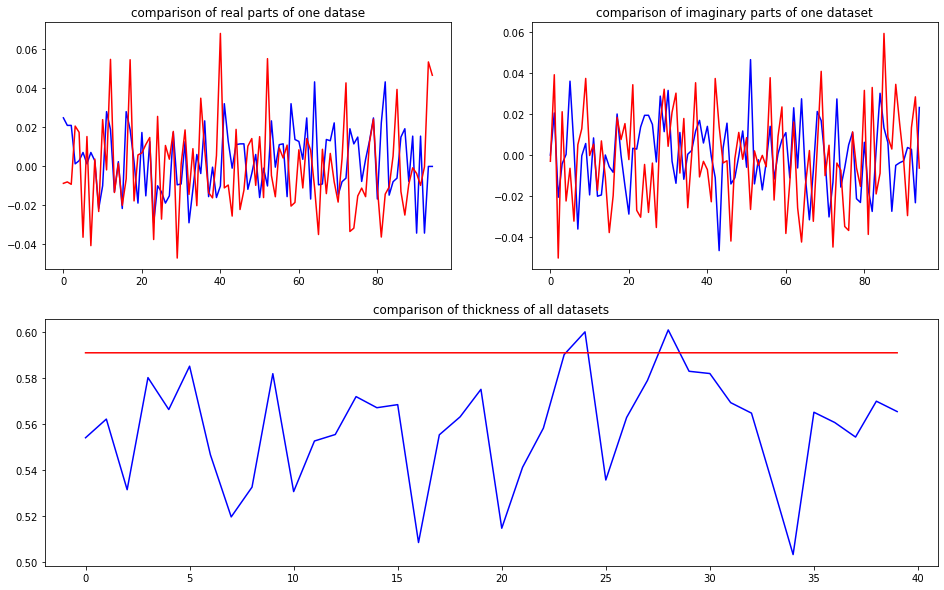

predicted thickness: 0.5911099


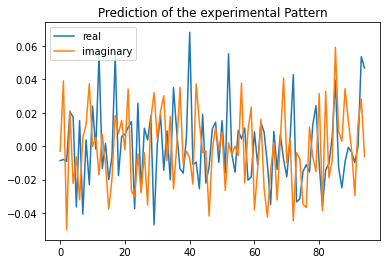

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=591.1098718643188
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.0086531 +0.j         -0.00854489+0.0446156j  -0.00854489-0.0446156j
  0.01800857+0.02663387j  0.01065451-0.01758622j -0.03847837-0.00573679j
  0.01800857-0.02663387j -0.03847837+0.005

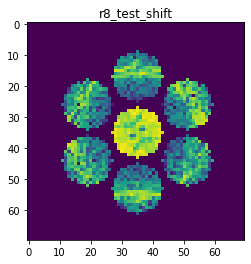

X_sim.max(): 0.9671149100905606
nlogf_X_sim.max(): 6.875350789002488
>>>replaced the 50. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 433ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 9.7311e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 262ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 7.9319e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 264ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 9.6101e-04 - val_acc: 1.0000


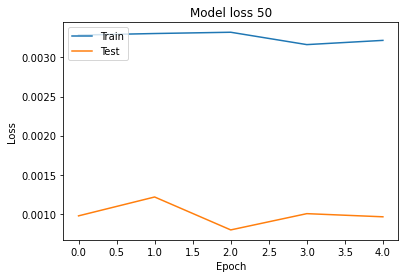

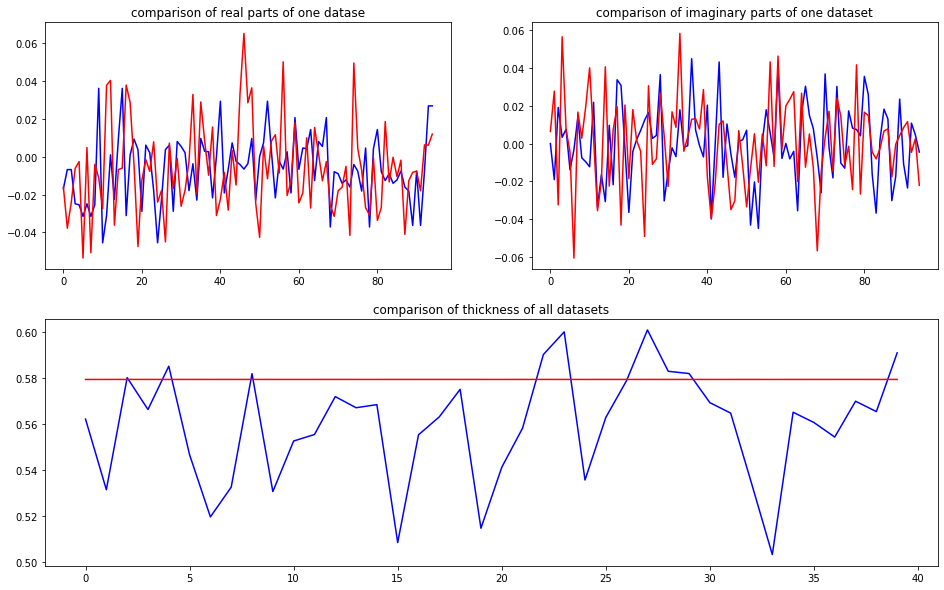

predicted thickness: 0.5795054


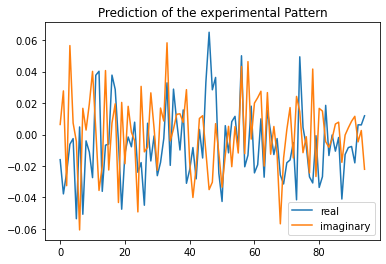

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=579.5053839683533
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01601044+0.j         -0.03100092+0.03015163j -0.03100092-0.03015163j
 -0.00071111+0.0586499j  -0.00332653+0.00224069j -0.05216955-0.01052077j
 -0.00071111-0.0586499j  -0.05216955+0.01

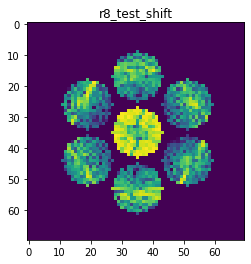

X_sim.max(): 0.9335974481445373
nlogf_X_sim.max(): 6.840115899837322
>>>replaced the 51. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 503ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 9.9415e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 296ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 9.1179e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 8.6197e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 279ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 8.8111e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 284ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 8.9285e-04 - val_acc: 1.0000


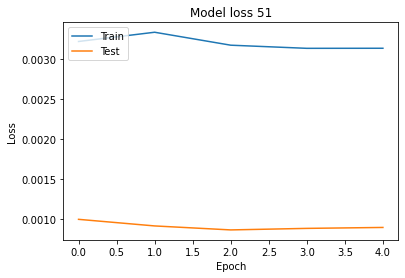

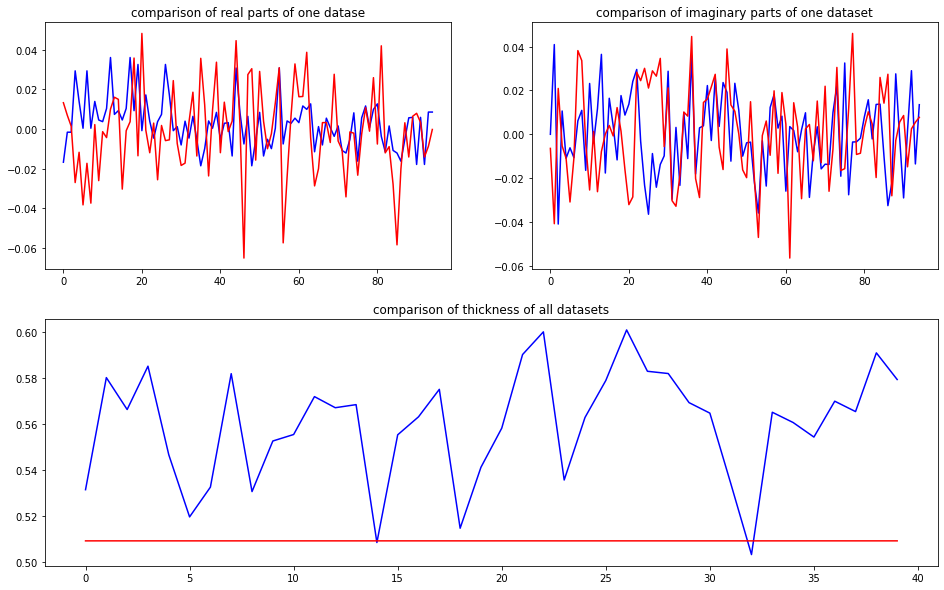

predicted thickness: 0.50921845


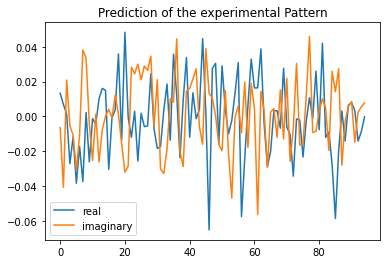

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=509.2184543609619
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.0133163 +0.j          0.00413434-0.03083582j  0.00413434+0.03083582j
 -0.02224319+0.00274491j -0.00476312-0.02225243j -0.03798664-0.03451313j
 -0.02224319-0.00274491j -0.03798664+0.03

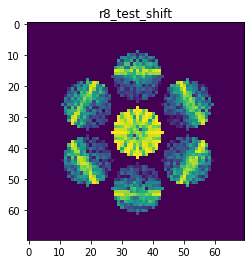

X_sim.max(): 0.9663676039752277
nlogf_X_sim.max(): 6.874578572103562
>>>replaced the 52. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 424ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 9.1296e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 8.2668e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 265ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 7.9012e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 264ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 8.7980e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 260ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 9.5271e-04 - val_acc: 1.0000


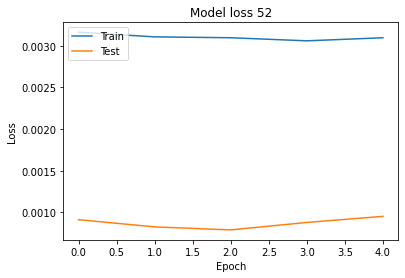

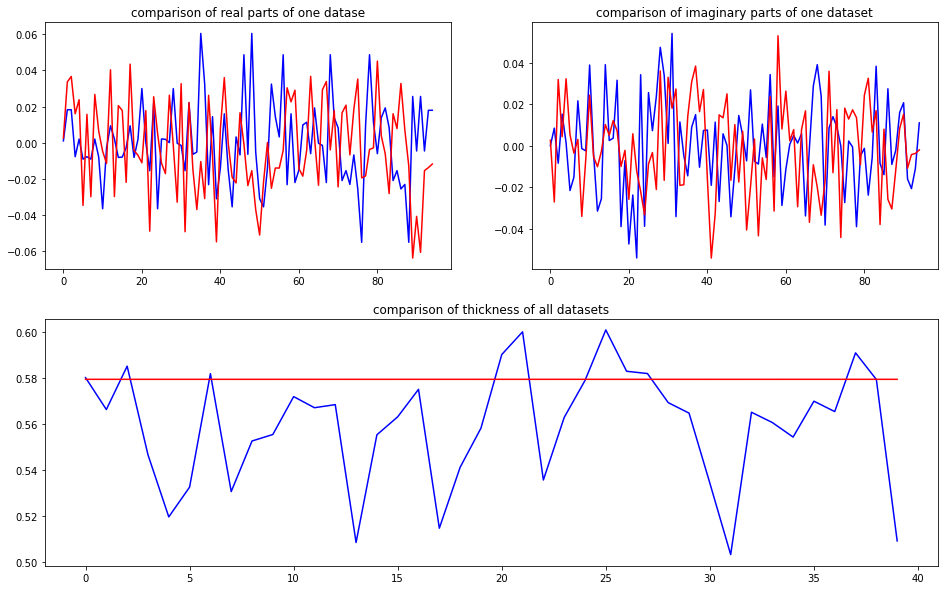

predicted thickness: 0.57955897


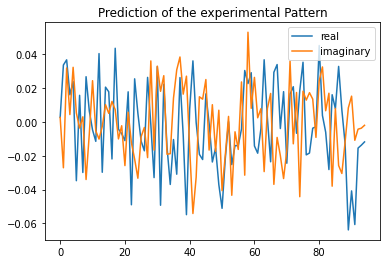

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=579.5589685440063
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00267726+0.j          0.03510633-0.02946874j  0.03510633+0.02946874j
  0.01583748+0.00397572j  0.02523173+0.03313158j -0.03232195+0.00113252j
  0.01583748-0.00397572j -0.03232195-0.00

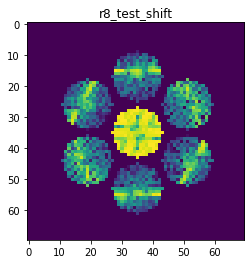

X_sim.max(): 0.9668515849919528
nlogf_X_sim.max(): 6.875078754232361
>>>replaced the 53. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 432ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 8.2525e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 280ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 8.9197e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 278ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 8.1246e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 279ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 8.6506e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 8.5597e-04 - val_acc: 1.0000


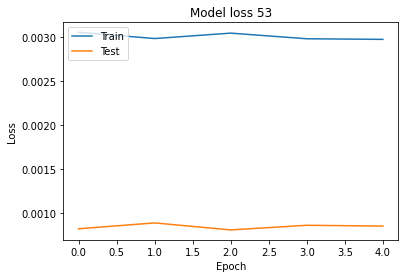

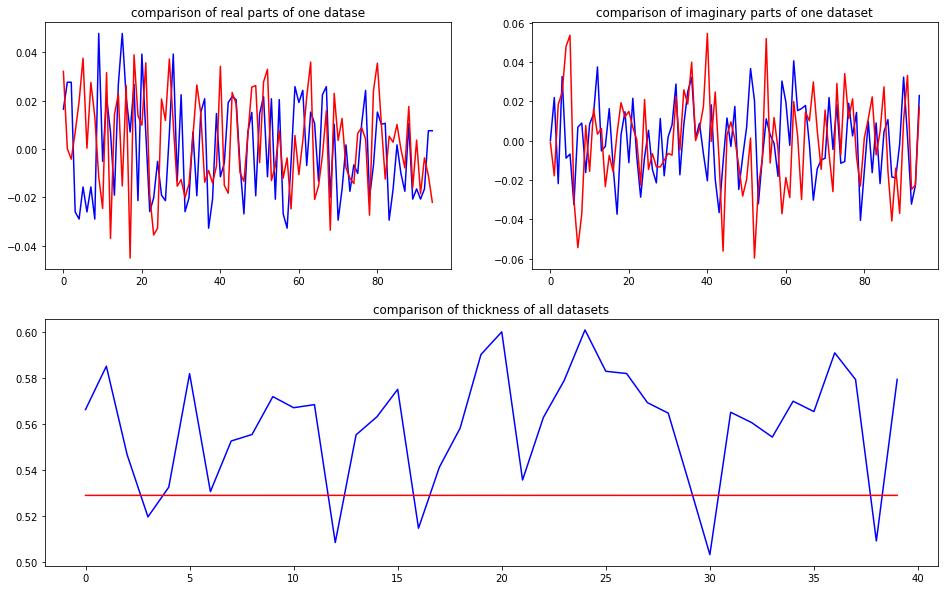

predicted thickness: 0.5290214


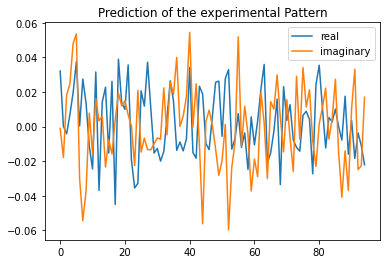

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=529.0213823318481
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 3.20849195e-02+0.j         -2.02546059e-03-0.01812173j
 -2.02546059e-03+0.01812173j  3.60382893e-03+0.02728438j
  1.64984884e-02+0.04259088j  3.24954959e-02+0.0540133j
  3.60382893e-03-

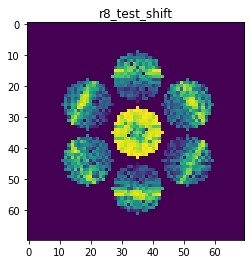

X_sim.max(): 0.9439493144938806
nlogf_X_sim.max(): 6.851131290599099
>>>replaced the 54. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 450ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 8.2592e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 292ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 8.5553e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 283ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 8.4553e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 8.3075e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 292ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 9.1774e-04 - val_acc: 1.0000


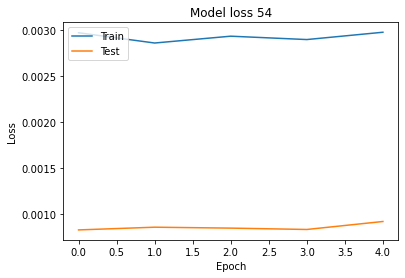

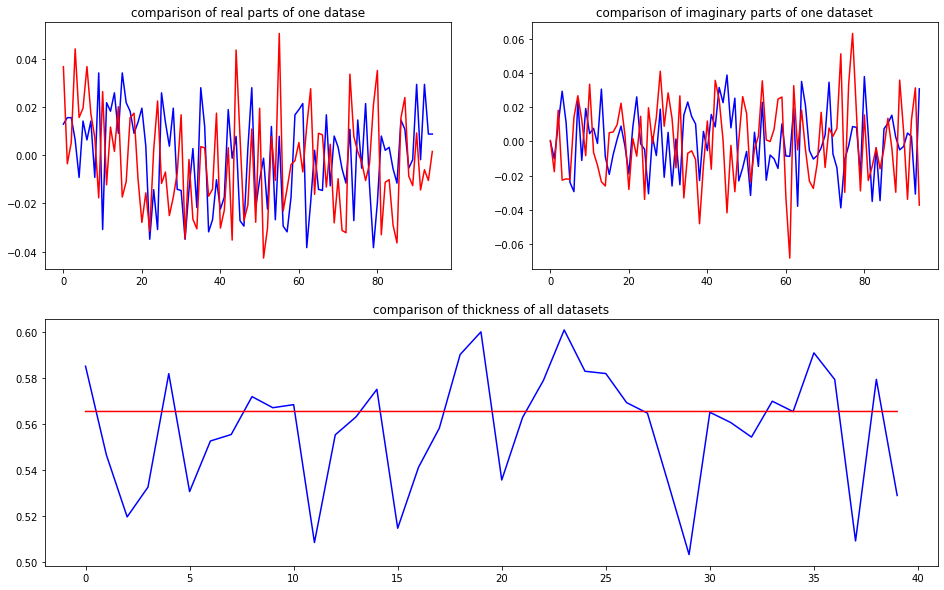

predicted thickness: 0.5655609


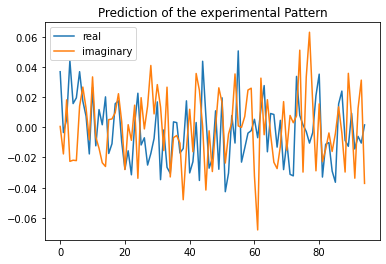

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.5608773231506
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03682944+0.j          0.00090156-0.01791936j  0.00090156+0.01791936j
  0.0405177 -0.01827044j  0.01153732-0.01719629j  0.01842155-0.02436217j
  0.0405177 +0.01827044j  0.01842155+0.02

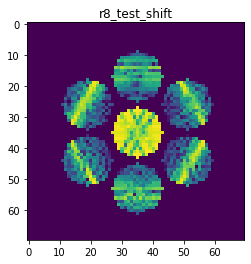

X_sim.max(): 0.9347005384791749
nlogf_X_sim.max(): 6.841295487764415
>>>replaced the 55. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 446ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 8.2841e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 289ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 8.8727e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 9.1408e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 7.9828e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 9.1064e-04 - val_acc: 1.0000


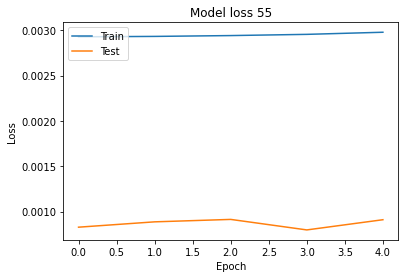

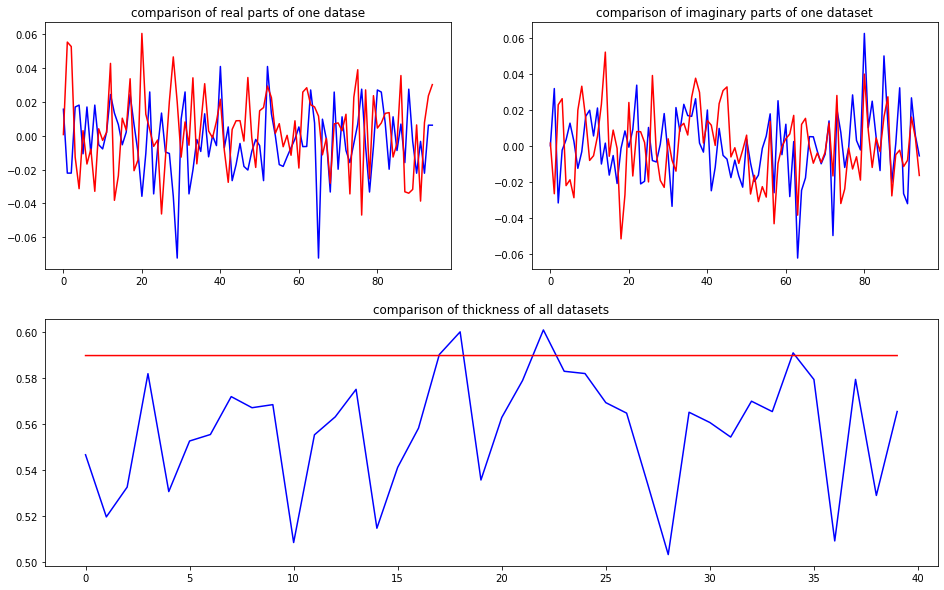

predicted thickness: 0.58990604


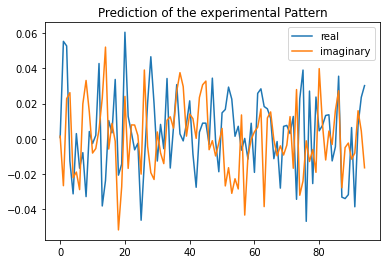

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=589.9060368537903
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 6.75793330e-04+0.j          5.39927948e-02-0.02470564j
  5.39927948e-02+0.02470564j -1.47155272e-02+0.0275303j
 -3.20839770e-02-0.02761269j -2.49673543e-03-0.01934431j
 -1.47155272e-02-

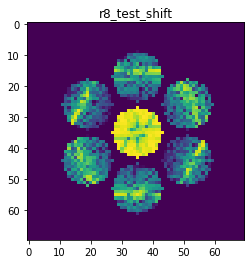

X_sim.max(): 0.9488436056034032
nlogf_X_sim.max(): 6.856297345361663
>>>replaced the 56. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 430ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 9.9450e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 278ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 8.6174e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 264ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 8.5476e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 9.6142e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 277ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 9.1886e-04 - val_acc: 1.0000


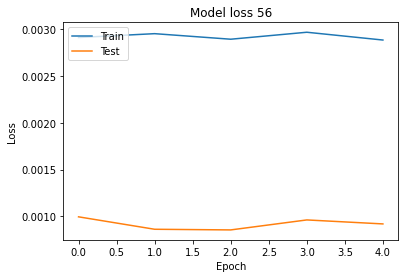

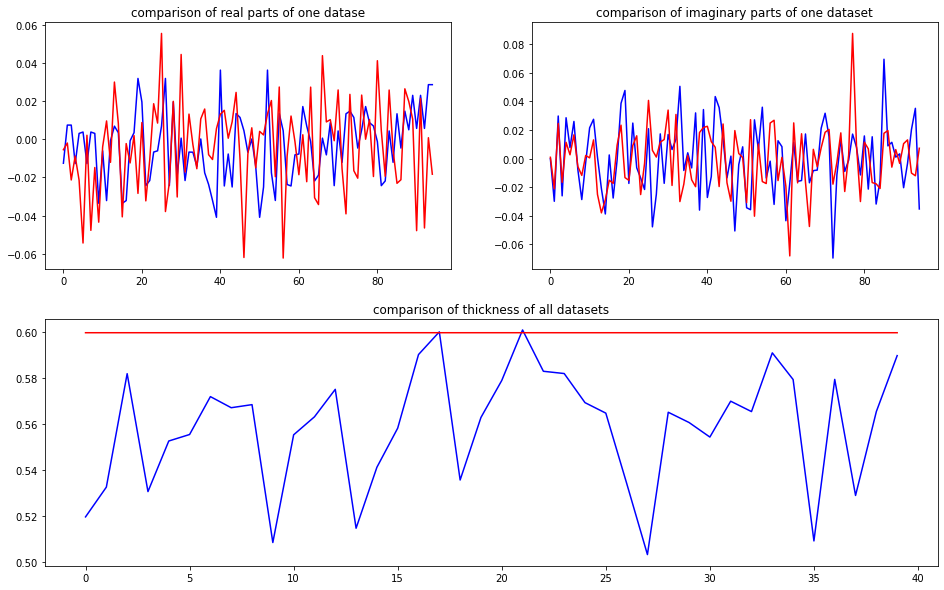

predicted thickness: 0.5998514


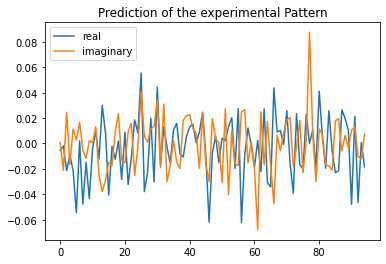

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=599.8514294624329
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00546661+0.j         -0.01163881-0.02282963j -0.01163881+0.02282963j
 -0.00335818-0.01658838j -0.01810389+0.01156307j -0.05104509+0.00409046j
 -0.00335818+0.01658838j -0.05104509-0.00

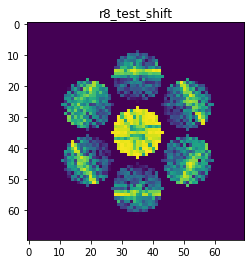

X_sim.max(): 0.9859427371080325
nlogf_X_sim.max(): 6.894612020635968
>>>replaced the 57. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 487ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 9.8868e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 8.9255e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 284ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 7.5035e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 8.3848e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 8.8514e-04 - val_acc: 1.0000


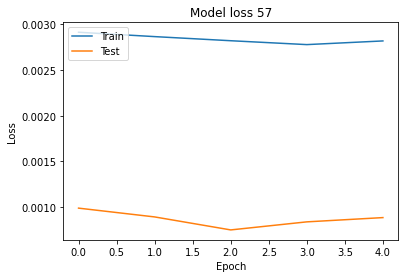

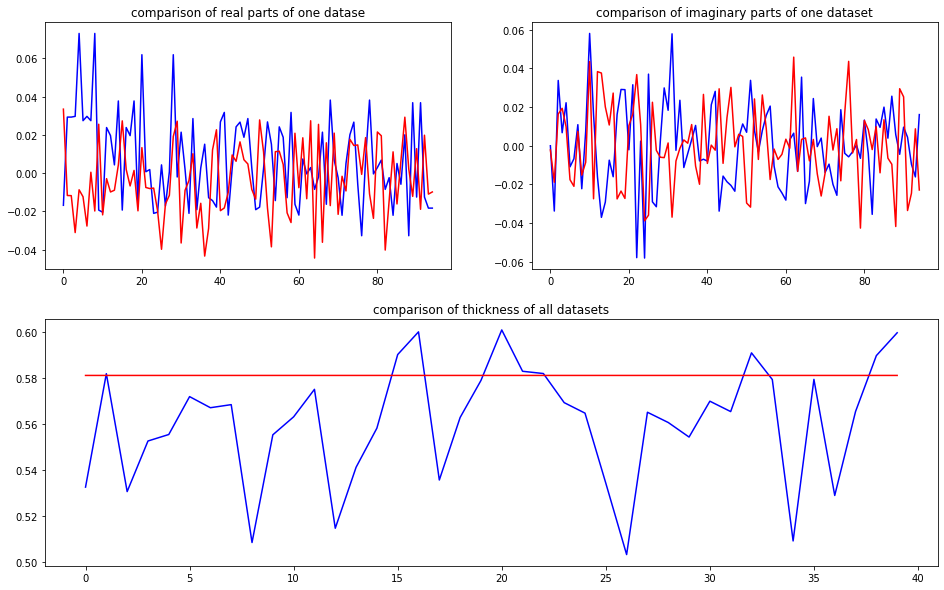

predicted thickness: 0.58125275


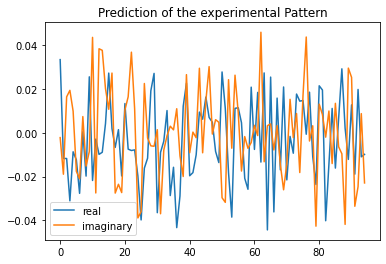

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=581.2527537345886
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03340249+0.j         -0.01171798-0.01766739j -0.01171798+0.01766739j
 -0.02935327+0.02019822j -0.01422512+0.01253748j -0.00594616-0.01249367j
 -0.02935327-0.02019822j -0.00594616+0.01

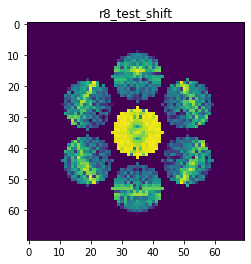

X_sim.max(): 0.9679899306984838
nlogf_X_sim.max(): 6.8762542204007415
>>>replaced the 58. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 425ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 8.4272e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 9.3465e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 263ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 8.9360e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 259ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 8.5535e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 277ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 7.8872e-04 - val_acc: 1.0000


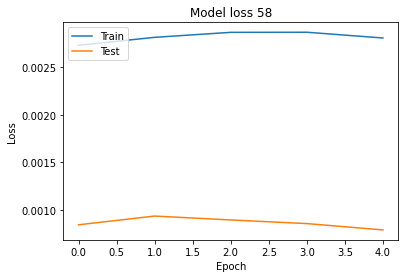

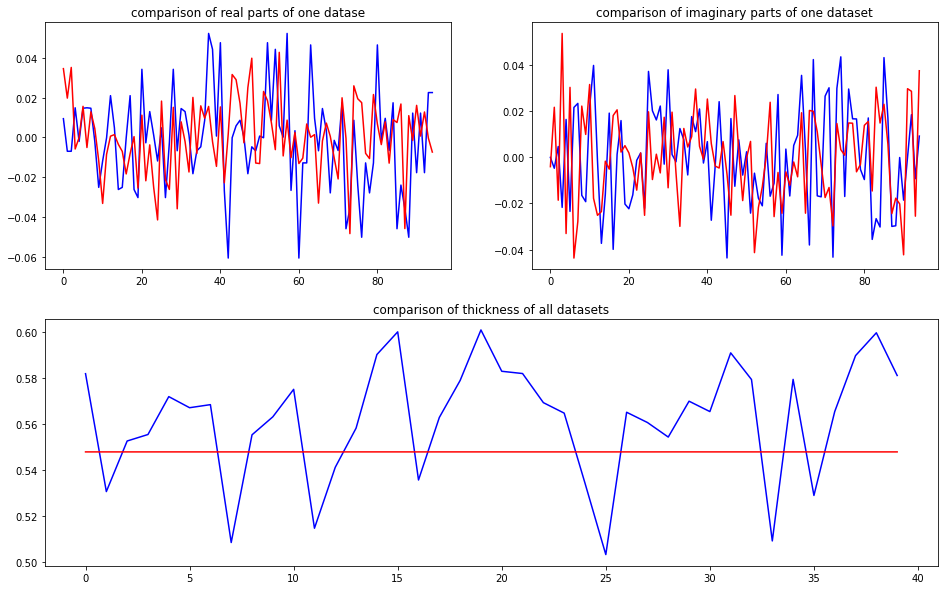

predicted thickness: 0.54795355


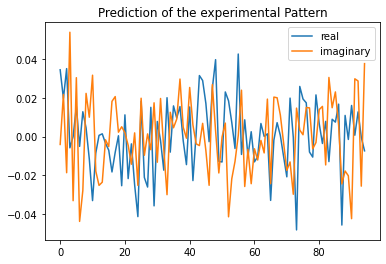

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=547.9535460472107
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.0344538 +0.j          0.02737293+0.02017821j  0.02737293-0.02017821j
 -0.00540497+0.04876199j  0.00222125-0.02765783j  0.01419002+0.02906374j
 -0.00540497-0.04876199j  0.01419002-0.02

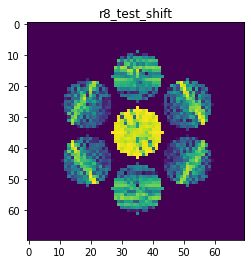

X_sim.max(): 0.9467531140055785
nlogf_X_sim.max(): 6.854094040073535
>>>replaced the 59. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 412ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 8.9431e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 254ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 9.5030e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 262ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 9.1424e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 252ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 9.9714e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 250ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000


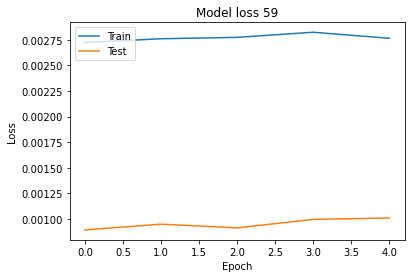

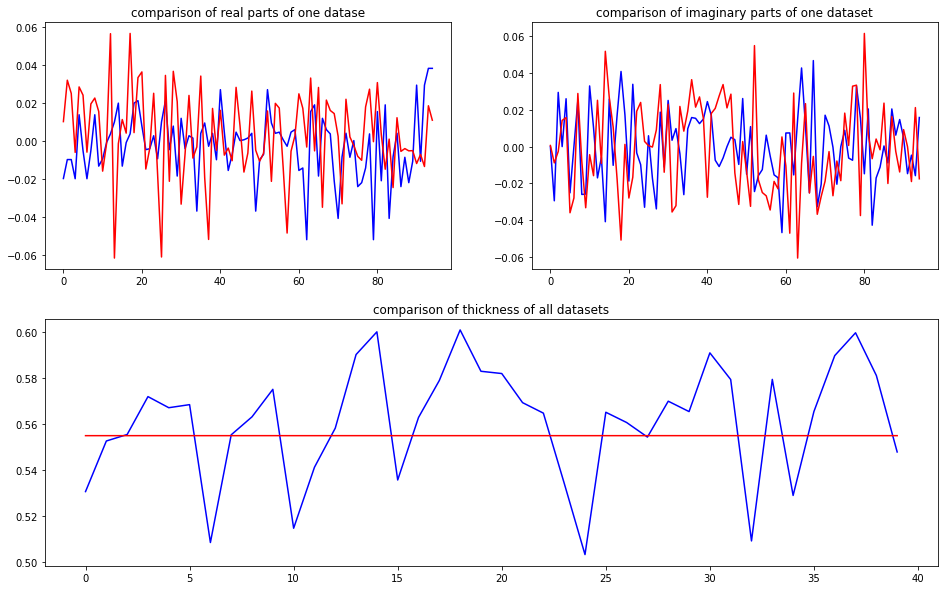

predicted thickness: 0.5550264


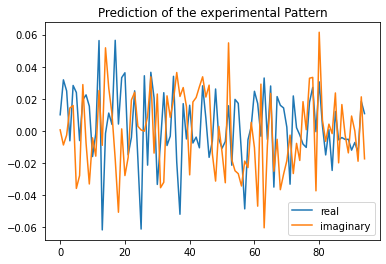

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=555.0264120101929
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00999903+0.j          0.02832668-0.00308114j  0.02832668+0.00308114j
 -0.00617646+0.0210778j   0.02533633+0.01178148j  0.0216072 -0.03238228j
 -0.00617646-0.0210778j   0.0216072 +0.03

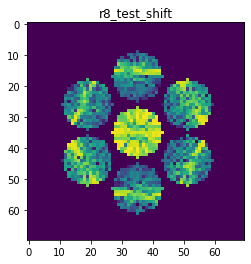

X_sim.max(): 0.9552905346942249
nlogf_X_sim.max(): 6.863061773465066
>>>replaced the 60. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 451ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 7.7350e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 281ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 8.6054e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 7.9014e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 263ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 9.6037e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 8.4014e-04 - val_acc: 1.0000


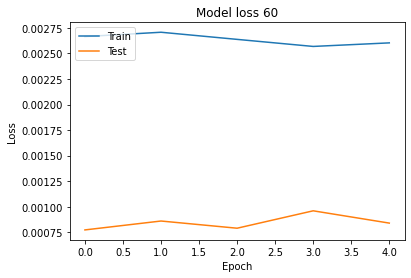

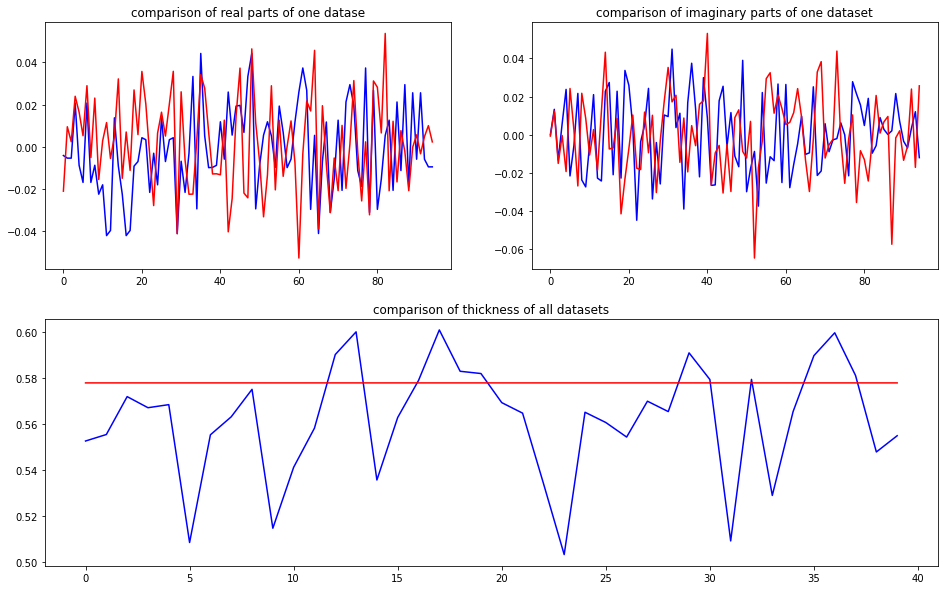

predicted thickness: 0.5780025


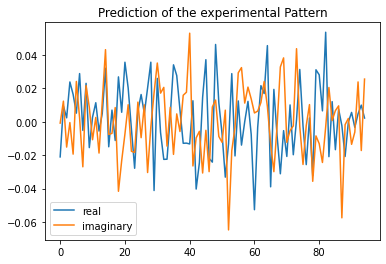

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=578.0025124549866
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-2.09794287e-02+0.j          5.96672134e-03+0.01374919j
  5.96672134e-03-0.01374919j  2.64244284e-02-0.00141833j
  1.97771788e-02-0.0205315j   5.88113908e-05+0.0255696j
  2.64244284e-02+

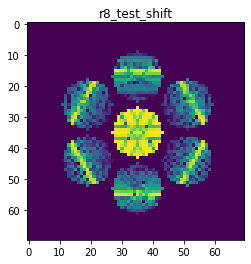

X_sim.max(): 0.9679832585371003
nlogf_X_sim.max(): 6.87624733469002
>>>replaced the 61. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 442ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 8.0851e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 294ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 9.2538e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 293ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 8.6381e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 294ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 7.7285e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 300ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 9.8748e-04 - val_acc: 1.0000


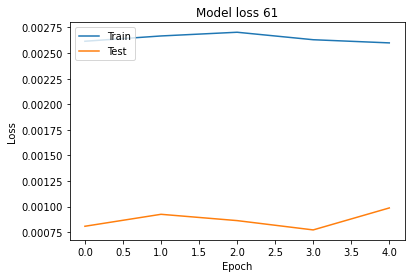

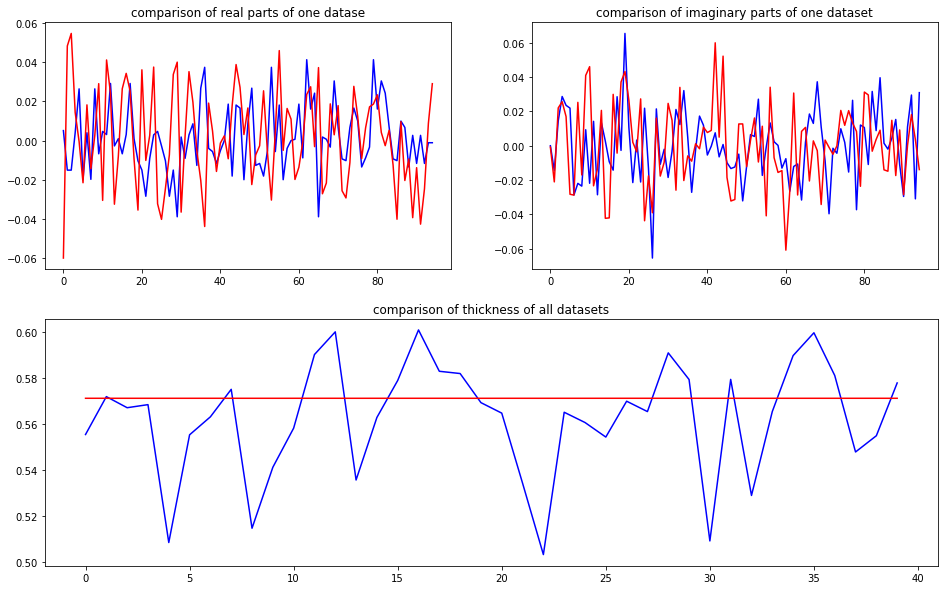

predicted thickness: 0.57129985


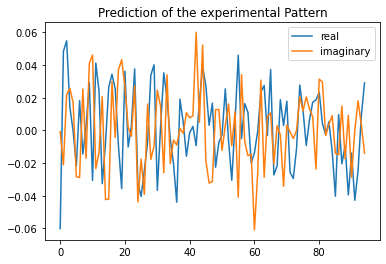

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=571.2998509407043
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.06012066+0.j          0.05161712-0.02155239j  0.05161712+0.02155239j
  0.01630814+0.02723076j  0.00105054+0.01701558j -0.01802309-0.02679164j
  0.01630814-0.02723076j -0.01802309+0.02

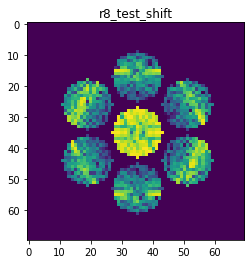

X_sim.max(): 0.9658863819637764
nlogf_X_sim.max(): 6.874080993166279
>>>replaced the 62. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 454ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 8.6749e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 293ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 8.5189e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 306ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 8.1531e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 299ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 7.7988e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 296ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 6.9503e-04 - val_acc: 1.0000


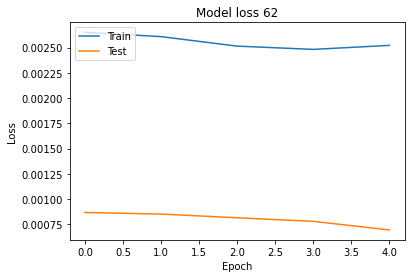

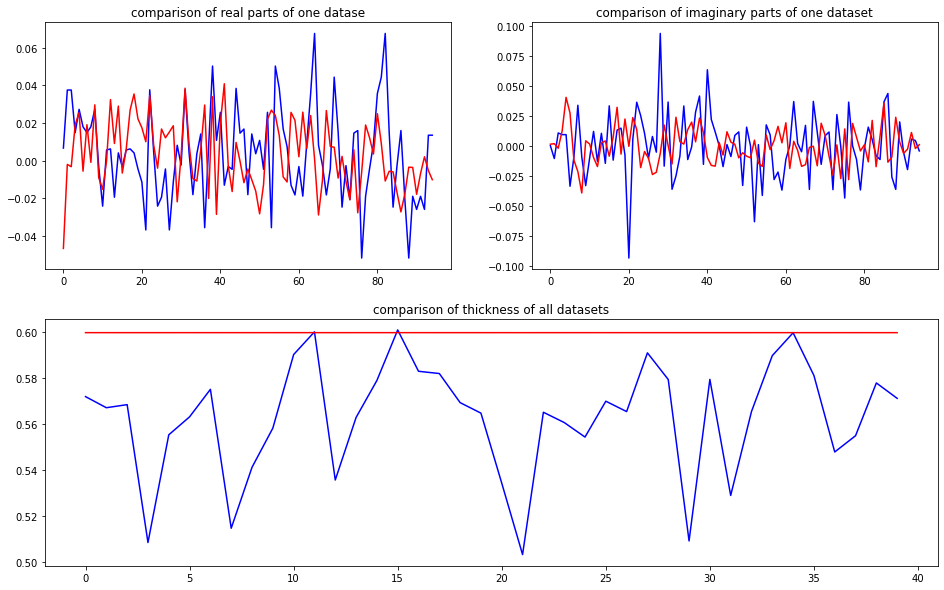

predicted thickness: 0.59987676


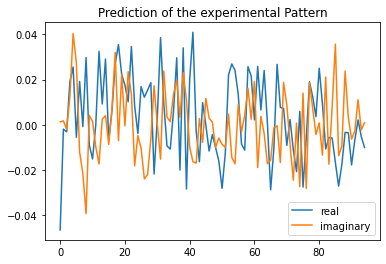

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=599.8767614364624
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.04653681+0.j         -0.00253725+0.00188579j -0.00253725-0.00188579j
  0.01911954+0.01222237j  0.02763158+0.03985507j -0.00319316+0.02440204j
  0.01911954-0.01222237j -0.00319316-0.02

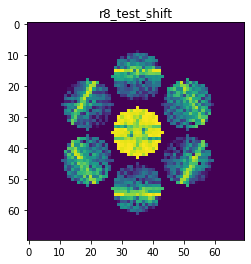

X_sim.max(): 0.9577972522886417
nlogf_X_sim.max(): 6.865679636774565
>>>replaced the 63. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 506ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 8.6930e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 279ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 7.7938e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 300ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 7.3289e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 282ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 7.1680e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 297ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


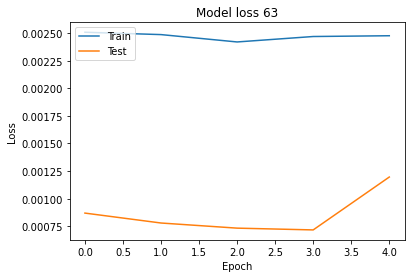

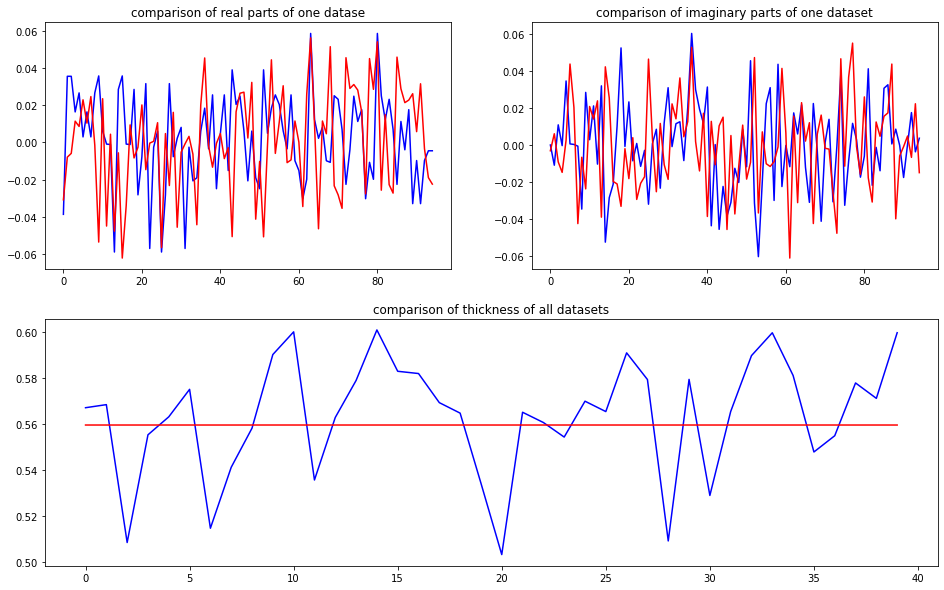

predicted thickness: 0.55965567


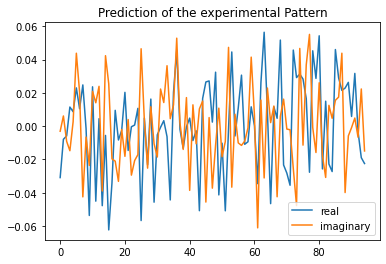

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=559.6556663513184
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.0309284 +0.j         -0.00690036+0.0076259j  -0.00690036-0.0076259j
  0.01095351-0.01757385j  0.00357201+0.00460654j  0.02386337+0.04316247j
  0.01095351+0.01757385j  0.02386337-0.043

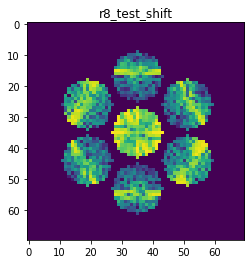

X_sim.max(): 0.9503273332595714
nlogf_X_sim.max(): 6.857858202333616
>>>replaced the 64. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 449ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 8.8415e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 289ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 8.4312e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 265ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 8.9874e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 285ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 8.3562e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 288ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 7.5330e-04 - val_acc: 1.0000


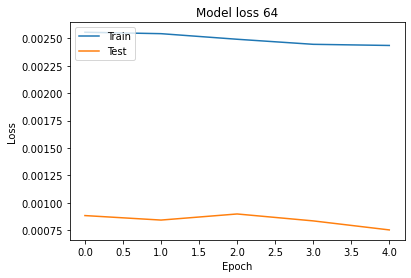

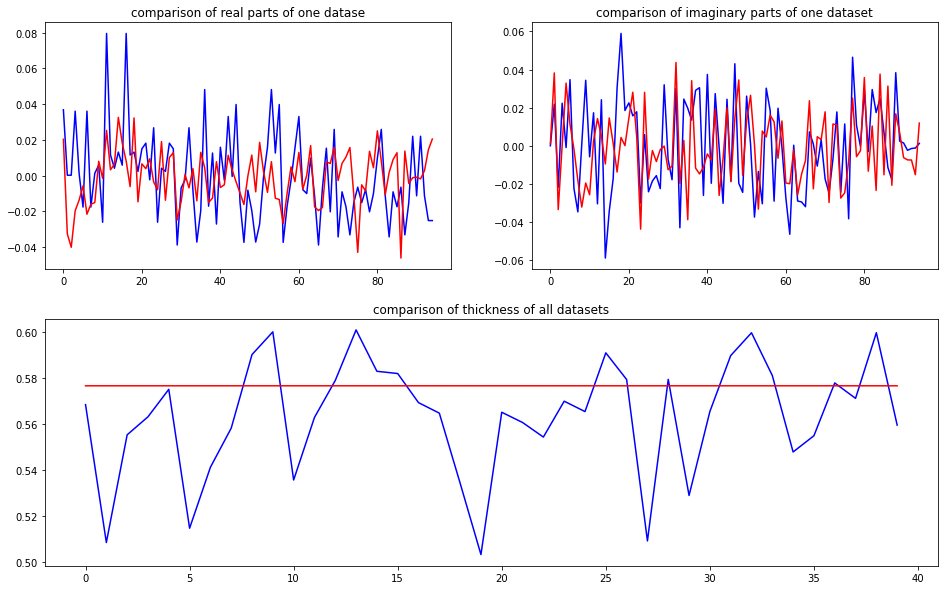

predicted thickness: 0.5767266


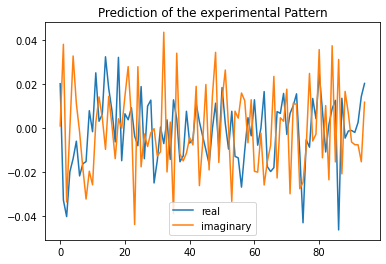

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=576.7266154289246
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02029116+0.j         -0.03643039+0.03588554j -0.03643039-0.03588554j
 -0.0206901 +0.00092341j -0.01446142+0.03253826j -0.01099537+0.01470275j
 -0.0206901 -0.00092341j -0.01099537-0.01

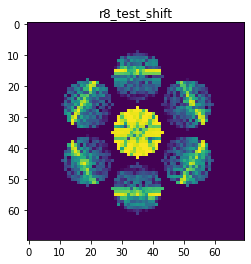

X_sim.max(): 0.981293142015141
nlogf_X_sim.max(): 6.889889779098009
>>>replaced the 65. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 450ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 9.8937e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 2s 315ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 8.5301e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 291ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 7.6741e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 297ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 8.1543e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 286ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 7.6515e-04 - val_acc: 1.0000


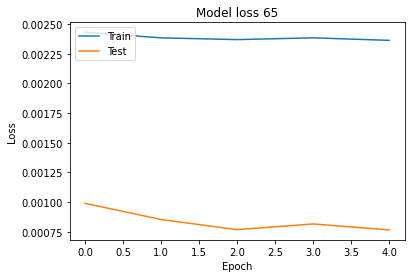

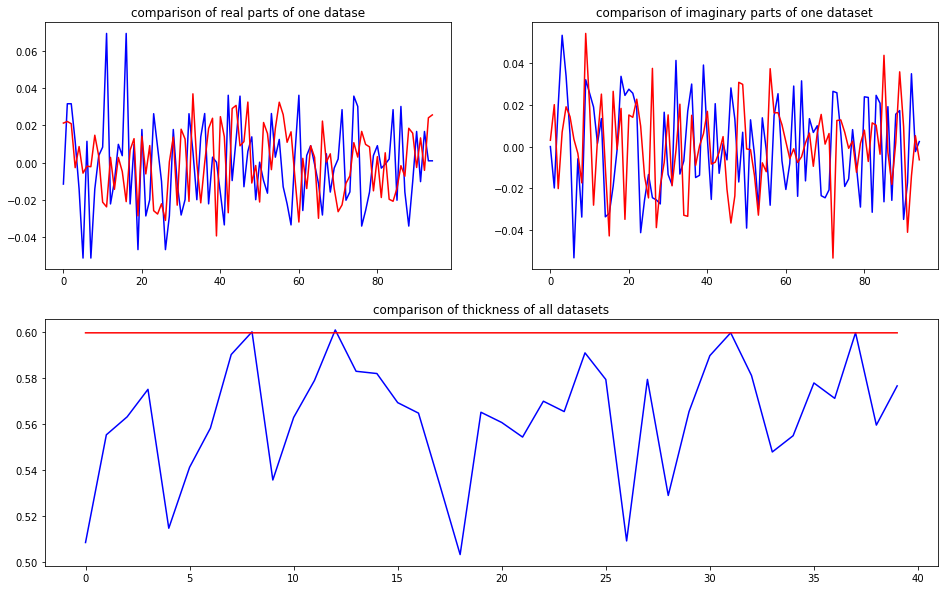

predicted thickness: 0.5997997


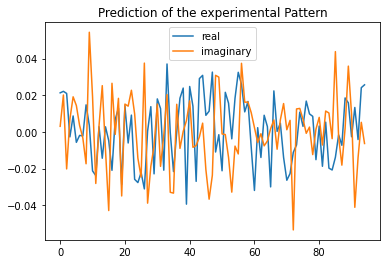

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=599.7996926307678
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02127844+0.j          0.02152319+0.02015618j  0.02152319-0.02015618j
 -0.00233398+0.00172304j  0.0117007 +0.01825376j -0.00396593+0.0088375j
 -0.00233398-0.00172304j -0.00396593-0.008

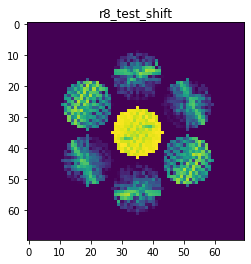

X_sim.max(): 0.9854237699681778
nlogf_X_sim.max(): 6.894086049256645
>>>replaced the 66. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 447ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 8.6352e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 298ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 8.6337e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 288ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 7.4181e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 269ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 8.4175e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 268ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 8.5017e-04 - val_acc: 1.0000


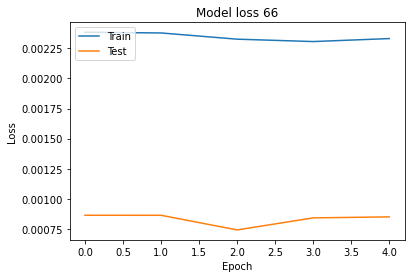

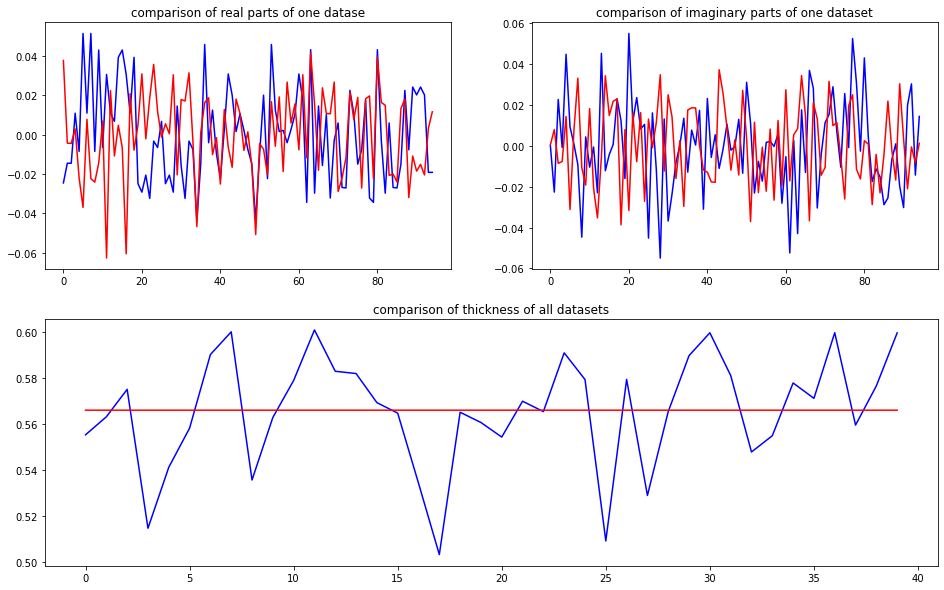

predicted thickness: 0.5661152


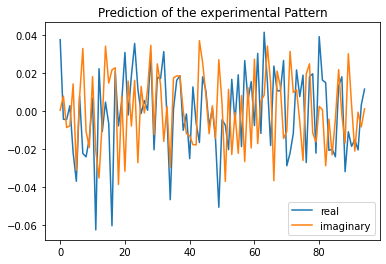

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=566.1152005195618
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03764988+0.j         -0.00436952+0.00827507j -0.00436952-0.00827507j
  0.00533618-0.00758277j -0.02295091+0.01248912j -0.02964615-0.03211872j
  0.00533618+0.00758277j -0.02964615+0.03

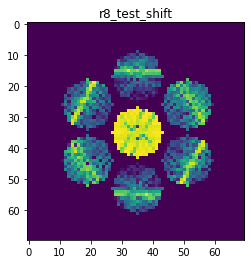

X_sim.max(): 0.97615322126854
nlogf_X_sim.max(): 6.884643468066405
>>>replaced the 67. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 428ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 8.7710e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 258ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 8.7534e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 9.1395e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 267ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 9.5770e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 260ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 9.8764e-04 - val_acc: 1.0000


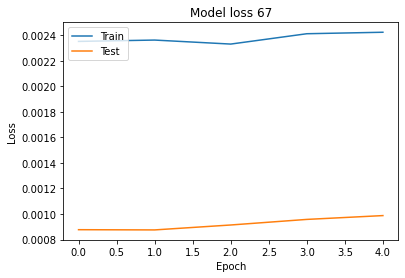

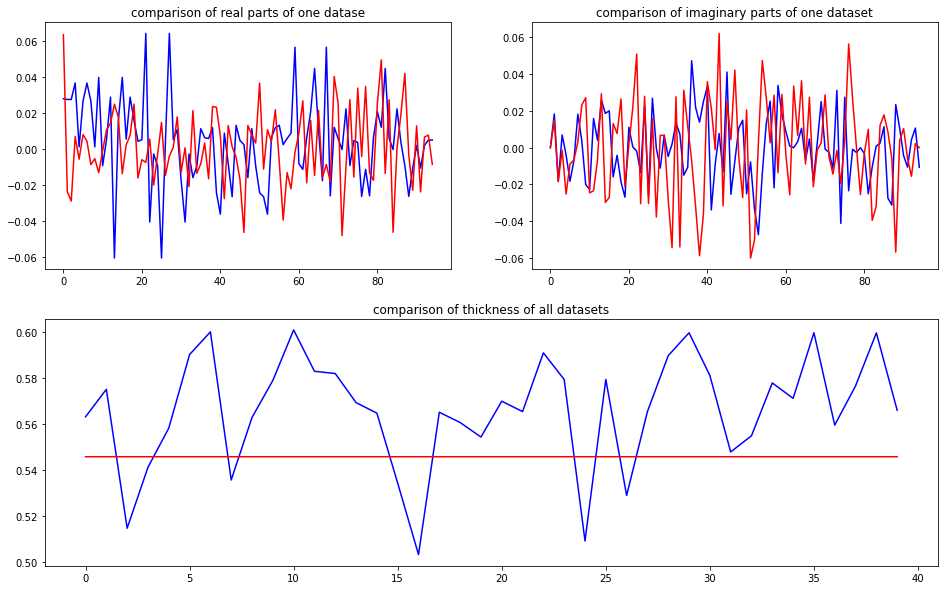

predicted thickness: 0.54584306


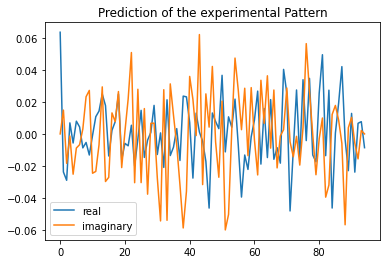

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=545.8430647850037
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.06360984+0.j         -0.02639402+0.01664653j -0.02639402-0.01664653j
  0.00565016+0.00270616j -0.00549257-0.02422338j -0.00037149-0.00597113j
  0.00565016-0.00270616j -0.00037149+0.00

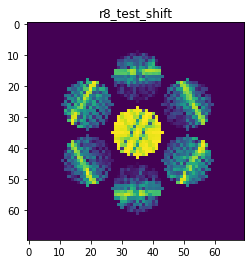

X_sim.max(): 0.9878552997576864
nlogf_X_sim.max(): 6.896548011269965
>>>replaced the 68. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 445ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 9.1451e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 281ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 9.6149e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 279ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 8.9485e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 9.2949e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 280ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 7.2238e-04 - val_acc: 1.0000


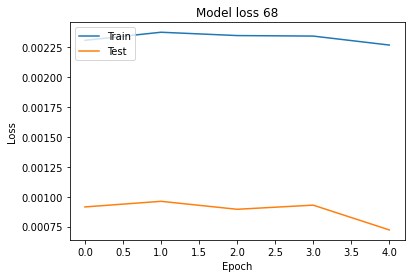

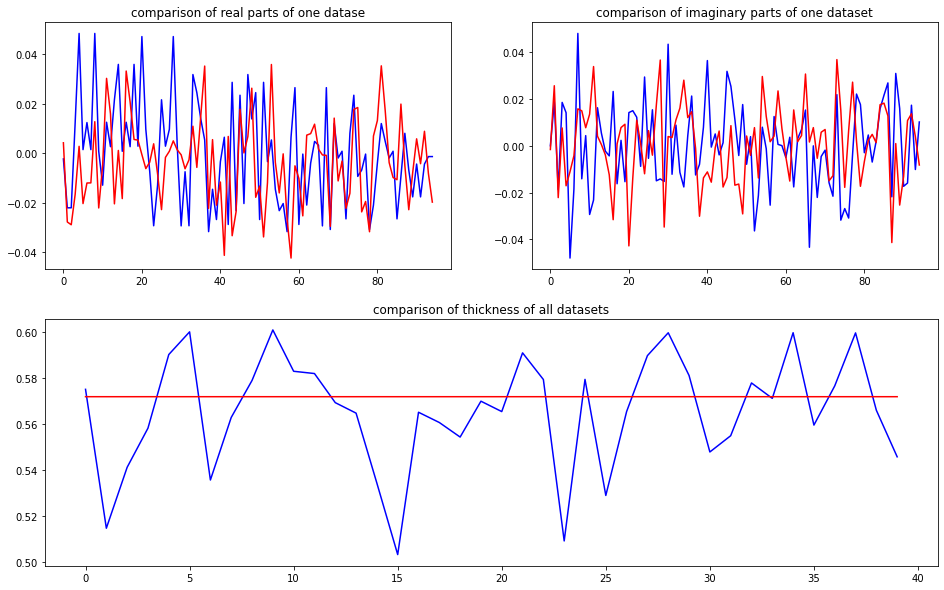

predicted thickness: 0.5719866


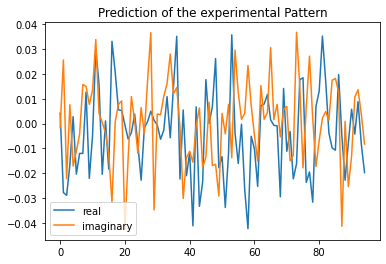

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=571.9866156578064
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 4.20901133e-03+0.j         -2.82924874e-02+0.02389628j
 -2.82924874e-02-0.02389628j -1.42827607e-02+0.00593328j
  7.75317987e-03-0.01601851j -1.61506939e-02-0.01342305j
 -1.42827607e-02

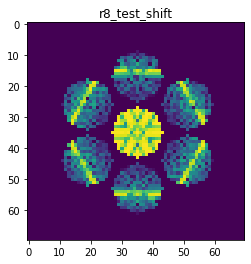

X_sim.max(): 0.9797660555808859
nlogf_X_sim.max(): 6.888333955672855
>>>replaced the 69. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 490ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 9.3094e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 274ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 8.1408e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 7.6711e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 265ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 9.6269e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 268ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 7.6771e-04 - val_acc: 1.0000


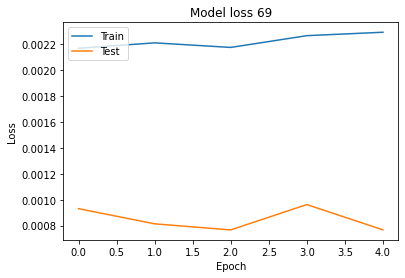

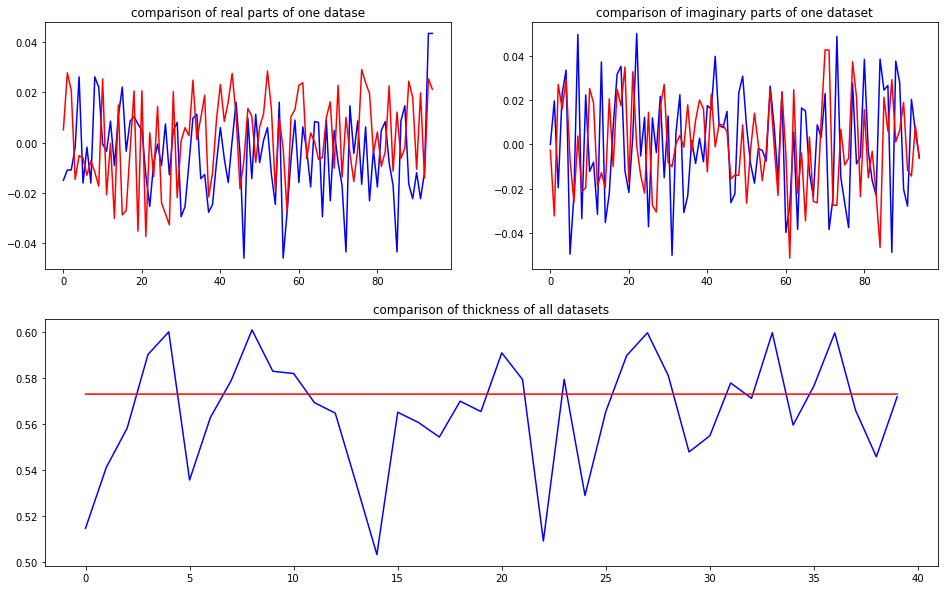

predicted thickness: 0.5731228


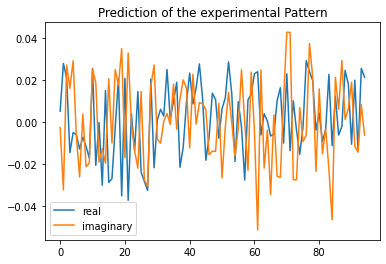

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=573.1227993965149
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00517333+0.j          0.02433481-0.02967639j  0.02433481+0.02967639j
 -0.01372353+0.0210491j  -0.00834043+0.02521045j -0.00663879-0.00521255j
 -0.01372353-0.0210491j  -0.00663879+0.00

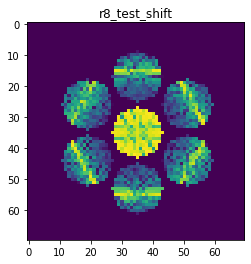

X_sim.max(): 0.9573678037256298
nlogf_X_sim.max(): 6.865231633021473
>>>replaced the 70. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 428ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 6.7596e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 255ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 7.0716e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 250ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 8.4626e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 252ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 7.4332e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 248ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 7.3744e-04 - val_acc: 1.0000


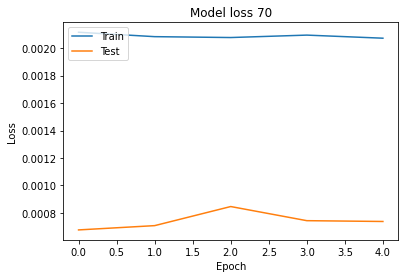

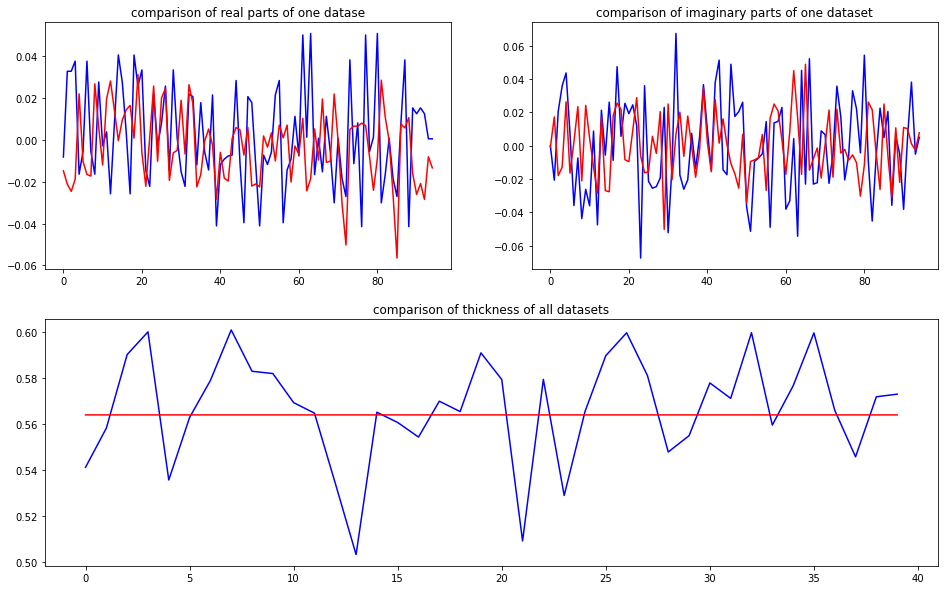

predicted thickness: 0.5640607


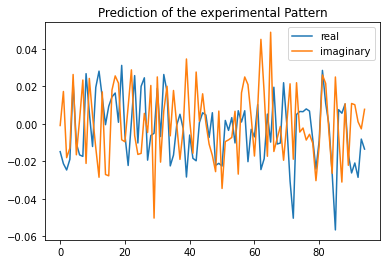

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=564.0606880187988
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01477321+0.j         -0.02286732+0.0176442j  -0.02286732-0.0176442j
 -0.01768115-0.00759089j  0.0244543 +0.02371324j -0.01382357-0.01993375j
 -0.01768115+0.00759089j -0.01382357+0.019

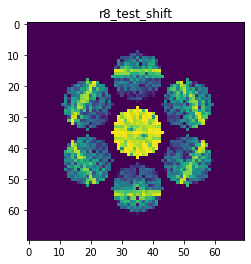

X_sim.max(): 0.9429782461030339
nlogf_X_sim.max(): 6.850103121497596
>>>replaced the 71. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 418ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 9.8038e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 255ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 7.4821e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 252ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 7.3291e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 251ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 8.6135e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 250ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 8.2580e-04 - val_acc: 1.0000


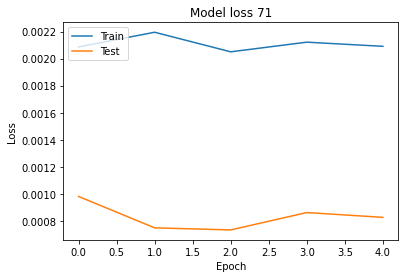

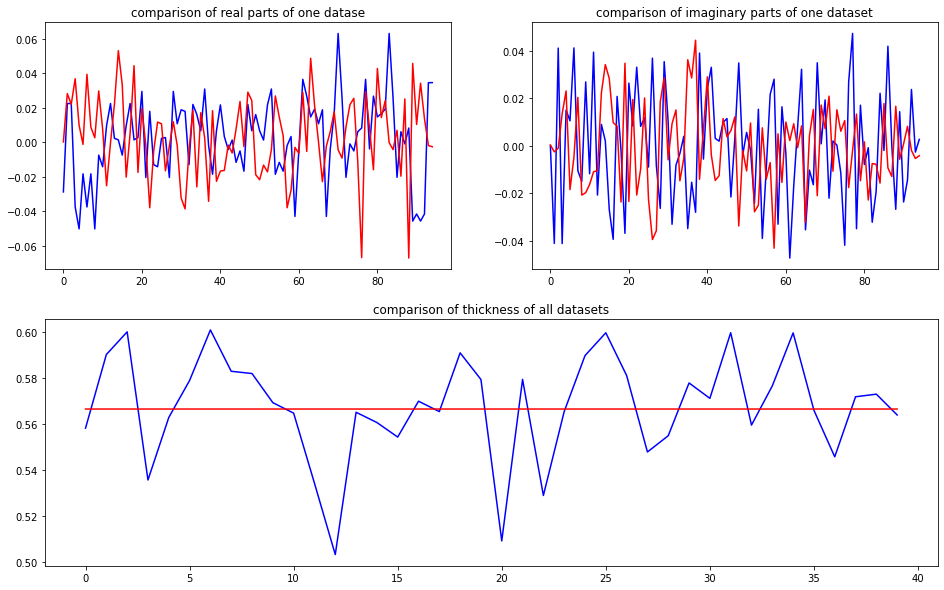

predicted thickness: 0.56661314


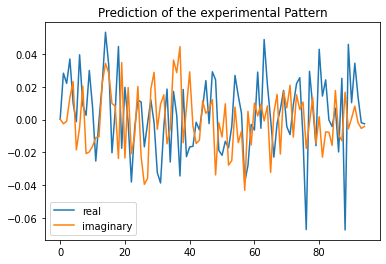

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=566.6131377220154
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00016281+0.j          0.02512438-0.00076499j  0.02512438+0.00076499j
  0.03814307+0.00912975j  0.00626567+0.02190923j  0.00372504-0.01938527j
  0.03814307-0.00912975j  0.00372504+0.01

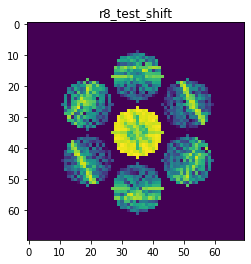

X_sim.max(): 0.9702176101178189
nlogf_X_sim.max(): 6.878550552469736
>>>replaced the 72. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 438ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 7.8868e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 274ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 9.2849e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 8.0674e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 9.3787e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 7.0279e-04 - val_acc: 1.0000


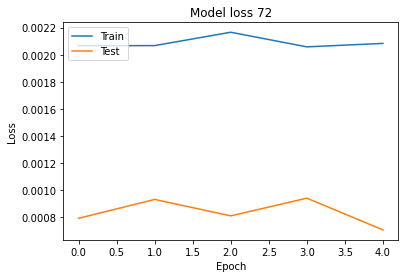

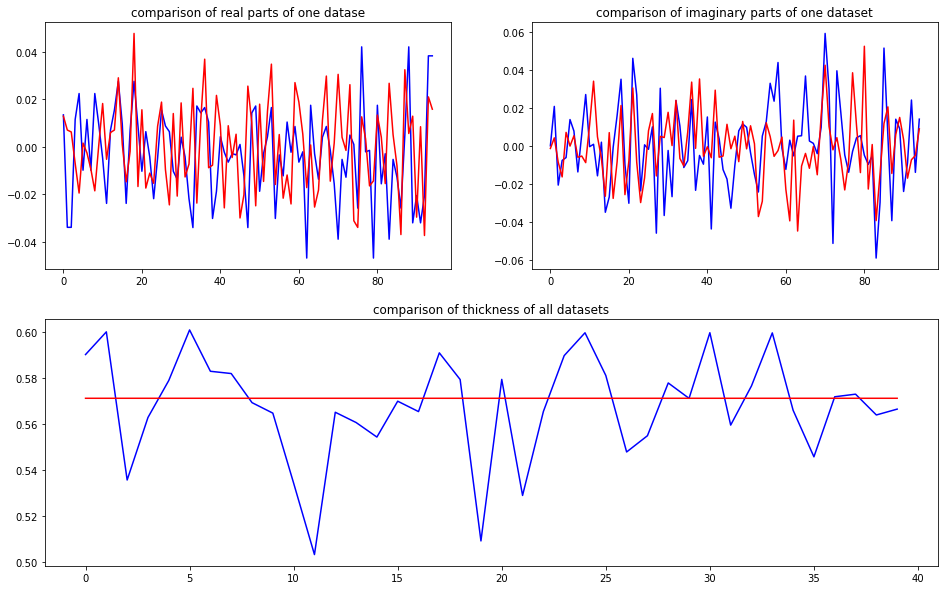

predicted thickness: 0.57129854


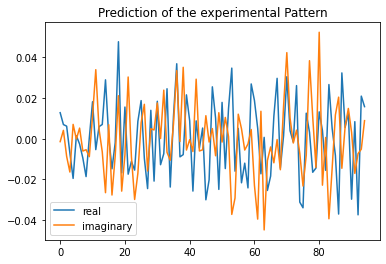

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=571.2985396385193
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01277765+0.j          0.00656138+0.00638867j  0.00656138-0.00638867j
 -0.00483957-0.01079165j -0.01904708+0.00621023j -0.00401014+0.00294595j
 -0.00483957+0.01079165j -0.00401014-0.00

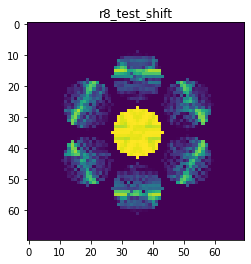

X_sim.max(): 0.9932390040120737
nlogf_X_sim.max(): 6.901977624446128
>>>replaced the 73. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 449ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 8.9497e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 303ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 6.9688e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 309ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 8.8564e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 2s 319ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 8.1628e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 299ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 8.9232e-04 - val_acc: 1.0000


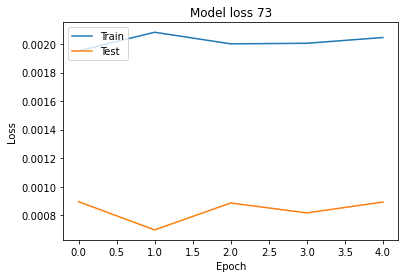

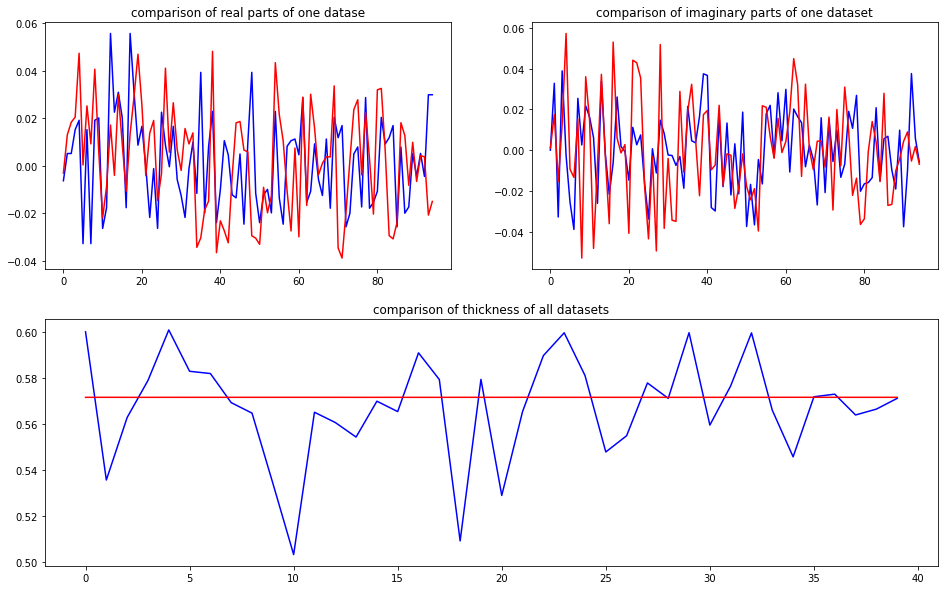

predicted thickness: 0.5716996


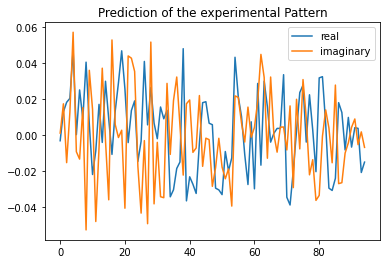

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=571.6996192932129
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00318411+0.j          0.01557933+0.01637578j  0.01557933-0.01637578j
  0.02276617+0.01303588j  0.0439565 +0.0550347j   0.00464677-0.01226784j
  0.02276617-0.01303588j  0.00464677+0.01

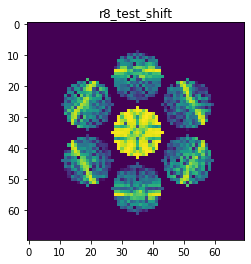

X_sim.max(): 0.9890667977751204
nlogf_X_sim.max(): 6.89777241335259
>>>replaced the 74. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 456ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 7.4302e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 304ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 6.5701e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 289ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 8.5692e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 293ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.5053e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 295ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 6.9062e-04 - val_acc: 1.0000


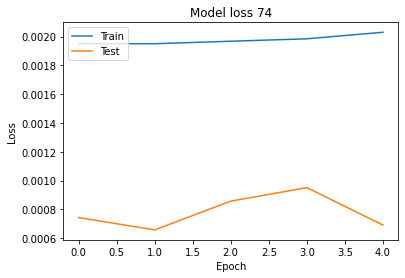

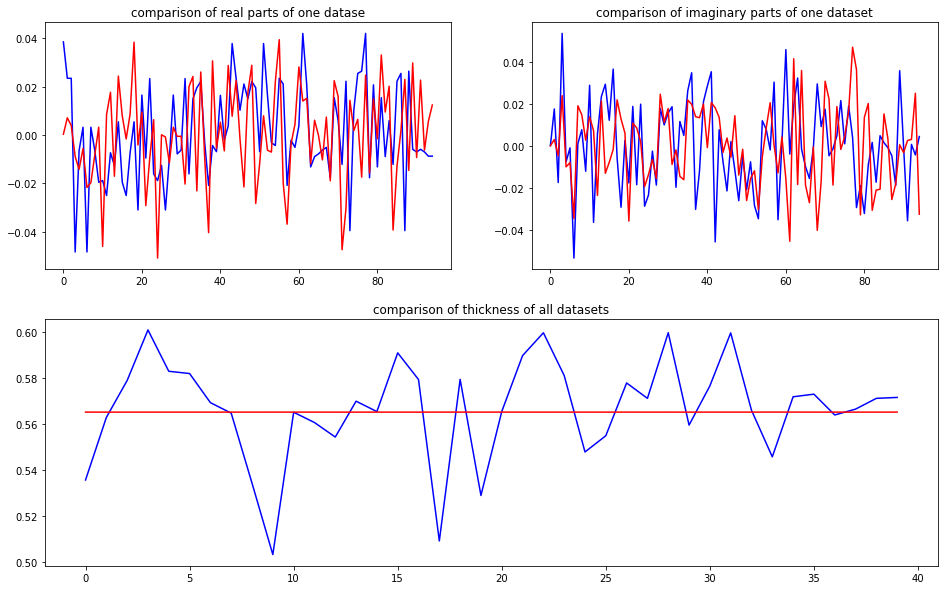

predicted thickness: 0.5652491


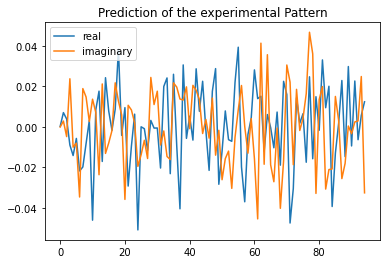

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.2490854263306
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 2.94254103e-04+0.j          5.52089652e-03+0.00384115j
  5.52089652e-03-0.00384115j -1.53173697e-02+0.02920373j
 -1.11750974e-02-0.01239892j -1.27191138e-02-0.01348314j
 -1.53173697e-02

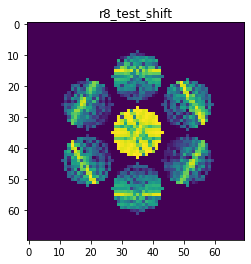

X_sim.max(): 0.9626945590122853
nlogf_X_sim.max(): 6.870774396906143
>>>replaced the 75. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 503ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 8.4991e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 301ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 8.0094e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 293ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 6.6631e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 301ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 7.4287e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 283ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 6.7827e-04 - val_acc: 1.0000


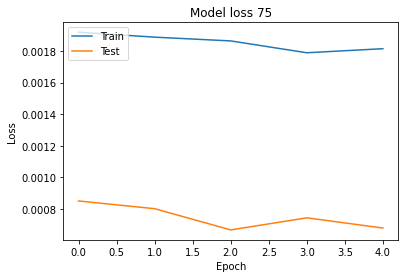

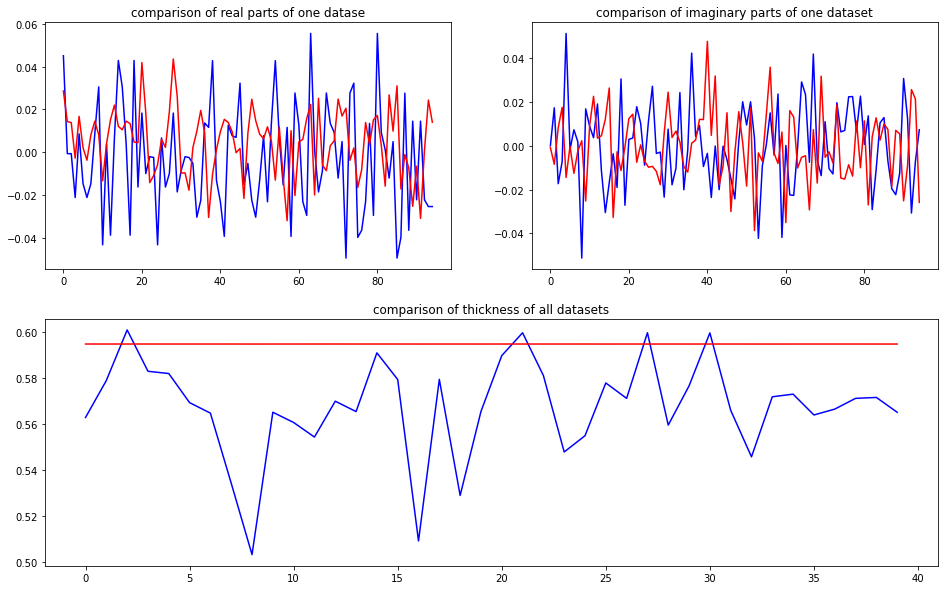

predicted thickness: 0.59491587


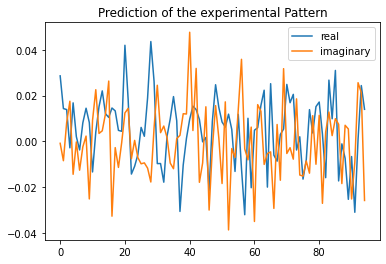

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=594.9158668518066
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02862411+0.j          0.01410931-0.00829785j  0.01410931+0.00829785j
 -0.00330634+0.0150669j   0.01564621-0.00835304j  0.00505942+0.00107631j
 -0.00330634-0.0150669j   0.00505942-0.00

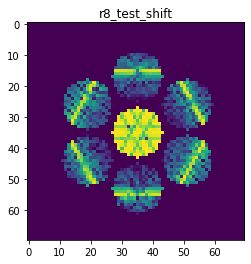

X_sim.max(): 0.9869233534486482
nlogf_X_sim.max(): 6.895605117257454
>>>replaced the 76. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 450ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 6.6979e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 309ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 8.2792e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 295ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 6.0948e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 294ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 7.0147e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 286ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 5.8272e-04 - val_acc: 1.0000


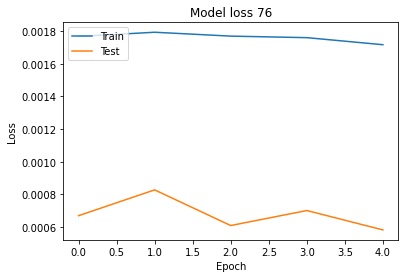

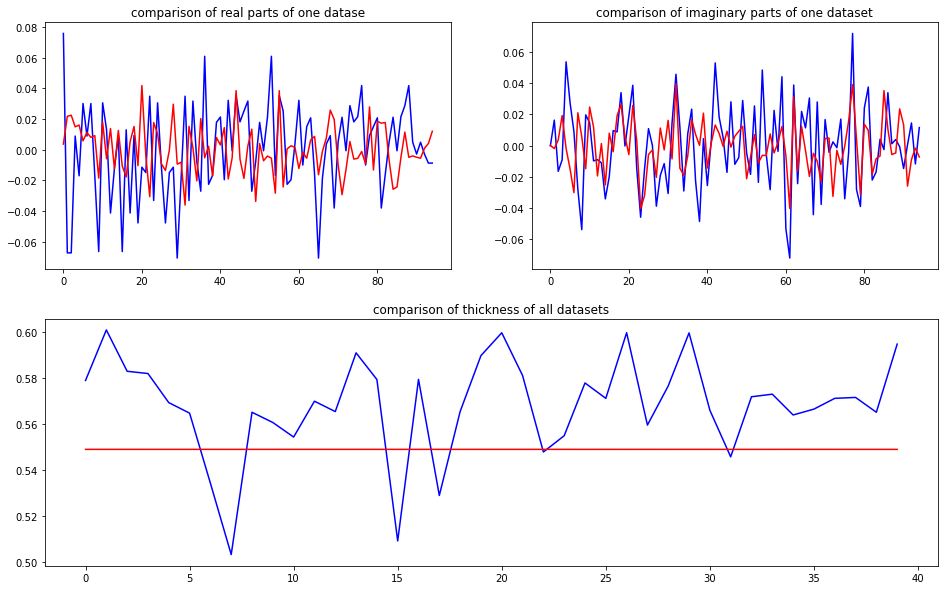

predicted thickness: 0.5490444


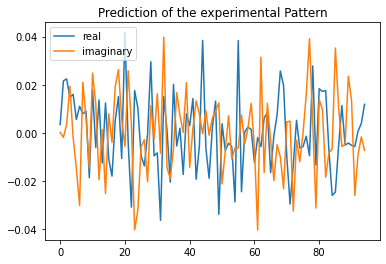

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=549.0443706512451
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00352208+0.00000000e+00j  0.0220272 -2.70800758e-03j
  0.0220272 +2.70800758e-03j  0.01294744+2.46978374e-02j
  0.01256596-3.74219147e-03j  0.00676806-1.77970594e-02j
  0.01294744-2.4

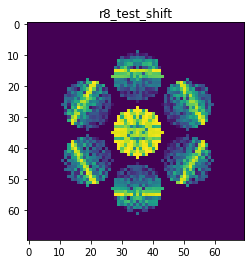

X_sim.max(): 0.9514524089944191
nlogf_X_sim.max(): 6.859040141442277
>>>replaced the 77. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 451ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.8469e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 303ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.9081e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 286ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.4523e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 288ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.4638e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 306ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.9246e-04 - val_acc: 1.0000


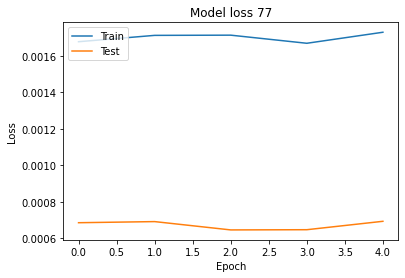

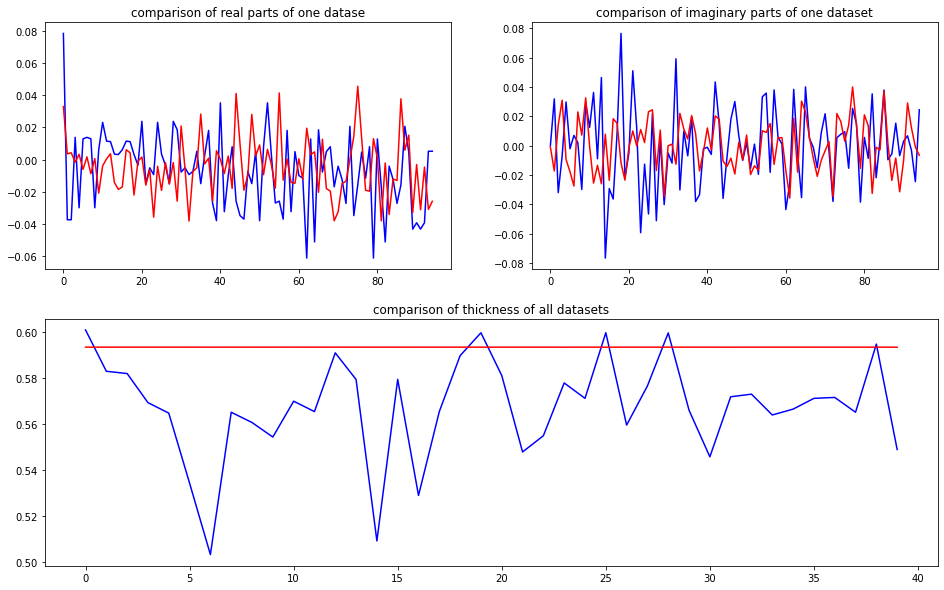

predicted thickness: 0.5935374


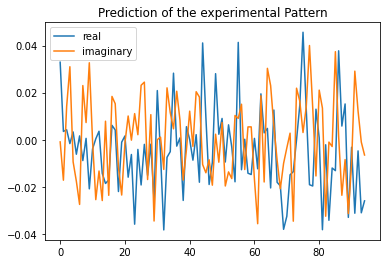

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=593.5373902320862
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 3.29077765e-02+0.j          3.87326174e-03-0.01562697j
  3.87326174e-03+0.01562697j -4.91243554e-06+0.02922756j
  1.94687399e-03-0.00833973j -7.49865966e-03-0.02031114j
 -4.91243554e-06

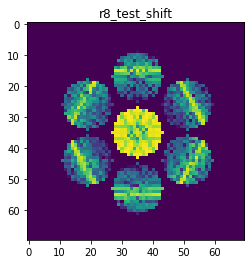

X_sim.max(): 0.9503141434243505
nlogf_X_sim.max(): 6.857844337572038
>>>replaced the 78. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 475ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 7.1948e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 306ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.2336e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 2s 319ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 5.9872e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 2s 317ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 6.1944e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 308ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 5.9900e-04 - val_acc: 1.0000


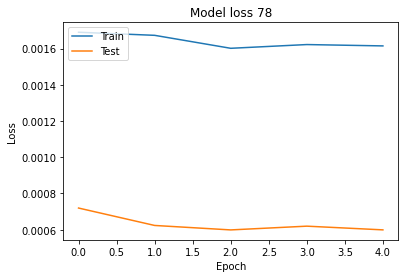

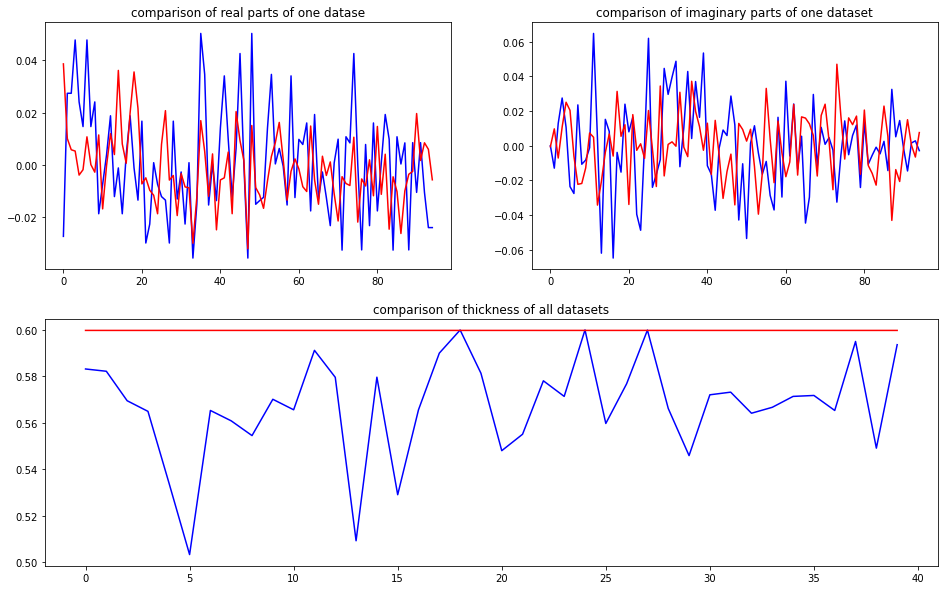

predicted thickness: 0.59961337


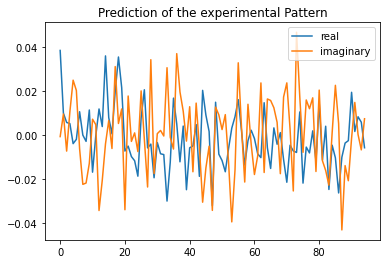

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=599.6133685112
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 3.86386067e-02+0.j          8.00097384e-03+0.00842282j
  8.00097384e-03-0.00842282j  8.06988566e-03+0.00839322j
 -3.22979491e-03+0.02338776j -8.26059491e-04+0.02135446j
  8.06988566e-03-0.

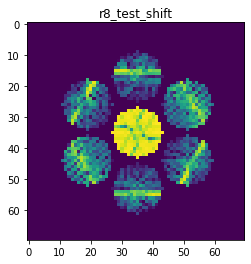

X_sim.max(): 0.9769722665828624
nlogf_X_sim.max(): 6.885481312355505
>>>replaced the 79. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 490ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 5.5057e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 309ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 5.7643e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 309ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 6.1684e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 296ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 6.8480e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 285ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 7.4236e-04 - val_acc: 1.0000


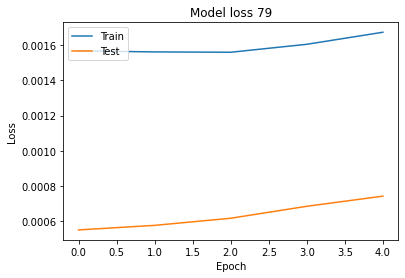

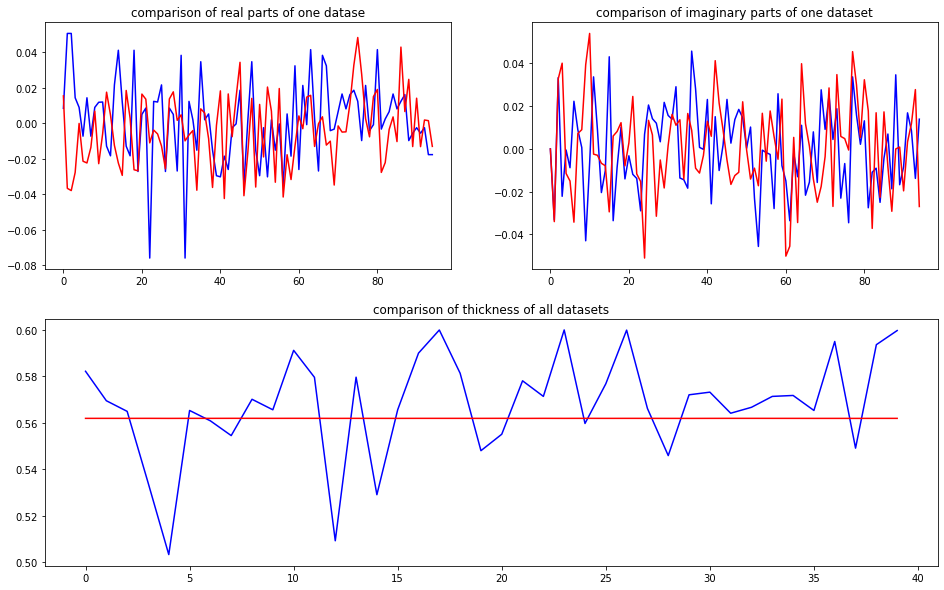

predicted thickness: 0.56180966


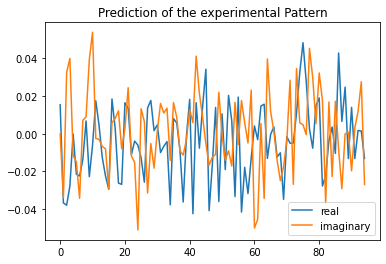

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=561.8096590042114
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01534499+0.00000000e+00j -0.03734116-3.32676787e-02j
 -0.03734116+3.32676787e-02j -0.02510752+3.71047296e-02j
  0.00333921-1.02094524e-02j -0.01760763-1.10348999e-02j
 -0.02510752-3.7

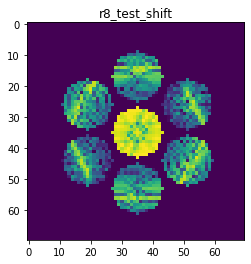

X_sim.max(): 0.9358772136072507
nlogf_X_sim.max(): 6.842552231610309
>>>replaced the 80. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 456ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 6.0183e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 291ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 7.2745e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 278ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 5.7569e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.6322e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.1475e-04 - val_acc: 1.0000


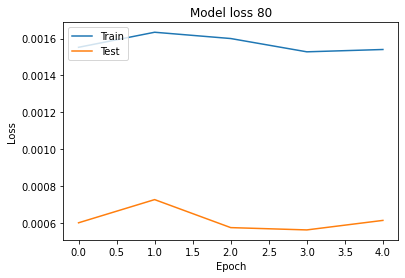

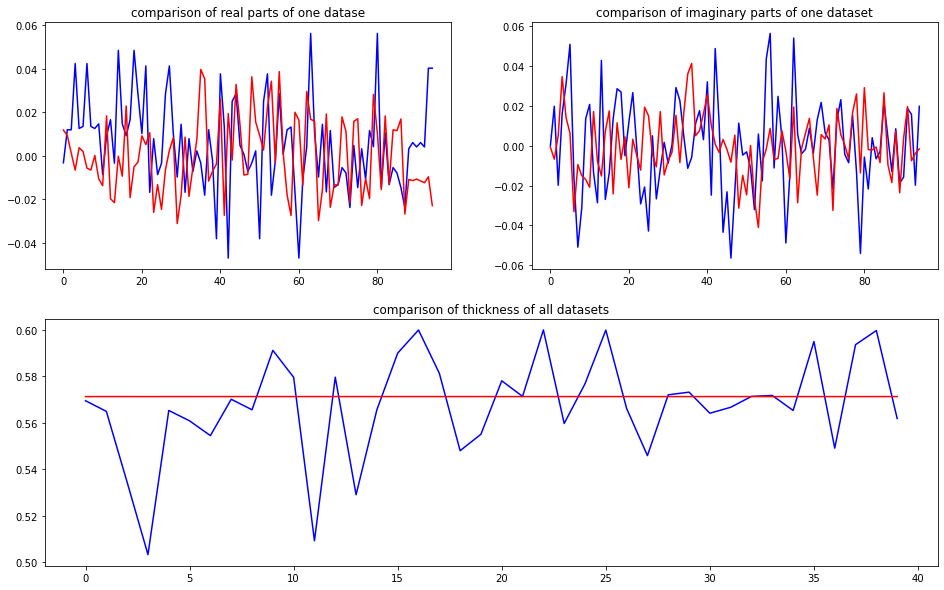

predicted thickness: 0.57119


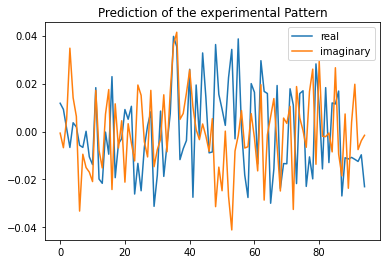

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=571.1899995803833
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01178254+0.j          0.00521544-0.00593047j  0.00521544+0.00593047j
 -0.00619809+0.03395859j  0.00187435+0.01455611j -0.00234549+0.00788556j
 -0.00619809-0.03395859j -0.00234549-0.00

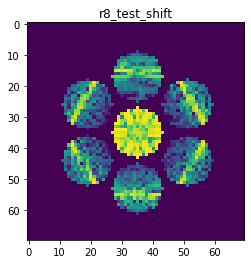

X_sim.max(): 0.9655379080751202
nlogf_X_sim.max(): 6.873720519891763
>>>replaced the 81. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 487ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.2542e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 292ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.8329e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 283ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.9613e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 278ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.8320e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 281ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.7416e-04 - val_acc: 1.0000


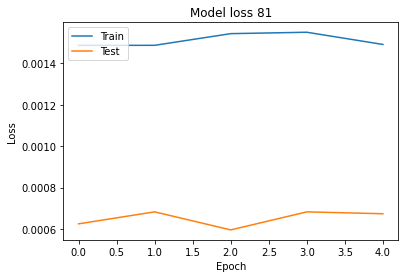

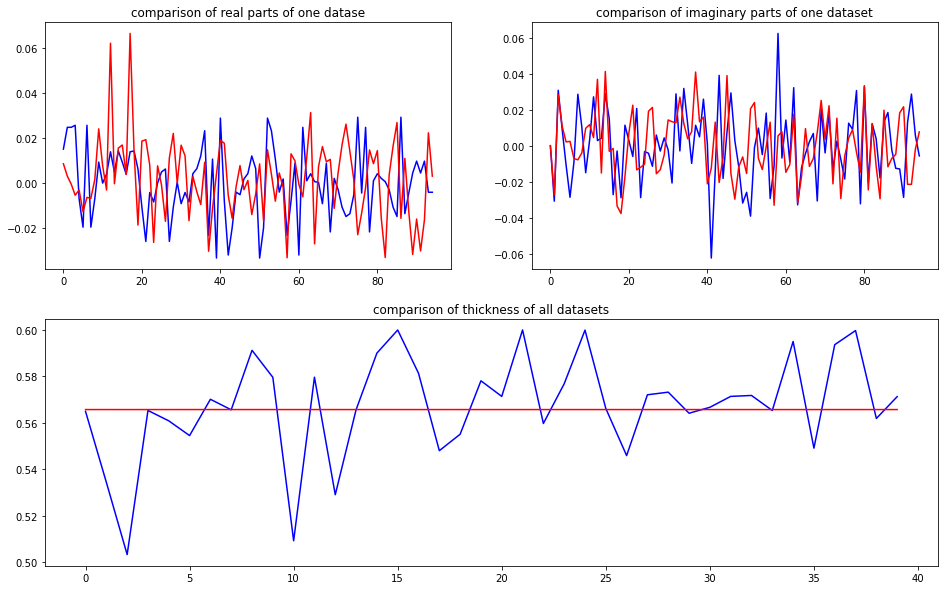

predicted thickness: 0.56560534


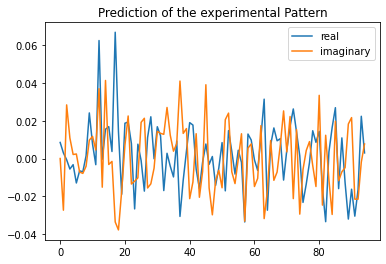

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.6053423881531
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00850367+0.j          0.00118337-0.0277808j   0.00118337+0.0277808j
 -0.00600602+0.00898543j -0.00086059+0.00310406j -0.00991841+0.00512602j
 -0.00600602-0.00898543j -0.00991841-0.005

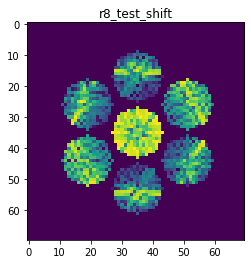

X_sim.max(): 0.9451820560346391
nlogf_X_sim.max(): 6.852434998775667
>>>replaced the 82. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 440ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.8180e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 283ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 7.3150e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 278ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.7573e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 5.8786e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 270ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 7.5531e-04 - val_acc: 1.0000


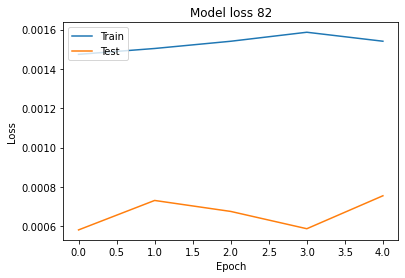

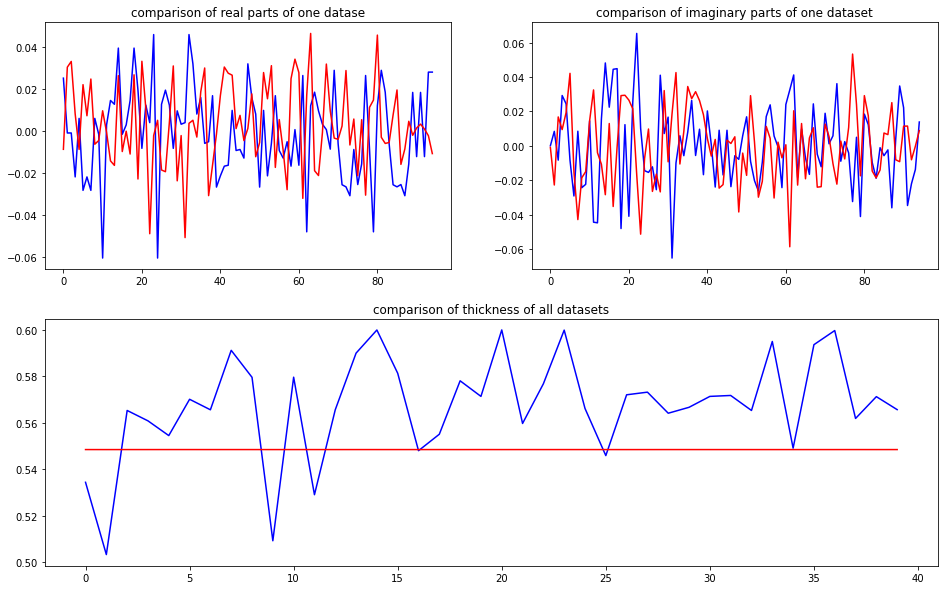

predicted thickness: 0.5483923


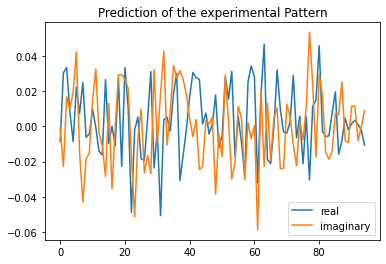

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=548.3922958374023
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00864147+0.j          0.0317783 -0.01975531j  0.0317783 +0.01975531j
  0.00775482+0.01222143j -0.00743241+0.01893685j  0.02342525+0.04251711j
  0.00775482-0.01222143j  0.02342525-0.04

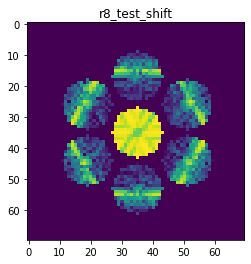

X_sim.max(): 0.9827915217025385
nlogf_X_sim.max(): 6.891414006416541
>>>replaced the 83. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 436ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 5.3508e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 276ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 6.6515e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.8176e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 273ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 6.0922e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 265ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.5353e-04 - val_acc: 1.0000


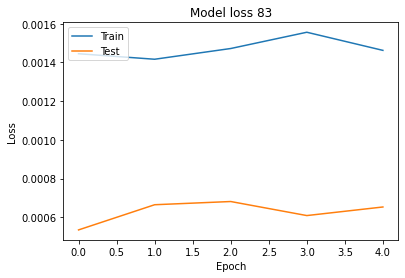

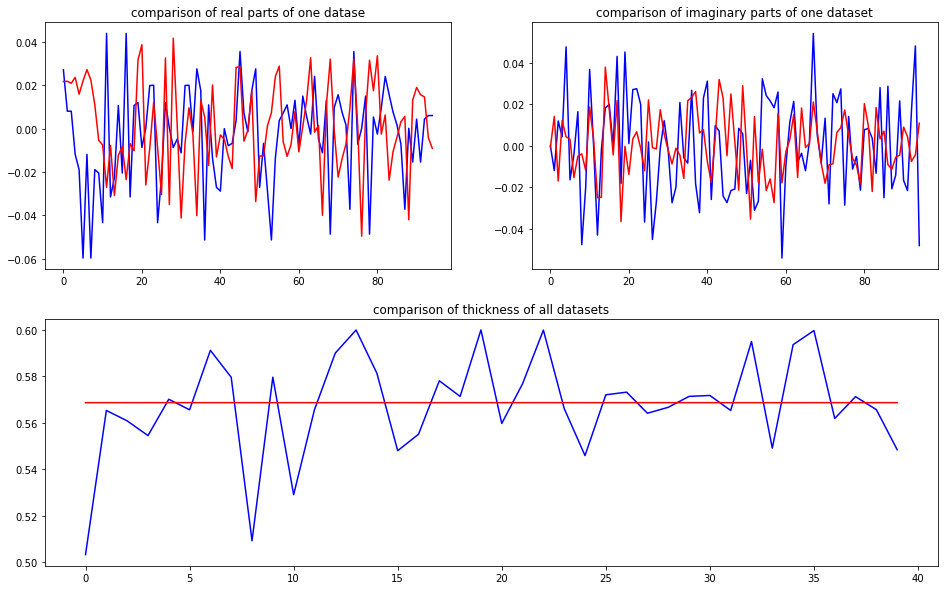

predicted thickness: 0.5685615


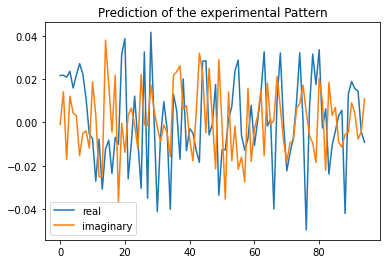

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=568.5614943504333
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02169842+0.00000000e+00j  0.02136724+1.56532377e-02j
  0.02136724-1.56532377e-02j  0.02540126+1.37727032e-02j
  0.01345948+4.13674791e-03j  0.02214383+4.11960867e-03j
  0.02540126-1.3

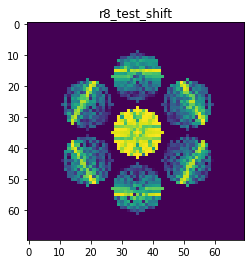

X_sim.max(): 0.950686525323821
nlogf_X_sim.max(): 6.858235700444726
>>>replaced the 84. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 419ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 6.9706e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 274ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.7670e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 274ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 5.6844e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 272ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 7.2360e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 275ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 5.4268e-04 - val_acc: 1.0000


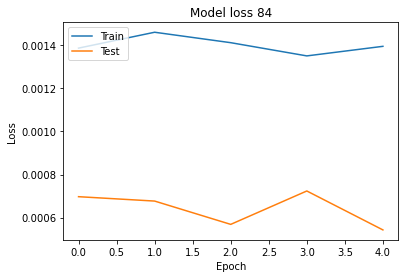

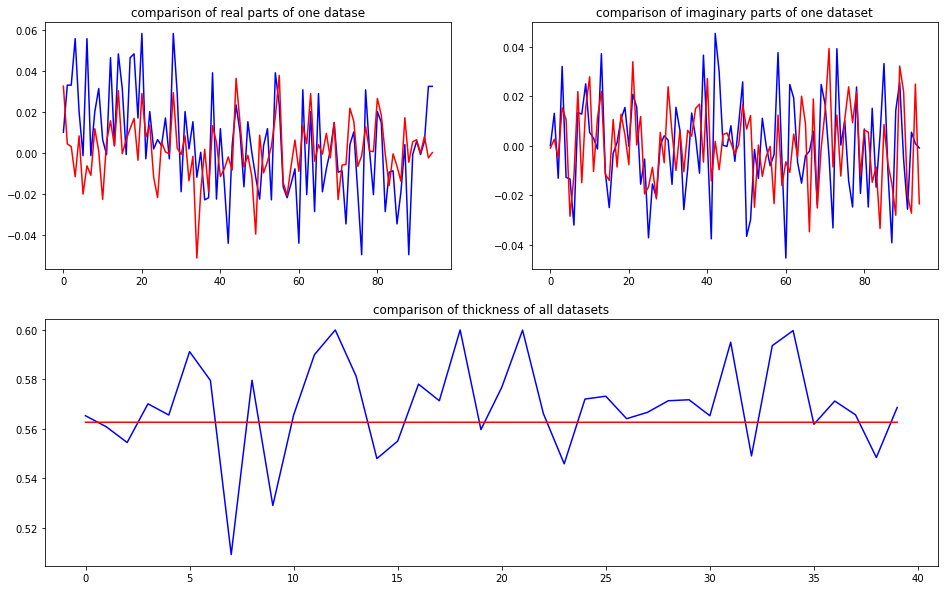

predicted thickness: 0.56256056


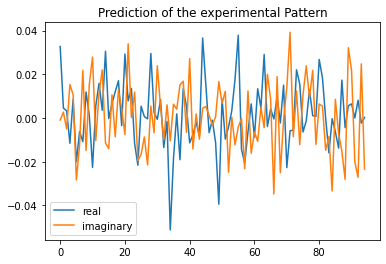

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=562.5605583190918
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03267426+0.j          0.00387742+0.00383485j  0.00387742-0.00383485j
 -0.00891058+0.01379946j  0.01019559+0.01275851j -0.01546056-0.02506303j
 -0.00891058-0.01379946j -0.01546056+0.02

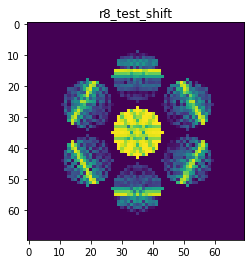

X_sim.max(): 0.9786530069525868
nlogf_X_sim.max(): 6.887198434427251
>>>replaced the 85. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 420ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 5.0620e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 255ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 5.6261e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 271ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 5.4619e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 264ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 6.5369e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 263ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 5.6174e-04 - val_acc: 1.0000


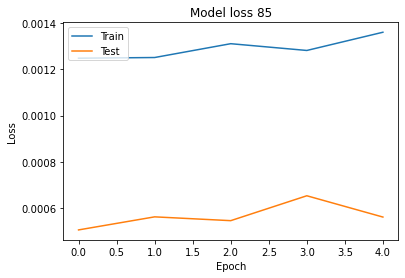

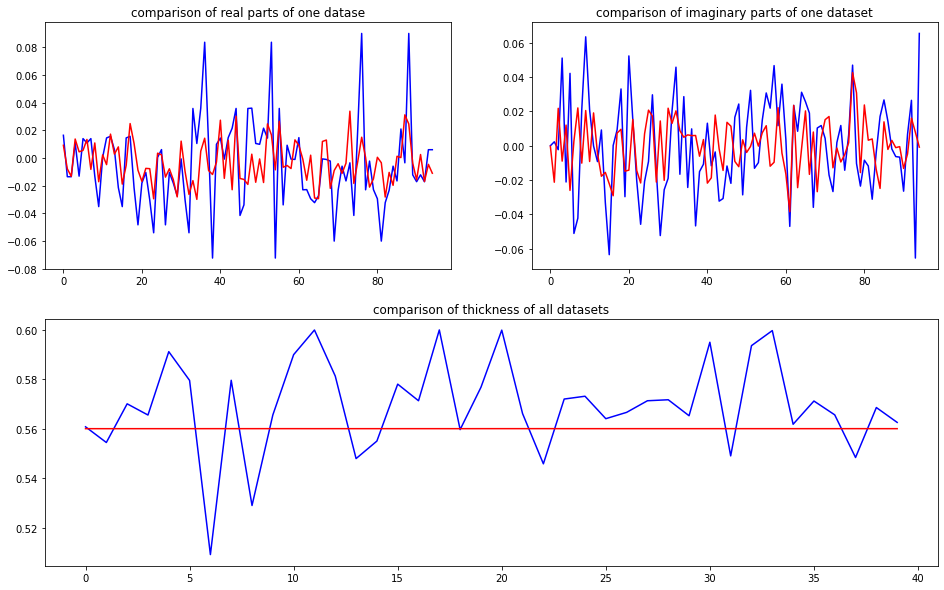

predicted thickness: 0.55993825


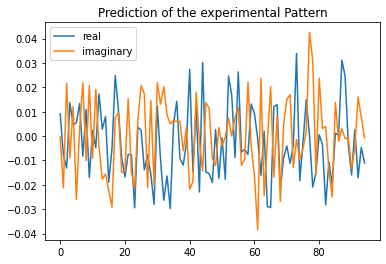

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=559.9382519721985
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00912777+0.j         -0.01044753-0.02144767j -0.01044753+0.02144767j
  0.01352333-0.00590415j  0.00772699+0.01109094j -0.00138468-0.02393266j
  0.01352333+0.00590415j -0.00138468+0.02

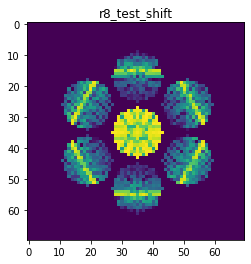

X_sim.max(): 0.9831210564079433
nlogf_X_sim.max(): 6.891748914290143
>>>replaced the 86. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 453ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 7.0970e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 294ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 5.3095e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 297ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 6.7369e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 301ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 6.0201e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 290ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 6.3420e-04 - val_acc: 1.0000


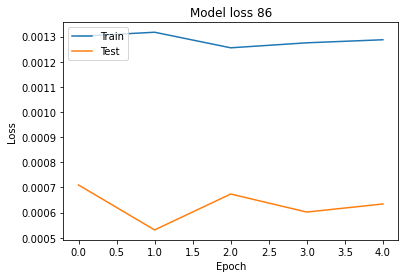

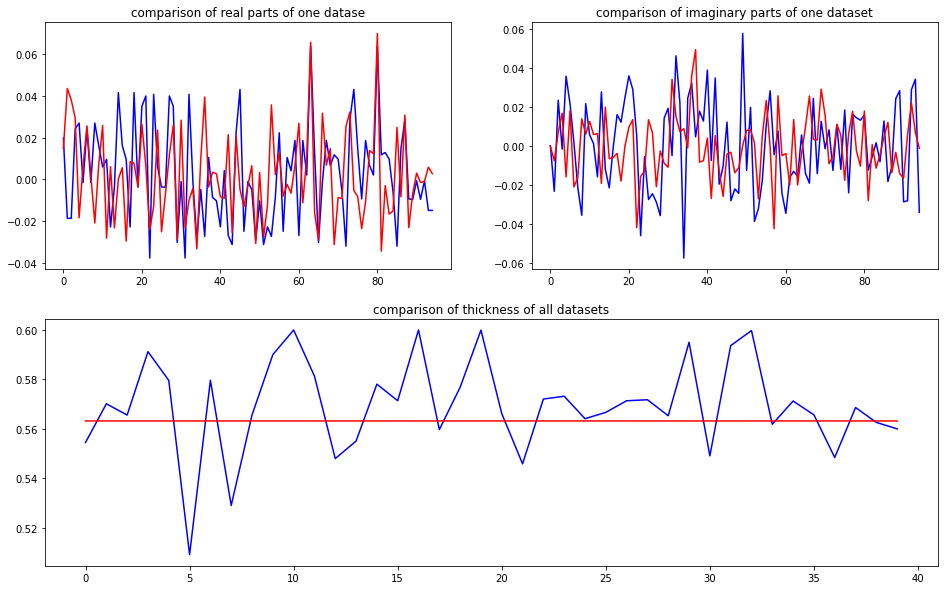

predicted thickness: 0.5630752


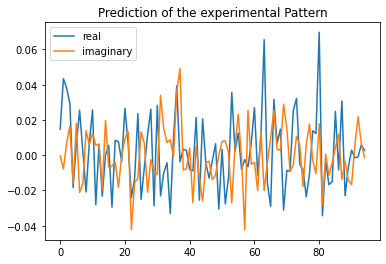

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=563.0751848220825
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01481722+0.j          0.0407877 -0.0072851j   0.0407877 +0.0072851j
  0.02751887+0.01886752j -0.01957064-0.01489679j  0.00404428+0.01712218j
  0.02751887-0.01886752j  0.00404428-0.017

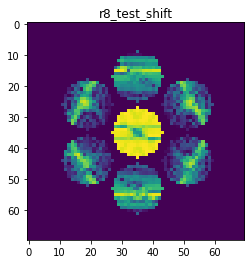

X_sim.max(): 0.9731165455761271
nlogf_X_sim.max(): 6.88153095313325
>>>replaced the 87. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 511ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 5.4603e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 300ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.0636e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 295ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 5.9285e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 289ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 4.8785e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 301ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 4.9334e-04 - val_acc: 1.0000


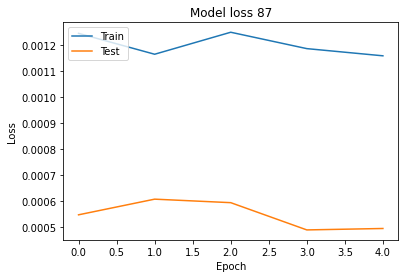

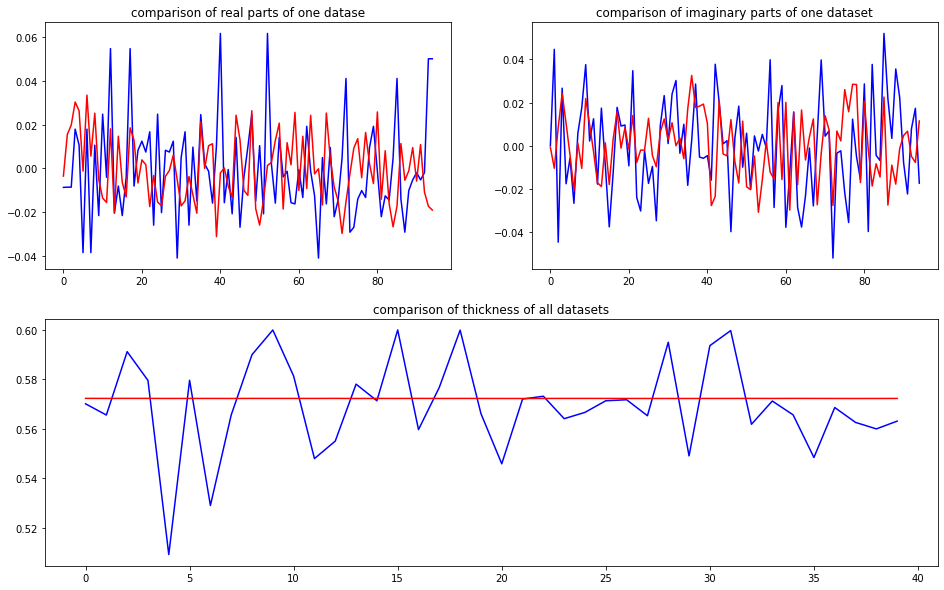

predicted thickness: 0.5721771


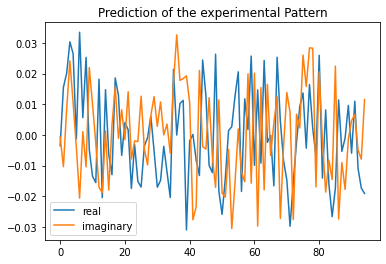

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=572.1771121025085
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00350953+0.j          0.01778518-0.00934287j  0.01778518+0.00934287j
  0.03190876+0.02238208j  0.02586868+0.01043294j  0.00216234-0.00260239j
  0.03190876-0.02238208j  0.00216234+0.00

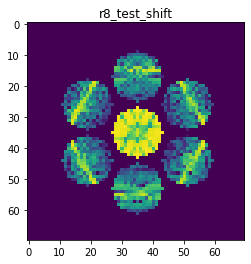

X_sim.max(): 0.9633615015867076
nlogf_X_sim.max(): 6.8714662259609645
>>>replaced the 88. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 445ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.2404e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 274ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.2403e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 299ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.2316e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 300ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.4188e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 298ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.0290e-04 - val_acc: 1.0000


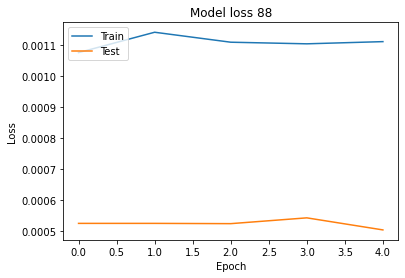

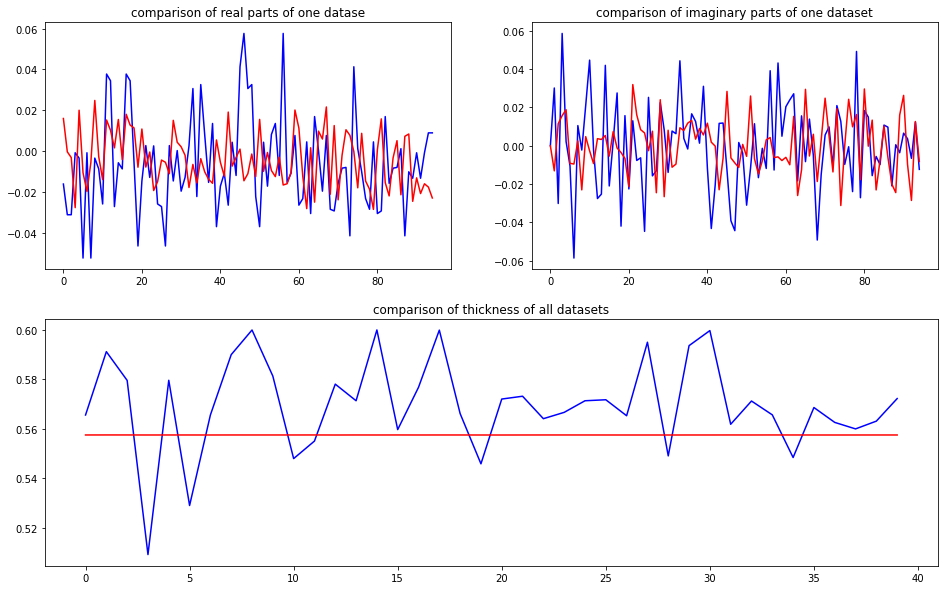

predicted thickness: 0.55743825


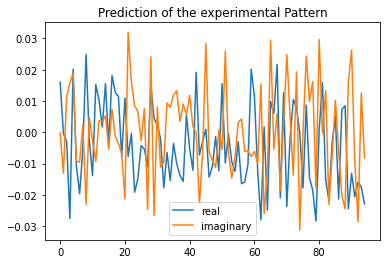

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=557.4382543563843
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01599741+0.j         -0.00163867-0.01223502j -0.00163867+0.01223502j
 -0.02358711+0.01263603j  0.02248514+0.02093078j -0.00802028-0.00581378j
 -0.02358711-0.01263603j -0.00802028+0.00

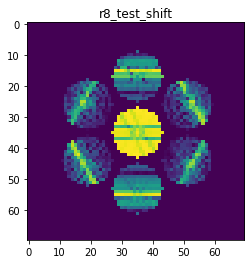

X_sim.max(): 0.978782150433009
nlogf_X_sim.max(): 6.8873302514767945
>>>replaced the 89. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 450ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.2632e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 298ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.4918e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 305ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.0873e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 283ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.2847e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 284ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.6061e-04 - val_acc: 1.0000


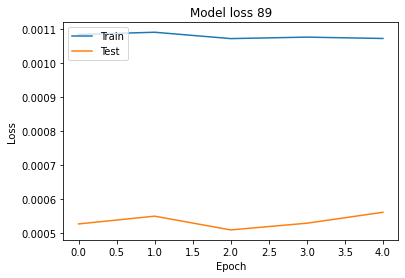

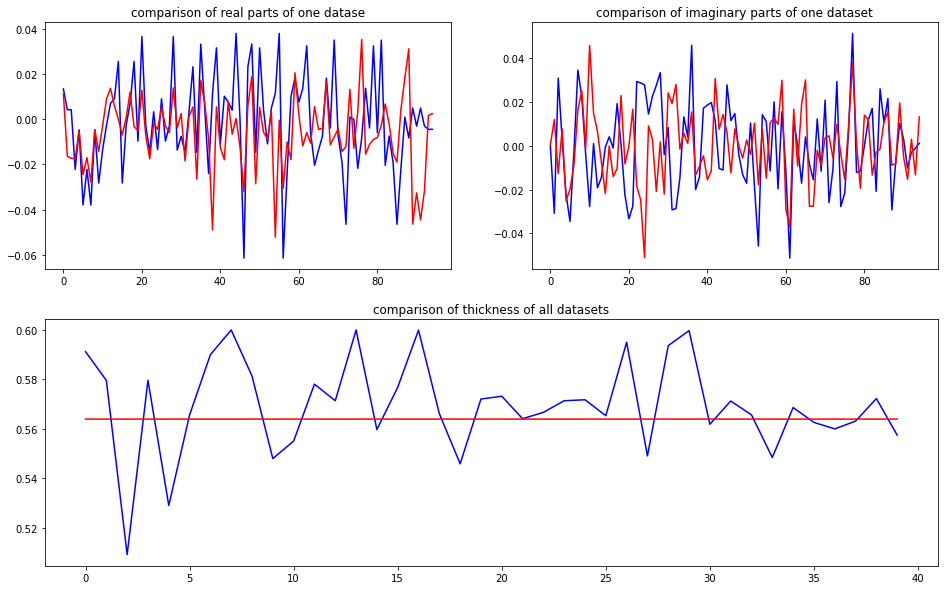

predicted thickness: 0.5638508


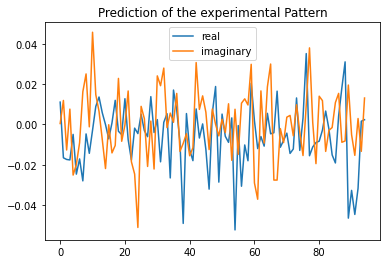

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=563.8508200645447
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01108591+0.j         -0.01692783+0.01227994j -0.01692783-0.01227994j
 -0.01732315+0.00832621j -0.00479181-0.025071j   -0.02628804-0.01801636j
 -0.01732315-0.00832621j -0.02628804+0.01

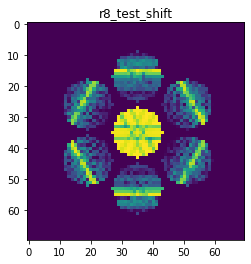

X_sim.max(): 0.9786673408990123
nlogf_X_sim.max(): 6.887213065976851
>>>replaced the 90. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 460ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 4.2387e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 294ms/step - loss: 9.8955e-04 - acc: 1.0000 - val_loss: 5.2979e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 288ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 5.8205e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 284ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.0817e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 296ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 5.5571e-04 - val_acc: 1.0000


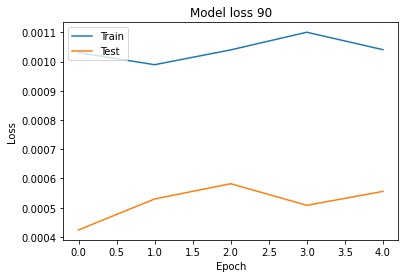

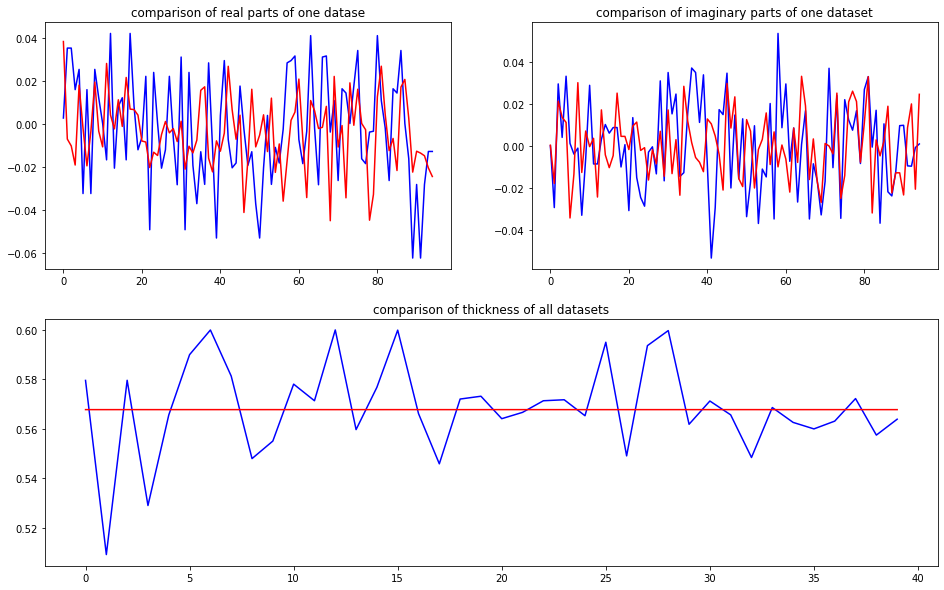

predicted thickness: 0.5676608


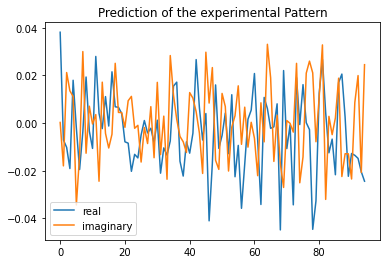

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=567.6608085632324
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03812125+0.j         -0.00865644-0.01959406j -0.00865644+0.01959406j
 -0.01930733+0.01351396j  0.01864055+0.01191502j -0.00288331-0.03220395j
 -0.01930733-0.01351396j -0.00288331+0.03

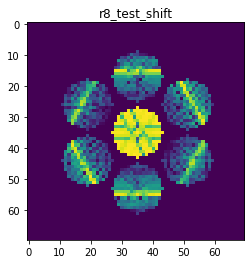

X_sim.max(): 0.965565625375268
nlogf_X_sim.max(): 6.873749196369427
>>>replaced the 91. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 440ms/step - loss: 9.8815e-04 - acc: 1.0000 - val_loss: 4.6529e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 255ms/step - loss: 9.5085e-04 - acc: 1.0000 - val_loss: 5.7055e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 251ms/step - loss: 9.7524e-04 - acc: 1.0000 - val_loss: 5.5015e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 254ms/step - loss: 9.4525e-04 - acc: 1.0000 - val_loss: 5.0254e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 255ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 5.1226e-04 - val_acc: 1.0000


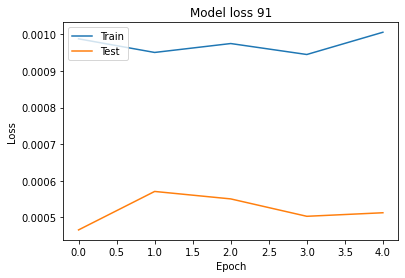

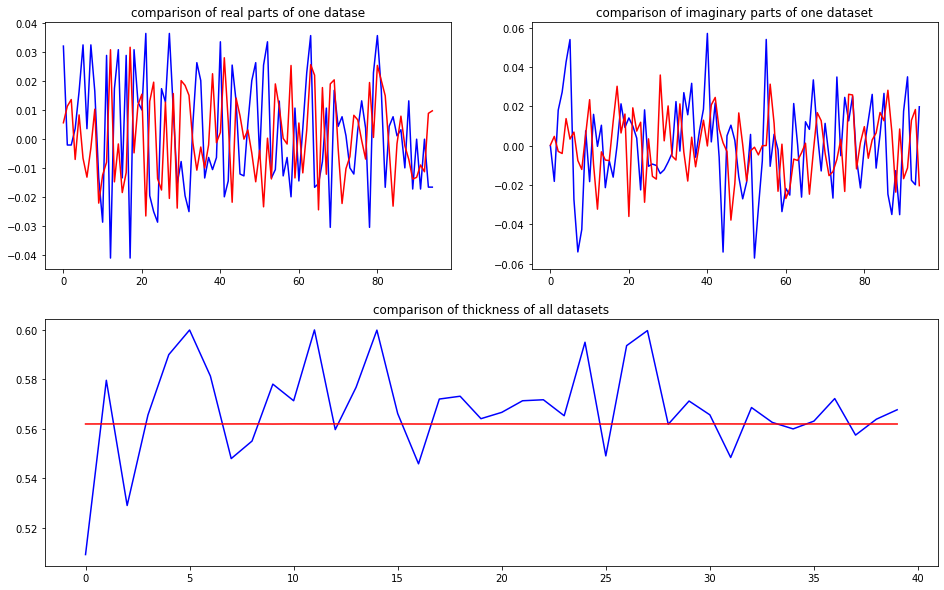

predicted thickness: 0.5618493


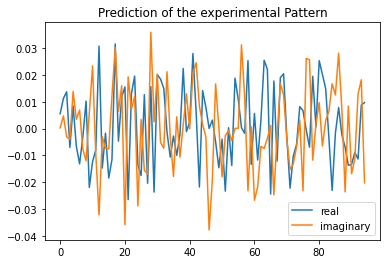

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=561.8492960929871
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00559067+0.j          0.01253813+0.00390518j  0.01253813-0.00390518j
 -0.01008321-0.00545552j  0.00938678+0.01294121j -0.0048758 +0.00556614j
 -0.01008321+0.00545552j -0.0048758 -0.00

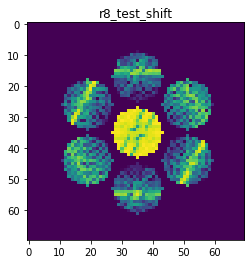

X_sim.max(): 0.9644337189279166
nlogf_X_sim.max(): 6.872577450032973
>>>replaced the 92. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 438ms/step - loss: 9.4647e-04 - acc: 1.0000 - val_loss: 4.7605e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 281ms/step - loss: 9.0114e-04 - acc: 1.0000 - val_loss: 4.7834e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 278ms/step - loss: 9.0482e-04 - acc: 1.0000 - val_loss: 4.4006e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 281ms/step - loss: 9.4170e-04 - acc: 1.0000 - val_loss: 5.4615e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 276ms/step - loss: 9.6368e-04 - acc: 1.0000 - val_loss: 6.1227e-04 - val_acc: 1.0000


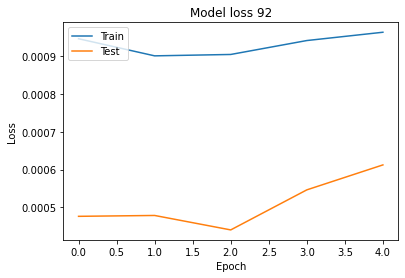

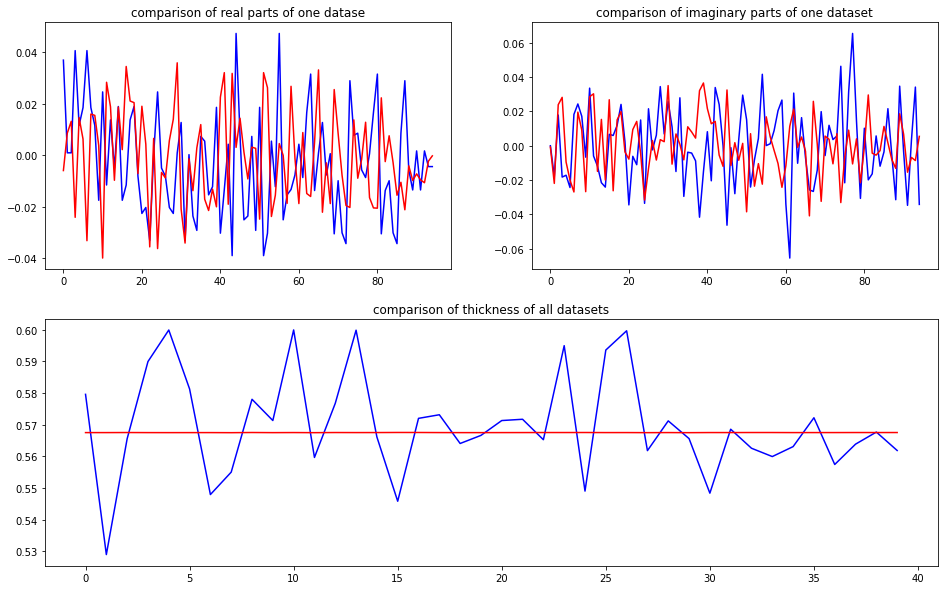

predicted thickness: 0.56741


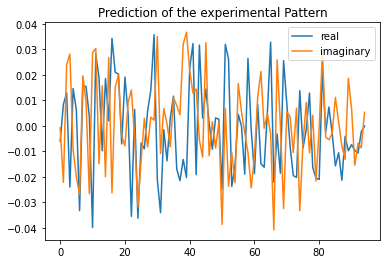

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=567.4099922180176
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00606769+0.00000000e+00j  0.01071908-2.30757659e-02j
  0.01071908+2.30757659e-02j -0.02860449+2.75934041e-02j
  0.0150304 -9.37518198e-03j  0.01104293-1.98403737e-02j
 -0.02860449-2.7

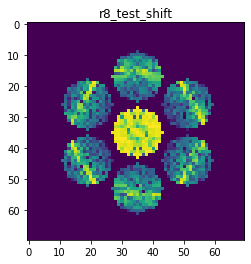

X_sim.max(): 0.952295604350213
nlogf_X_sim.max(): 6.859925038506224
>>>replaced the 93. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 497ms/step - loss: 9.0363e-04 - acc: 1.0000 - val_loss: 4.6012e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 305ms/step - loss: 8.7250e-04 - acc: 1.0000 - val_loss: 5.3338e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 296ms/step - loss: 9.0645e-04 - acc: 1.0000 - val_loss: 5.2553e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 298ms/step - loss: 9.1902e-04 - acc: 1.0000 - val_loss: 5.2937e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 299ms/step - loss: 9.1853e-04 - acc: 1.0000 - val_loss: 5.5202e-04 - val_acc: 1.0000


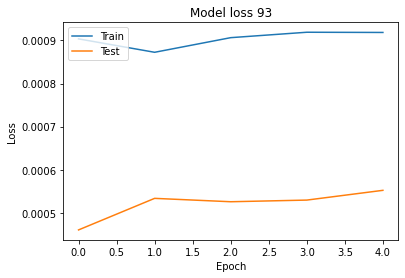

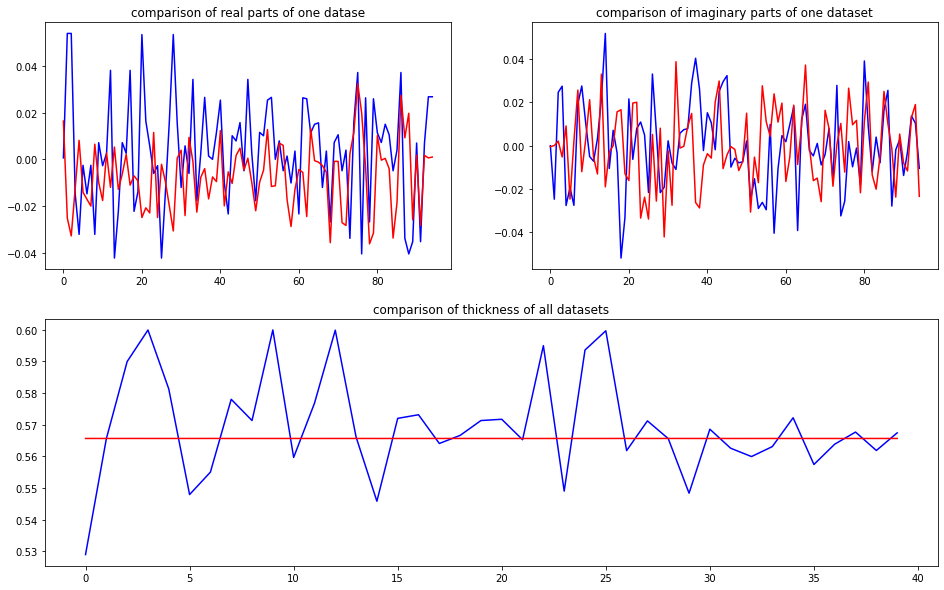

predicted thickness: 0.5656182


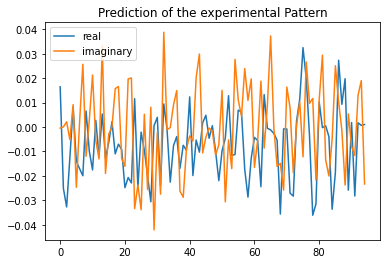

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.6182169914246
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 1.64533593e-02+0.j         -2.89414804e-02-0.00103854j
 -2.89414804e-02+0.00103854j -1.47791067e-02-0.00363465j
  7.37479446e-03+0.01057167j -1.70131060e-02-0.02517545j
 -1.47791067e-02

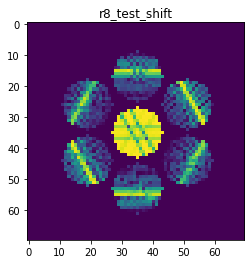

X_sim.max(): 0.9904155834631472
nlogf_X_sim.max(): 6.899133804106418
>>>replaced the 94. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 442ms/step - loss: 9.3712e-04 - acc: 1.0000 - val_loss: 4.6939e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 298ms/step - loss: 8.0814e-04 - acc: 1.0000 - val_loss: 4.7528e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 309ms/step - loss: 8.3004e-04 - acc: 1.0000 - val_loss: 4.2396e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 304ms/step - loss: 7.8933e-04 - acc: 1.0000 - val_loss: 4.7170e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 291ms/step - loss: 7.7459e-04 - acc: 1.0000 - val_loss: 4.5624e-04 - val_acc: 1.0000


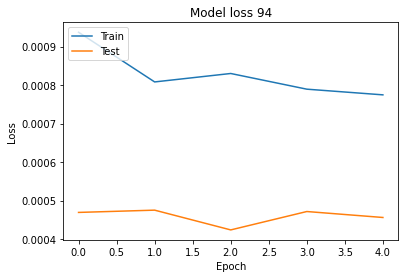

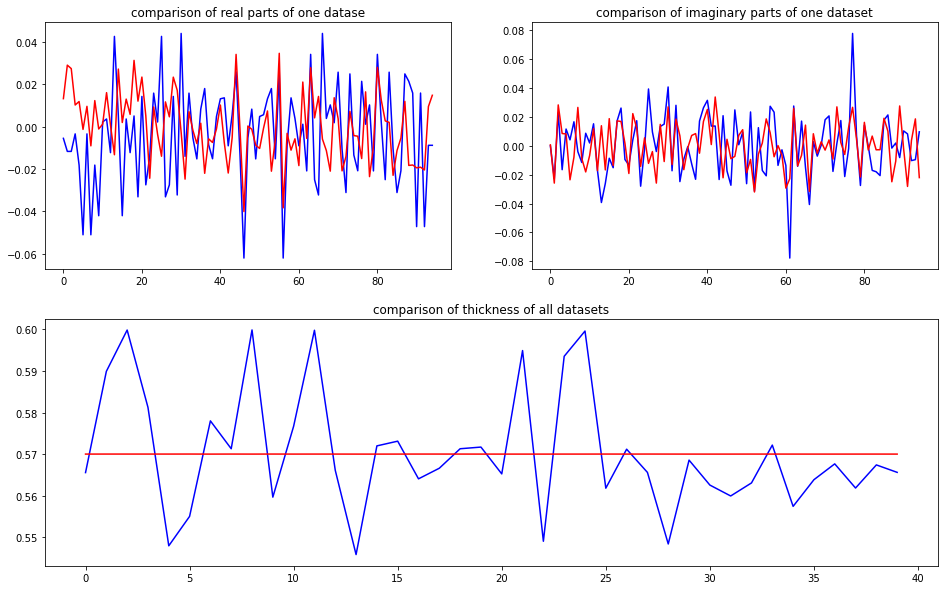

predicted thickness: 0.56999177


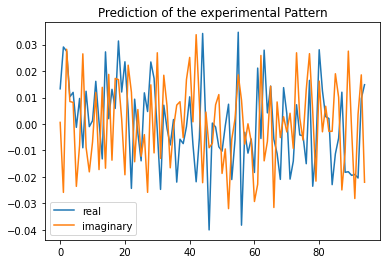

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=569.9917674064636
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01329732+0.j          0.02830562-0.0270602j   0.02830562+0.0270602j
  0.00996286+0.00825336j  0.01216171+0.00849053j -0.00514352-0.02505482j
  0.00996286-0.00825336j -0.00514352+0.025

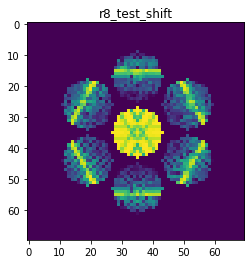

X_sim.max(): 0.9742550826025976
nlogf_X_sim.max(): 6.882699059962622
>>>replaced the 95. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 468ms/step - loss: 7.3351e-04 - acc: 1.0000 - val_loss: 4.7517e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 310ms/step - loss: 7.7059e-04 - acc: 1.0000 - val_loss: 4.4031e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 301ms/step - loss: 7.5111e-04 - acc: 1.0000 - val_loss: 4.7503e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 307ms/step - loss: 7.4260e-04 - acc: 1.0000 - val_loss: 4.6105e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 293ms/step - loss: 7.2416e-04 - acc: 1.0000 - val_loss: 4.2542e-04 - val_acc: 1.0000


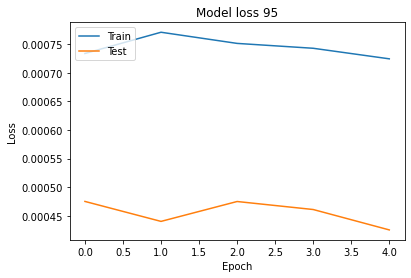

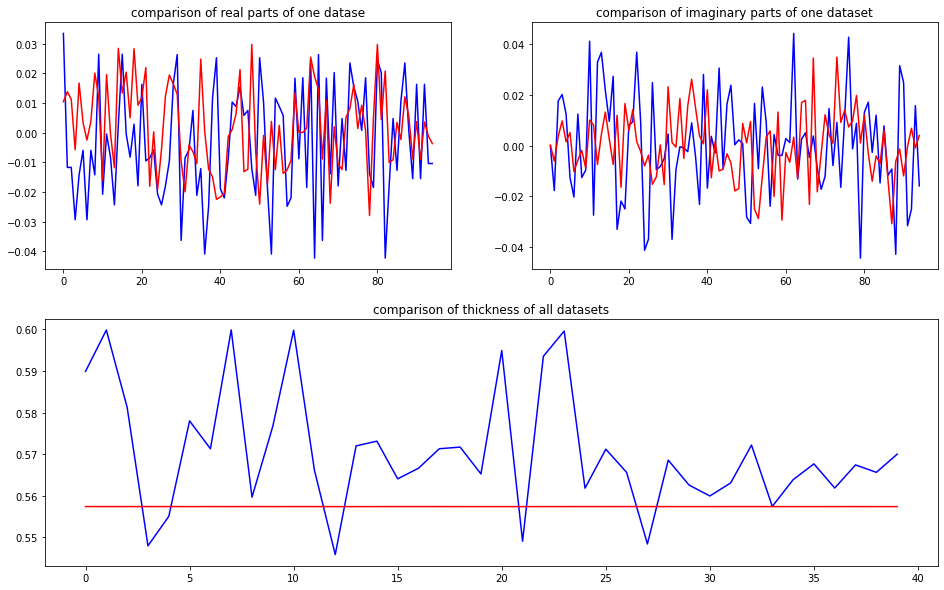

predicted thickness: 0.5573578


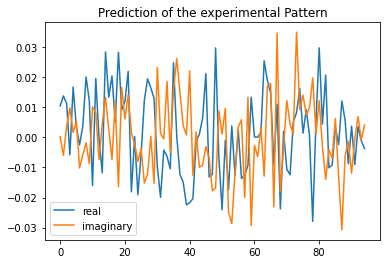

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=557.3577880859375
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 1.04319062e-02+0.00000000e+00j  1.24907796e-02-4.88511787e-03j
  1.24907796e-02+4.88511787e-03j -4.15792421e-03+9.98666277e-03j
  1.83667690e-02+1.72155199e-03j  3.60711664e-03+5.468179

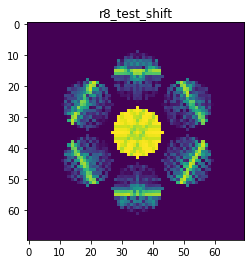

X_sim.max(): 0.987582480564648
nlogf_X_sim.max(): 6.896272079255836
>>>replaced the 96. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 457ms/step - loss: 6.5119e-04 - acc: 1.0000 - val_loss: 3.6940e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 277ms/step - loss: 6.5082e-04 - acc: 1.0000 - val_loss: 3.7358e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 287ms/step - loss: 6.6843e-04 - acc: 1.0000 - val_loss: 3.8289e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 283ms/step - loss: 6.5266e-04 - acc: 1.0000 - val_loss: 4.1066e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 278ms/step - loss: 6.8495e-04 - acc: 1.0000 - val_loss: 4.0449e-04 - val_acc: 1.0000


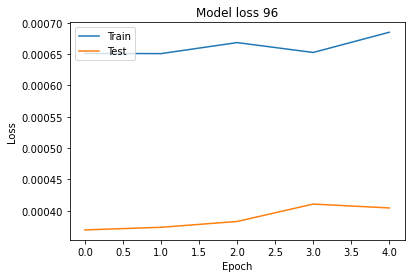

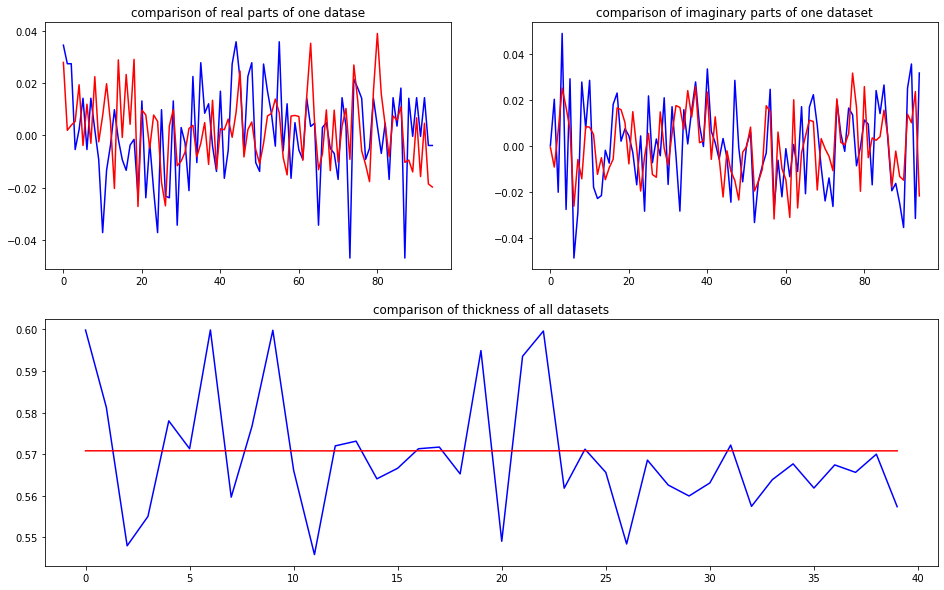

predicted thickness: 0.57076824


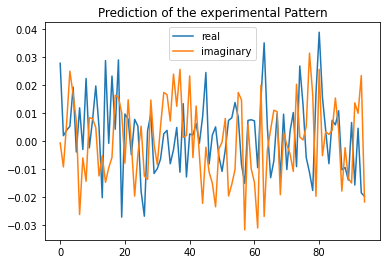

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=570.7682371139526
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02786875+0.j          0.00292086-0.00788244j  0.00292086+0.00788244j
  0.00860478+0.02565265j  0.02088876+0.01552516j -0.00344337+0.00650257j
  0.00860478-0.02565265j -0.00344337-0.00

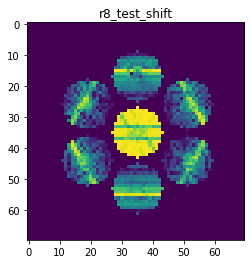

X_sim.max(): 0.976561654783185
nlogf_X_sim.max(): 6.885061363817435
>>>replaced the 97. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 462ms/step - loss: 6.2169e-04 - acc: 1.0000 - val_loss: 3.7332e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 286ms/step - loss: 6.0792e-04 - acc: 1.0000 - val_loss: 4.1850e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 288ms/step - loss: 6.2537e-04 - acc: 1.0000 - val_loss: 4.5428e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 279ms/step - loss: 6.3058e-04 - acc: 1.0000 - val_loss: 4.2512e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 293ms/step - loss: 6.0667e-04 - acc: 1.0000 - val_loss: 3.8543e-04 - val_acc: 1.0000


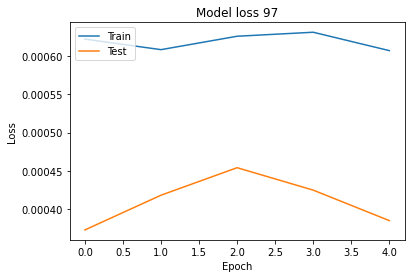

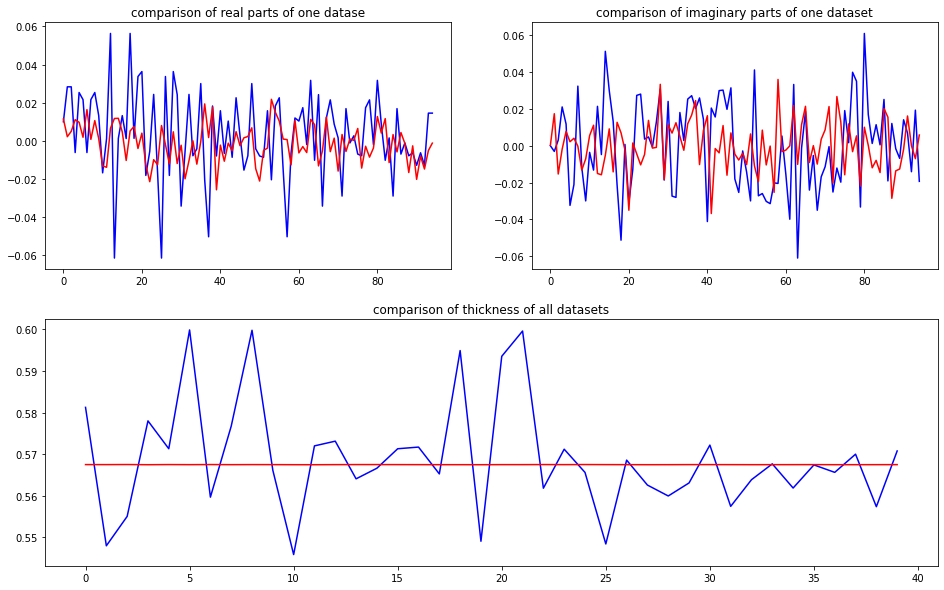

predicted thickness: 0.56743956


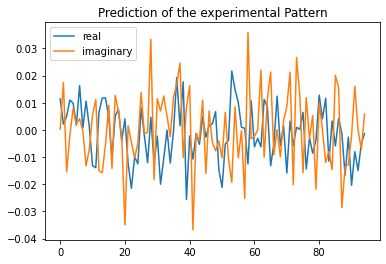

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=567.4395561218262
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01144278+0.j          0.00360812+0.0164625j   0.00360812-0.0164625j
  0.01368254-0.00297374j  0.01020643+0.0105116j   0.00125249+0.00127788j
  0.01368254+0.00297374j  0.00125249-0.001

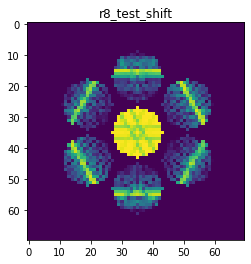

X_sim.max(): 0.9840287680207216
nlogf_X_sim.max(): 6.892670846858007
>>>replaced the 98. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 453ms/step - loss: 5.5088e-04 - acc: 1.0000 - val_loss: 4.1133e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 300ms/step - loss: 5.8299e-04 - acc: 1.0000 - val_loss: 3.8084e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 305ms/step - loss: 5.6726e-04 - acc: 1.0000 - val_loss: 4.0377e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 2s 321ms/step - loss: 6.0034e-04 - acc: 1.0000 - val_loss: 3.8523e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 314ms/step - loss: 5.5336e-04 - acc: 1.0000 - val_loss: 4.4752e-04 - val_acc: 1.0000


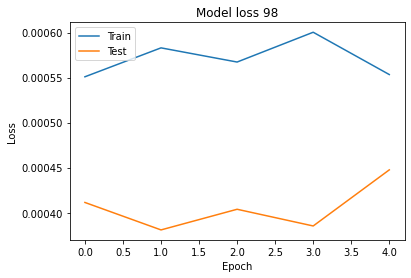

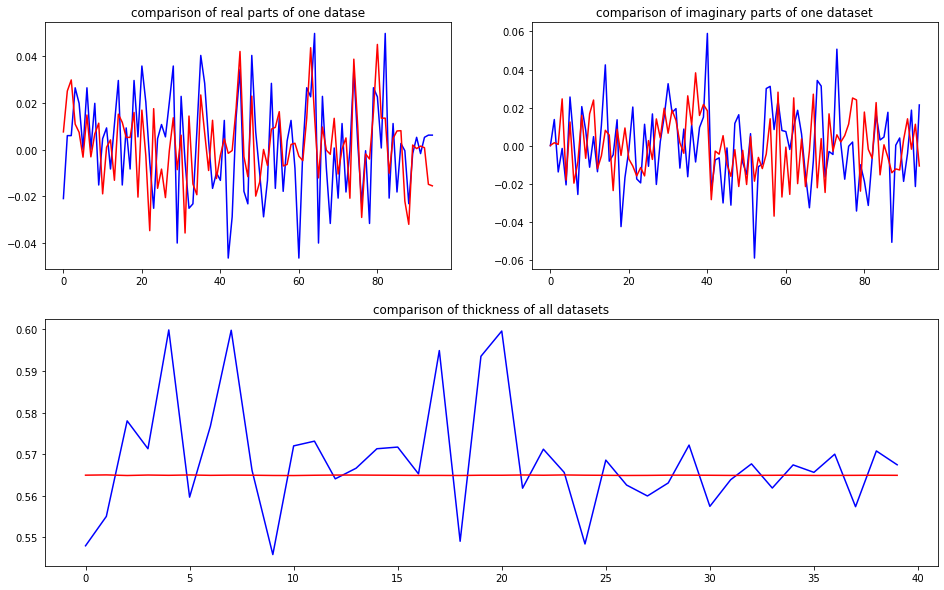

predicted thickness: 0.5648448


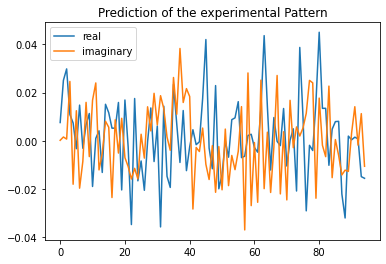

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=564.8447871208191
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00755919+0.j          0.02741971+0.00043333j  0.02741971-0.00043333j
  0.01282293+0.02211551j  0.00704124-0.01696772j -0.00319585+0.01049731j
  0.01282293-0.02211551j -0.00319585-0.01

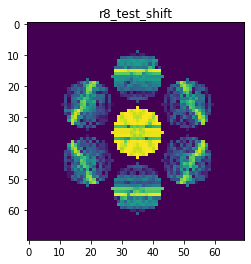

X_sim.max(): 0.9809416884047494
nlogf_X_sim.max(): 6.889531926148149
>>>replaced the 99. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 515ms/step - loss: 5.4993e-04 - acc: 1.0000 - val_loss: 3.4395e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 291ms/step - loss: 4.9985e-04 - acc: 1.0000 - val_loss: 4.4910e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 301ms/step - loss: 5.3546e-04 - acc: 1.0000 - val_loss: 3.9229e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 308ms/step - loss: 5.3135e-04 - acc: 1.0000 - val_loss: 3.9276e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 293ms/step - loss: 5.0988e-04 - acc: 1.0000 - val_loss: 3.7018e-04 - val_acc: 1.0000


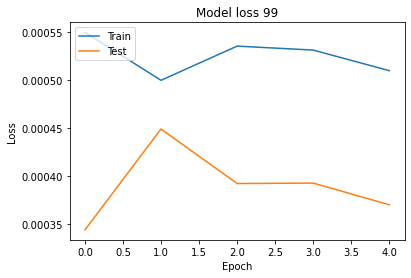

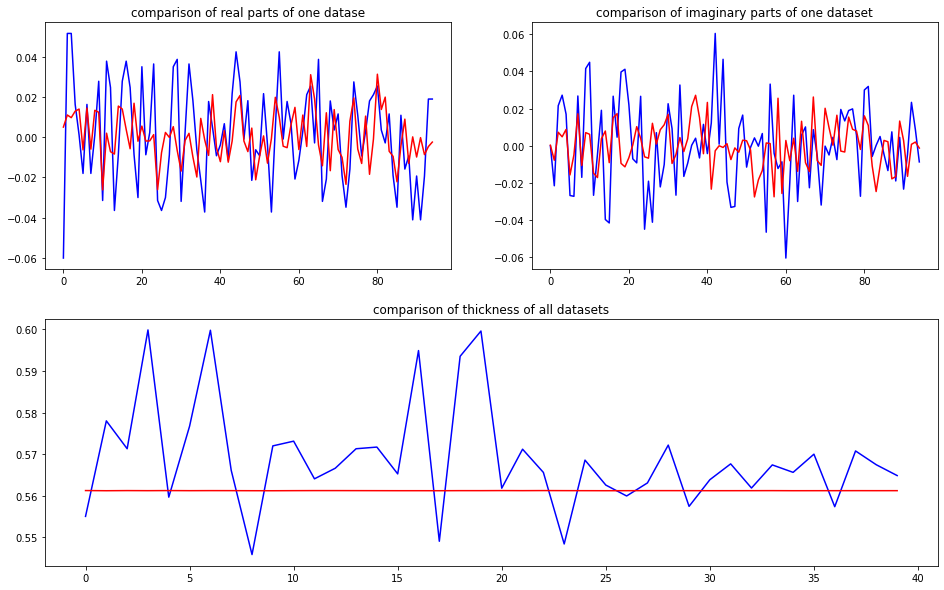

predicted thickness: 0.5611826


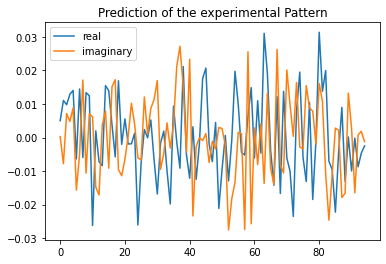

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=561.1826181411743
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 5.02733467e-03+0.j          1.04184570e-02-0.00747543j
  1.04184570e-02+0.00747543j  1.36859668e-02+0.00486733j
  1.37167070e-02+0.00970642j -6.16101571e-03-0.01640297j
  1.36859668e-02

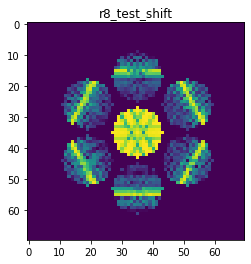

X_sim.max(): 0.9832976948679781
nlogf_X_sim.max(): 6.891928386732574
>>>replaced the 100. dataset and train: 
Epoch 1/5
5/5 [==============================] - 3s 461ms/step - loss: 4.6704e-04 - acc: 1.0000 - val_loss: 3.7154e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 1s 293ms/step - loss: 4.7528e-04 - acc: 1.0000 - val_loss: 3.8806e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 1s 291ms/step - loss: 4.7608e-04 - acc: 1.0000 - val_loss: 3.8338e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 1s 296ms/step - loss: 4.6348e-04 - acc: 1.0000 - val_loss: 4.0270e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 1s 296ms/step - loss: 4.6238e-04 - acc: 1.0000 - val_loss: 3.4645e-04 - val_acc: 1.0000


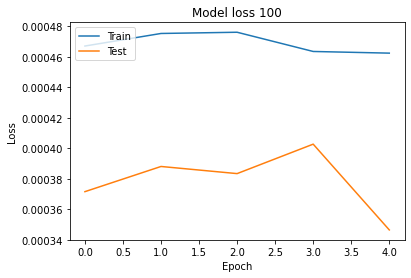

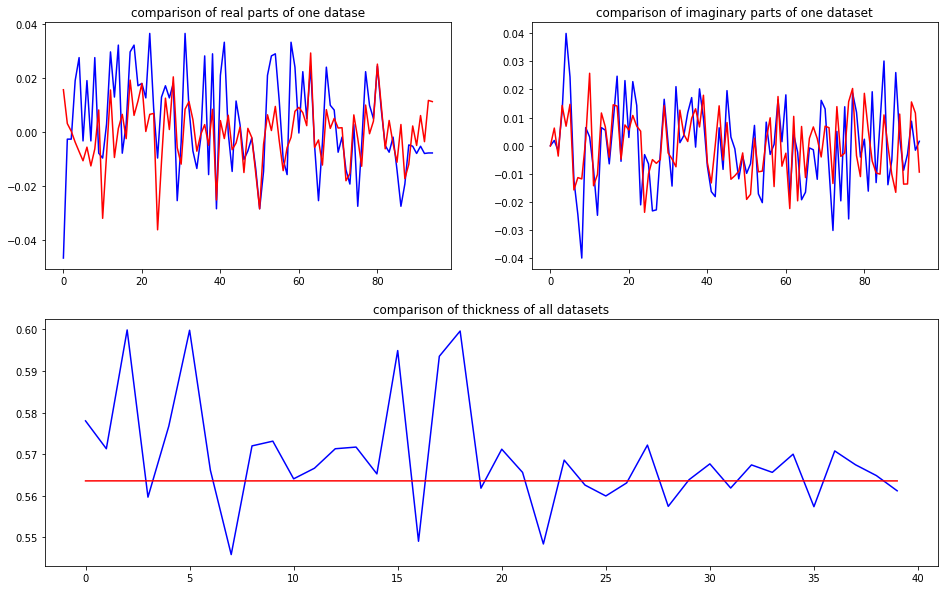

predicted thickness: 0.56354785


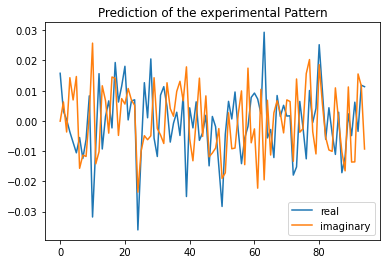

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=563.5478496551514
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01575707+0.j          0.00180938+0.00497102j  0.00180938-0.00497102j
 -0.0045941 +0.01499755j -0.00664489+0.00935481j -0.01150226+0.0130087j
 -0.0045941 -0.01499755j -0.01150226-0.013

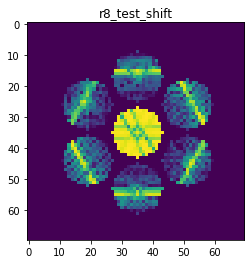

X_sim.max(): 0.9841910945674577
nlogf_X_sim.max(): 6.892835626992635
Time:  1308.892866583


In [21]:
Ug_t_exp_pred_matrix = [] #matrix to save the predicted {Ug,t} of the experimental pattern
Ug_exp_pred_matrix = [] #matrix to save the predicted Ug of the experimental pattern
t_exp_pred_matrix = [] #matrix to save the predicted t of the experimental pattern
simulation_pattern = [] #matrix to save the simulation pattern produced by predicted {Ug,t}
scale = 0.1 # scale of random offset 

DoDiverse = False

start = timeit.default_timer()
for i in range(0,trainsize+1):
    
    if i == 0:
        print('>>>train the initial training set:')
        Epochs = 10
        
    else:
        print('>>>replaced the {0:d}. dataset and train: '.format(i))
        Epochs = 5
    
    # load and compile the model
    model = load_model(name+'.h5')
    

    # invert the 1 channel image Array to 3 Channel, to use ResNet50
    X_train_3C = np.concatenate((X_train,X_train,X_train),axis=3) #same value for every channel
    X_test_3C = np.concatenate((X_test,X_test,X_test),axis=3)
    

    # train the model
    model.fit(X_train_3C, Y_train, validation_data=(X_test_3C, Y_test), batch_size=20, epochs=Epochs)
        
    # save the trained weigths of the model, delete the existing model
    model.save(name+'.h5')


    # plot the model loss
    plt.plot(model.history.history['loss'])
    plt.plot(model.history.history['val_loss'])
    plt.title('Model loss {0:d}'.format(i))
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Model_Loss' + '/' + 'Model_Loss{0:d}.png'.format(i))
    plt.show()
    plt.close()
    

    # Prediction of the testing set
    Y_test_pred = model.predict(X_test_3C)    
    Ug_test_pred_complex = Y_test_pred[:,:2*numUg].reshape(-1,numUg,2)
    Ug_test_complex = Y_test[:,:2*numUg].reshape(-1,numUg,2)    
    t_test_pred = Y_test_pred[:,2*numUg]
    t_test = Y_test[:,2*numUg]
    
    # plot the comparison of imaginary parts, real parts and thickness
    gs = gridspec.GridSpec(2, 2)
    fig = plt.figure(figsize=(16,10))
    
    ax1 = fig.add_subplot(gs[0, 0]) 
    ax1.plot(Ug_test_complex[2,:,0],'b')
    ax1.plot(Ug_test_pred_complex[2,:,0],'r')
    ax1.set_title('comparison of real parts of one datase')
    
    ax2 = fig.add_subplot(gs[0, 1]) 
    ax2.plot(Ug_test_complex[2,:,1],'b')
    ax2.plot(Ug_test_pred_complex[2,:,1],'r')
    ax2.set_title('comparison of imaginary parts of one dataset')
    
    ax3 = fig.add_subplot(gs[1, :])
    ax3.plot(t_test[:],'b')
    ax3.plot(t_test_pred[:],'r')
    ax3.set_title('comparison of thickness of all datasets')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Comparison' + '/' + 'My_Comparison{0:d}.png'.format(i))
    plt.show()
    plt.close()
    
    
    # Prediction of the experimental Pattern
    X_exp_3C = np.concatenate((nlogf_X_exp,nlogf_X_exp,nlogf_X_exp),axis=3) #X_exp.shape=(1,70,70,1); X_exp_3C.shape=(1,70,70,3)
    Y_exp_pred = model.predict(X_exp_3C) #Y_exp_pred = (1,191)
    
    Ug_t_exp_pred = Y_exp_pred[0,:] #Ug_t_exp_pred.shape=(191,)
    Ug_exp_pred = Ug_t_exp_pred[0:2*numUg] #Ug_exp_pred.shape=(190,)
    t_exp_pred = Ug_t_exp_pred[-1] 
    
    Ug_t_exp_pred_matrix.append(Ug_t_exp_pred)
    Ug_exp_pred_matrix.append(Ug_exp_pred)
    t_exp_pred_matrix.append(t_exp_pred)
    #np.savetxt("/Users/chenjie/pyQEDA/training_Data/My_Model_ZnO/My_Prediction/predicted_Ug_t_{0:d}.csv".format(i), Y_exp_pred)
    
    if t_exp_pred < 0:
        t_exp_pred = np.random.randint(200,1001)/1000
        print("negative thickness, use random thickness: ", t_exp_pred)
        t_exp_pred = np.random.randint(200,1001)/1000
        Ug_t_exp_pred[-1] = t_exp_pred
    else:
        print("predicted thickness:", t_exp_pred)
 
    
    # plot the results
    plt.plot(Ug_exp_pred[0:2*numUg:2],label='real')
    plt.plot(Ug_exp_pred[1:2*numUg:2],label='imaginary')
    plt.legend()
    plt.title('Prediction of the experimental Pattern')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Prediction' + '/' + 'Ug{0:d}.png'.format(i))
    plt.show()
    plt.close()
    
    # diverse the predicted Ug and thickness
    if DoDiverse == True:
        # scale will be reduced by iterations
        scale *= 0.99
        offset_Ug = (np.random.random()*2-1)*scale
        for j in range(len(Ug_t_exp_pred)-1):
            # for real part of Ug
            if j%2 == 0:
                # the offset if propotional to the magnitude of the Ug
                Ug_t_exp_pred[j] += offset_Ug*(Ug_t_exp_pred[j]**2 + Ug_t_exp_pred[j+1]**2)
            # for imag part of Ug
            else:
                Ug_t_exp_pred[j] += offset_Ug*(Ug_t_exp_pred[j-1]**2 + Ug_t_exp_pred[j]**2)
    
    # normalization
    Ug_pred = np.array(range( np.int((Ug_t_exp_pred.size - 1)/2) ), dtype=complex)
    Ug_pred.real = Ug_t_exp_pred[0:-1:2]
    Ug_pred.imag = Ug_t_exp_pred[1:-1:2]
    Ug_pred_normalized = nf.normalization(file=File, origin_Ug=Ug_pred)
    Ug_pred_normalized = np.asarray(Ug_pred_normalized)

    # reshape
    Ug_pred_normalized_2real = np.concatenate((np.array(Ug_pred_normalized.real,ndmin=2).T, np.array(Ug_pred_normalized.imag,ndmin=2).T),axis=1)  
    Ug_pred_normalized_2real = np.asarray(Ug_pred_normalized_2real)
    Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(numUg*2), Ug_t_exp_pred[-1])
    
    
    # Compute the LARBED pattern: X_sim, from the predicted {Ug,t}: Y_exp_pred
    file = File+".qed"
    X_sim = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_pred_normalized_2real, InputUgdoFlip=False)
    X_sim = X_sim.reshape(Nx,Nx,1)
    nlogf_X_sim = nlogf(X_sim)
    
    simulation_pattern.append(X_sim)
    print("X_sim.max():",X_sim.max())
    print("nlogf_X_sim.max():",nlogf_X_sim.max())
        
    
    # replace the training set & testing set with new training set
    if i < trainsize:
        #X_train[i] = nlogf_X_sim               
        X_train[i] = X_sim               
        Y_train[i] = Ug_t_pred_normalized_2real

        if i < testsize: 
            X_test = X_train[:testsize]
            Y_test = Y_train[:testsize]
        else:
            X_test = X_train[i+1-testsize:i+1]
            Y_test = Y_train[i+1-testsize:i+1]

stop = timeit.default_timer()
print('Time: ', stop - start)

-------------------------------------------------------------------------------------------------------------------

# IV. Compare the Prediction with the true value

1. diffraction pattern:

In [22]:
simulation_pattern = np.asarray(simulation_pattern)
print('the shape of the simulated pattern', simulation_pattern.shape)
print('the shape of the experimental pattern', X_exp.shape)

the shape of the simulated pattern (101, 70, 70, 1)
the shape of the experimental pattern (1, 70, 70, 1)


Text(0.5, 1.0, 'experimental Pattern')

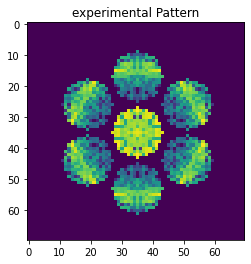

In [23]:
# plot the experimental Pattern:
plt.imshow(nlogf_X_exp[0])
plt.title('experimental Pattern')

Text(0.5, 1.0, 'simulation pattern')

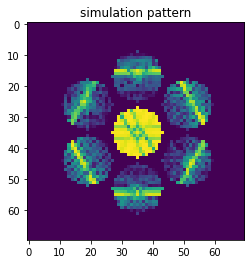

In [24]:
# plot the final simulated Pattern:
plt.imshow(nlogf(simulation_pattern[-1]))
plt.title("simulation pattern")

2. thickness:

Text(0.5, 0, 'iteration')

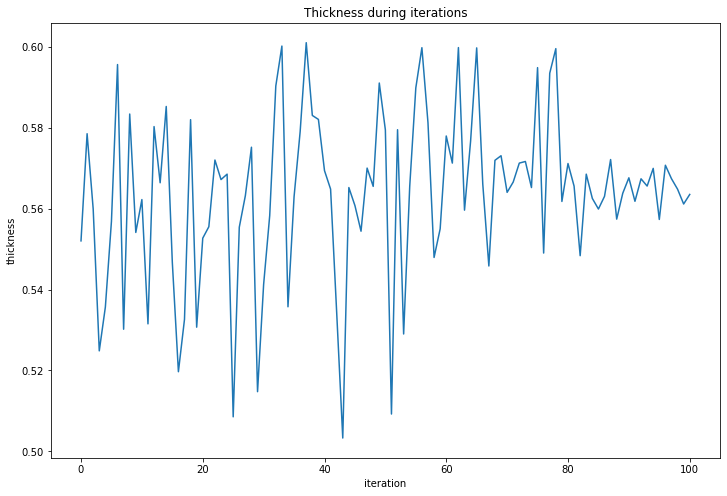

In [25]:
# plot the prediction of thickness during iterations:
plt.figure(figsize=(12,8))
plt.plot(t_exp_pred_matrix)
plt.title("Thickness during iterations")
plt.ylabel("thickness")
plt.xlabel("iteration")

3. R-factors:

Text(0.5, 0, 'Iteration')

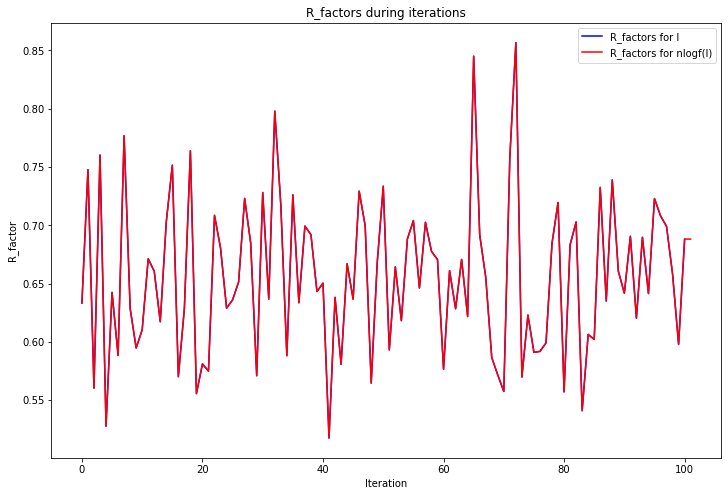

In [26]:
# plot the R-factors during iterations
exp_Intensity = X_exp.reshape(-1)
exp_Intensity_nlogf = nlogf_X_exp.reshape(-1)
sim_Intensities = []
sim_Intensities_nlogf = []
R_factors = []
R_factors_nlogf = []
for i in range(len(simulation_pattern)):
    sim_Intensity = simulation_pattern[i].reshape(-1)
    sim_Intensity_nlogf = nlogf(simulation_pattern[i]).reshape(-1)
    R = np.sum(np.abs(sim_Intensity - exp_Intensity))/np.sum(exp_Intensity)
    R_nlogf = np.sum(np.abs(sim_Intensity_nlogf - exp_Intensity_nlogf))/np.sum(exp_Intensity_nlogf)
    R_factors = np.append(R_factors, R)
    R_factors_nlogf = np.append(R_factors, R)

plt.figure(figsize=(12,8))
plt.plot(R_factors[:],"b",label="R_factors for I")
plt.plot(R_factors_nlogf[:], "r", label="R_factors for nlogf(I)")
plt.legend()
plt.title('R_factors during iterations')
plt.ylabel('R_factor')
plt.xlabel('Iteration')

R_min: 0.5175553854421778


Text(0.5, 1.0, 'simulation pattern')

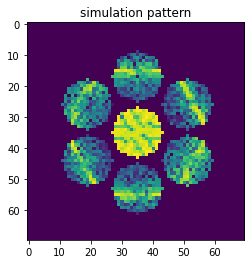

In [27]:
R_argmin = R_factors.argmin()
R_min = R_factors.min()
print("R_min:", R_min)
plt.imshow(nlogf(simulation_pattern[R_argmin].reshape(Nx,Nx,1)))
plt.title("simulation pattern")

In [28]:
t_exp_pred_matrix[R_argmin]

0.5648621